<a href="https://colab.research.google.com/github/peeyushsinghal/da/blob/main/mitigating_bias_sa_da_v30.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mitigating bias in sentiment analysis using domain adaptation

In [ ]:
! pip install torchtext==0.10.0 --quiet # DOWNGRADE YOUR TORCHTEXT
! pip install ekphrasis --quiet # library to pre process twitter data
! pip install emoji --upgrade --quiet #library to deal with emoji data

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 84.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 831.4/831.4 MB 2.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.14.0+cu116 requires torch==1.13.0, but you have torch 1.9.0 which is incompatible.
torchaudio 0.13.0+cu116 requires torch==1.13.0, but you have torch 1.9.0 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.8/83.8 KB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 KB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.8/52.8 KB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.9/240.9 KB 18.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
## Import statements
import pandas as pd
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchtext.legacy.data import Dataset, Field, TabularDataset, BucketIterator
from torchtext.vocab import GloVe
import torchtext.vocab as vocab
import numpy as np
from ekphrasis.classes.preprocessor import TextPreProcessor
from ekphrasis.classes.tokenizer import SocialTokenizer
from ekphrasis.dicts.emoticons import emoticons
import emoji
from torchtext.legacy.vocab import Vectors
from tqdm import tqdm
import random
import torch.optim as optim
import scipy.stats as stats
from statistics import mean

import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
en_stops = set(stopwords.words('english'))

import time

from copy import deepcopy

import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable


import matplotlib.pyplot as plt
# import EarlyStopping
# from pytorchtools import EarlyStopping

from torch.optim.lr_scheduler import StepLR, ReduceLROnPlateau


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
# checking device
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Running on:{}".format(DEVICE))

Running on:cuda


## Data loading

In [ ]:
#Mounting google drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## Data Configuration

In [ ]:

BASE_PATH = '/content/drive/MyDrive/semeval-2018'

DATA_DIR = os.path.join(BASE_PATH,'datasets')
TARGET_DIR = os.path.join(BASE_PATH,'targetdataset')

MODEL_DIR = os.path.join(BASE_PATH,'models')
REF_DIR = os.path.join(BASE_PATH,'reference')
EMBEDDINGS_DIR = os.path.join(BASE_PATH,'embeddings')

MAX_SIZE = 50
MAX_VOCAB_SIZE = 10000
BATCH_SIZE = 8

EMBEDDING_TO_BE_USED = 'glove_gn' # {'glove', 'glove_gn'}
TARGET_BATCH_SIZE = 8

NUM_EPOCHS = 100
# NUM_EPOCHS = 30
# NUM_EPOCHS = 60
INITIAL_LR = 0.001
INITIAL_LR_EWC = INITIAL_LR / NUM_EPOCHS
LR_GAMMA = 0.9
LR = 2e-4

PATIENCE = 10
EWC_LAMBDA = 0.4

if not os.path.exists(MODEL_DIR):
  os.makedirs(MODEL_DIR)
  print("The new directory is created!")


BONFERRONI_CORRECTION = 5.0

In [ ]:
# data configuration

class TASK1(object):
  
    EI_reg = {
        'anger': {
            'train': os.path.join(
                DATA_DIR, 'task1/EI-reg/training/EI-reg-En-anger-train.txt'),
            'dev': os.path.join(
                DATA_DIR, 'task1/EI-reg/development/2018-EI-reg-En-anger-dev.txt'),
            'gold': os.path.join(
                DATA_DIR, 'task1/EI-reg/test-gold/2018-EI-reg-En-anger-test-gold.txt')
                },
        'joy': {
                'train': os.path.join(
                    DATA_DIR, 'task1/EI-reg/training/EI-reg-En-joy-train.txt'),
                'dev': os.path.join(
                    DATA_DIR, 'task1/EI-reg/development/2018-EI-reg-En-joy-dev.txt'),
                'gold': os.path.join(
                    DATA_DIR, 'task1/EI-reg/test-gold/2018-EI-reg-En-joy-test-gold.txt')
                },
        'fear': {
            'train': os.path.join(
                DATA_DIR, 'task1/EI-reg/training/EI-reg-En-fear-train.txt'),
            'dev': os.path.join(
                DATA_DIR, 'task1/EI-reg/development/2018-EI-reg-En-fear-dev.txt'),
            'gold': os.path.join(
                DATA_DIR, 'task1/EI-reg/test-gold/2018-EI-reg-En-fear-test-gold.txt')
                },
        'sadness': {
            'train': os.path.join(
                DATA_DIR, 'task1/EI-reg/training/EI-reg-En-sadness-train.txt'),
            'dev': os.path.join(
                DATA_DIR, 'task1/EI-reg/development/2018-EI-reg-En-sadness-dev.txt'),
            'gold': os.path.join(
                DATA_DIR, 'task1/EI-reg/test-gold/2018-EI-reg-En-sadness-test-gold.txt')
                }                     
        }

    V_reg = {
        'train': os.path.join(
            DATA_DIR, 'task1/V-reg/2018-Valence-reg-En-train.txt'),
        'dev': os.path.join(
            DATA_DIR, 'task1/V-reg/2018-Valence-reg-En-dev.txt'),
        'gold': os.path.join(
            DATA_DIR, 'task1/V-reg/2018-Valence-reg-En-test-gold.txt')
             }

    EEC = {
        'eec': os.path.join(
            DATA_DIR, 'task1/Equity-Evaluation-Corpus/Equity-Evaluation-Corpus.csv')
             }

## Source Data
Parsing Emotion and Valence regression data : `format [ID	Tweet	Affect Dimension	Intensity Score]`

In [ ]:
def parse_reg(data_file, label_format='tuple'):
    """
    This is for datasets for the EI-reg and V-reg English tasks 
    Returns:
        df: dataframe with columns in the first row of file [ID-Tweet-Affect Dimension-Intensity Score]
    """
    with open(data_file, 'r') as fd:
      data = [l.strip().split('\t') for l in fd.readlines()]
    # print(data)
    df = pd.DataFrame (data[1:],columns=data[0])
    csv_file_name = (data_file.split("/")[-1]).split('.')[0]+".csv"
    csv_file = df.to_csv(str(csv_file_name))
    return csv_file_name


Generic Source Data Parser

In [ ]:
def parse_csv(task, dataset, emotion='anger'):
    if task == 'EI-reg':
        data_train = TASK1.EI_reg[emotion][dataset]
        csv_file_name = parse_reg(data_train)
        return csv_file_name

    elif task == 'V-reg':
        data_train = TASK1.V_reg[dataset]

        csv_file_name = parse_reg(data_train)
        return csv_file_name

    else:
        return None

In [ ]:
emotions = ['anger','joy','fear','sadness']
dict_data ={'train':'train','dev':'val','gold':'test'}
dict_file_name ={}
for emotion in emotions:
  for data_info, data_usage in dict_data.items():
    file_name = str('file_EI_'+ emotion + "_" + data_usage)
    dict_file_name[file_name] = parse_csv('EI-reg', data_info, emotion)

    file_name2 = str('file_V_'+ data_usage)
    dict_file_name[file_name2] = parse_csv('V-reg', data_info)

(dict_file_name)

{'file_EI_anger_train': 'EI-reg-En-anger-train.csv',
 'file_V_train': '2018-Valence-reg-En-train.csv',
 'file_EI_anger_val': '2018-EI-reg-En-anger-dev.csv',
 'file_V_val': '2018-Valence-reg-En-dev.csv',
 'file_EI_anger_test': '2018-EI-reg-En-anger-test-gold.csv',
 'file_V_test': '2018-Valence-reg-En-test-gold.csv',
 'file_EI_joy_train': 'EI-reg-En-joy-train.csv',
 'file_EI_joy_val': '2018-EI-reg-En-joy-dev.csv',
 'file_EI_joy_test': '2018-EI-reg-En-joy-test-gold.csv',
 'file_EI_fear_train': 'EI-reg-En-fear-train.csv',
 'file_EI_fear_val': '2018-EI-reg-En-fear-dev.csv',
 'file_EI_fear_test': '2018-EI-reg-En-fear-test-gold.csv',
 'file_EI_sadness_train': 'EI-reg-En-sadness-train.csv',
 'file_EI_sadness_val': '2018-EI-reg-En-sadness-dev.csv',
 'file_EI_sadness_test': '2018-EI-reg-En-sadness-test-gold.csv'}

## Preprocess tweets

In [ ]:
# reference : https://github.com/cbaziotis/ekphrasis


text_processor = TextPreProcessor(
    # terms that will be normalized
    normalize=['url', 'email', 'percent', 'money', 'phone', 'user',
        'time', 'url', 'date', 'number'],
    # terms that will be annotated
    annotate={"hashtag", "allcaps", "elongated", "repeated",
        'emphasis', 'censored'},
    fix_html=True,  # fix HTML tokens
    
    # corpus from which the word statistics are going to be used 
    # for word segmentation 
    segmenter="twitter", 
    
    # corpus from which the word statistics are going to be used 
    # for spell correction
    corrector="twitter", 
    
    unpack_hashtags=True,  # perform word segmentation on hashtags
    unpack_contractions=True,  # Unpack contractions (can't -> can not)
    spell_correct_elong=False,  # spell correction for elongated words
    
    # select a tokenizer. You can use SocialTokenizer, or pass your own
    # the tokenizer, should take as input a string and return a list of tokens
    tokenizer=SocialTokenizer(lowercase=True).tokenize,
    
    # list of dictionaries, for replacing tokens extracted from the text,
    # with other expressions. You can pass more than one dictionaries.
    dicts=[emoticons]
)

/usr/local/lib/python3.8/dist-packages/ekphrasis/classes/tokenizer.py:225: FutureWarning: Possible nested set at position 2190
  self.tok = re.compile(r"({})".format("|".join(pipeline)))


Word statistics files not found!
Downloading... done!
Unpacking... done!
Reading twitter - 1grams ...
generating cache file for faster loading...
reading ngrams /root/.ekphrasis/stats/twitter/counts_1grams.txt
Reading twitter - 2grams ...
generating cache file for faster loading...
reading ngrams /root/.ekphrasis/stats/twitter/counts_2grams.txt
Reading twitter - 1grams ...


/usr/local/lib/python3.8/dist-packages/ekphrasis/classes/exmanager.py:14: FutureWarning: Possible nested set at position 42
  regexes = {k.lower(): re.compile(self.expressions[k]) for k, v in


In [ ]:
def preprocess_tweet(tweet): 
  tweet_processed = text_processor.pre_process_doc(tweet)
  # print (tweet_processed)
  demojized_list =[]
  final_list =[]
  for index, tweet in enumerate(tweet_processed):
      demojized_list.append(emoji.demojize(tweet, language = 'en'))
  final_list = [w for w in demojized_list if w not in en_stops] 
  
  # print(df)
  return final_list

## TorchText Treatment

In [ ]:
dict_file_name.keys()

dict_keys(['file_EI_anger_train', 'file_V_train', 'file_EI_anger_val', 'file_V_val', 'file_EI_anger_test', 'file_V_test', 'file_EI_joy_train', 'file_EI_joy_val', 'file_EI_joy_test', 'file_EI_fear_train', 'file_EI_fear_val', 'file_EI_fear_test', 'file_EI_sadness_train', 'file_EI_sadness_val', 'file_EI_sadness_test'])

In [ ]:
dict_fields ={}
list_name = list(set(["_".join(key.split("_")[1:-1]) for key in list(dict_file_name.keys())]))


for name in list_name:
  field_tweet = Field(sequential=True, 
                      use_vocab = True, 
                      tokenize = preprocess_tweet, 
                      fix_length = MAX_SIZE, 
                      batch_first = True)
  field_intensity = Field(sequential= False, 
                        dtype = torch.float,
                        use_vocab = False)
  fields = {
    'Tweet':('tweet', field_tweet ), #
    'Intensity Score': ('intensity',field_intensity) # Intensity Score is name of the dataset column, field_intensity is how we have defined the field, intensity is the name of the variable going fwd
    }
  
  dict_fields[name] = fields

dict_fields

{'EI_sadness': {'Tweet': ('tweet',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32e80>),
  'Intensity Score': ('intensity',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32ca0>)},
 'V': {'Tweet': ('tweet',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32cd0>),
  'Intensity Score': ('intensity',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32d00>)},
 'EI_fear': {'Tweet': ('tweet',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32d60>),
  'Intensity Score': ('intensity',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32d90>)},
 'EI_joy': {'Tweet': ('tweet',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32dc0>),
  'Intensity Score': ('intensity',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32df0>)},
 'EI_anger': {'Tweet': ('tweet',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32e20>),
  'Intensity Score': ('intensity',
   <torchtext.legacy.data.field.Field at 0x7fa11ab32e50>)}}

In [ ]:
dict_fields['EI_sadness']['Tweet'][1]

In [ ]:
dict_dataset ={}
for file_key, file_name in dict_file_name.items():
  # print(file_key,file_name)
  if "train" in (file_key.split("_")[-1]):
    head_name = "_".join(file_key.split("_")[0:-1])
    base_name = "_".join(file_key.split("_")[1:-1])
    # print(base_name)
    train_file = dict_file_name[head_name+"_train"]
    val_file = dict_file_name[head_name+"_val"]
    test_file =  dict_file_name[head_name+"_test"]

    train, val, test =TabularDataset.splits( path = './', 
                                            train = train_file, 
                                            validation = val_file, 
                                            test = test_file,
                                            format = 'csv', 
                                            fields = dict_fields[base_name])
    
  
    dict_dataset[base_name] = {"train_dataset": train, "val_dataset":val,"test_dataset":test}

In [ ]:
dict_dataset

{'EI_anger': {'train_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa11ab2ce20>,
  'val_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa11ab2cd30>,
  'test_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa119f6d250>},
 'V': {'train_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa119bba640>,
  'val_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa119bba6d0>,
  'test_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa11940e820>},
 'EI_joy': {'train_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa118d1ae50>,
  'val_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa118c4a3d0>,
  'test_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa1182d22e0>},
 'EI_fear': {'train_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa1182d2340>,
  'val_dataset': <torchtext.legacy.data.dataset.TabularDataset at 0x7fa11826d0d0>,
  'test_dataset': <torchtext.legacy

In [ ]:
for key, value in dict_dataset.items():
  # count = 0
  for name, dataset in value.items():
    for example in dataset.examples:
      print(key, name, example.tweet, example.intensity)
      break


EI_anger train_dataset ['<user>', '<user>', 'shut', 'hashtags', 'cool', '<hashtag>', 'offended', '</hashtag>'] 0.562
EI_anger val_dataset ["'", 'need', 'something', '.', 'something', 'must', 'done', '!', '<repeated>', "'", '\\', 'n', '\\', 'nyour', 'anxiety', 'amusing', '.', 'nothing', 'done', '.', 'despair', '.'] 0.517
EI_anger test_dataset ['<user>', 'know', 'mean', 'well', 'offended', '.', 'prick', '.'] 0.734
V train_dataset ['<user>', 'yeah', '!', '<happy>', 'playing', 'well'] 0.600
V val_dataset ['<user>', 'site', 'crashes', 'everytime', 'try', 'book', '-', 'help', '?', 'tell', "'", 'nothing', 'wrong', '&', 'hang', '<hashtag>', 'furious', '</hashtag>', '<hashtag>', 'helpless', '</hashtag>', '<user>'] 0.141
V test_dataset ['gm', '<hashtag>', 'tuesday', '</hashtag>', '!'] 0.589
EI_joy train_dataset ['<user>', 'quite', 'saddened', '.', '<repeated>', 'us', 'dates', ',', 'joyous', 'anticipation', 'attending', 'dg', 'concert', '(', 'since', '<number>', ')', '.', 'happy', 'keeping', 'bus

## Building iterator and Vocabulary

In [ ]:
for name, value in dict_fields.items():
  print(name, value)

EI_sadness {'Tweet': ('tweet', <torchtext.legacy.data.field.Field object at 0x7fa11ab32e80>), 'Intensity Score': ('intensity', <torchtext.legacy.data.field.Field object at 0x7fa11ab32ca0>)}
V {'Tweet': ('tweet', <torchtext.legacy.data.field.Field object at 0x7fa11ab32cd0>), 'Intensity Score': ('intensity', <torchtext.legacy.data.field.Field object at 0x7fa11ab32d00>)}
EI_fear {'Tweet': ('tweet', <torchtext.legacy.data.field.Field object at 0x7fa11ab32d60>), 'Intensity Score': ('intensity', <torchtext.legacy.data.field.Field object at 0x7fa11ab32d90>)}
EI_joy {'Tweet': ('tweet', <torchtext.legacy.data.field.Field object at 0x7fa11ab32dc0>), 'Intensity Score': ('intensity', <torchtext.legacy.data.field.Field object at 0x7fa11ab32df0>)}
EI_anger {'Tweet': ('tweet', <torchtext.legacy.data.field.Field object at 0x7fa11ab32e20>), 'Intensity Score': ('intensity', <torchtext.legacy.data.field.Field object at 0x7fa11ab32e50>)}


In [ ]:
dict_emb_file = {'glove':'glove.6B.300d.txt',
                 'glove_gn': '1b-vectors300-0.8-0.8.txt'}

print("EMBEDDING_TO_BE_USED:", EMBEDDING_TO_BE_USED)
emb_file_path = os.path.join(EMBEDDINGS_DIR ,dict_emb_file[EMBEDDING_TO_BE_USED])
emb_file_path

EMBEDDING_TO_BE_USED: glove_gn


'/content/drive/MyDrive/semeval-2018/embeddings/1b-vectors300-0.8-0.8.txt'

In [ ]:

for name, value in dict_fields.items():
  print(name, value['Tweet'][1])
  
  ## start for embeddings from text file
  value['Tweet'][1].build_vocab(dict_dataset[name]['train_dataset'])
  vectors = vocab.Vectors(emb_file_path) # location of embeddings file, full path
  value['Tweet'][1].vocab.set_vectors(vectors.stoi, vectors.vectors, vectors.dim)
  ## end for embeddings from text file

  value['Intensity Score'][1].build_vocab(dict_dataset[name]['train_dataset'])


EI_sadness <torchtext.legacy.data.field.Field object at 0x7fa11ab32e80>


100%|█████████▉| 142526/142527 [00:10<00:00, 14145.84it/s]


V <torchtext.legacy.data.field.Field object at 0x7fa11ab32cd0>
EI_fear <torchtext.legacy.data.field.Field object at 0x7fa11ab32d60>
EI_joy <torchtext.legacy.data.field.Field object at 0x7fa11ab32dc0>
EI_anger <torchtext.legacy.data.field.Field object at 0x7fa11ab32e20>


In [ ]:
dict_iterator ={}
for name, value in dict_dataset.items():
  VALID_BATCH_SIZE = len(value['val_dataset']) - 1
  TEST_BATCH_SIZE = len(value['test_dataset'])  -1
  # VALID_TEST_BATCH_SIZE= min(len(value['val_dataset']),len(value['test_dataset']) )
  print(name, VALID_BATCH_SIZE , TEST_BATCH_SIZE)
  train_iterator, val_iterator, test_iterator= BucketIterator.splits(
      (value['train_dataset'], value['val_dataset'],value['test_dataset']),
      batch_sizes= (BATCH_SIZE,VALID_BATCH_SIZE, TEST_BATCH_SIZE),
      sort_key = lambda x: len(x.tweet),
      sort_within_batch=True,
      device = DEVICE,
      shuffle= True)
  
  dict_iterator[name] = {"train_iterator": train_iterator, "val_iterator":val_iterator,"test_iterator":test_iterator}


EI_anger 387 1001
V 448 936
EI_joy 289 1104
EI_fear 388 985
EI_sadness 396 974


In [ ]:
dict_iterator.items()

dict_items([('EI_anger', {'train_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa115e21d00>, 'val_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa115e21d90>, 'test_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa115e21700>}), ('V', {'train_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa115e21f40>, 'val_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa1150ad0d0>, 'test_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa1150ad160>}), ('EI_joy', {'train_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa1150ad400>, 'val_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa1150ad4c0>, 'test_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa1150ad550>}), ('EI_fear', {'train_iterator': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa1150ad7f0>, 'val_iterator': <torchtex

In [ ]:
# for key, value in dict_iterator.items():
#   for name, iterator in value.items():
#     for batch in iterator:
#       print(key, name, batch.tweet)
#       print(batch.intensity)
#       break
#     break
#   break


In [ ]:
for name in list_name:
  print(dict_fields[name]['Tweet'][1].vocab.stoi.items())

dict_items([('<unk>', 0), ('<pad>', 1), ('</hashtag>', 2), ('<hashtag>', 3), ('.', 4), ('<user>', 5), (',', 6), ("'", 7), ('<repeated>', 8), ('!', 9), ('\\', 10), ('-', 11), ('<number>', 12), ('?', 13), ('</allcaps>', 14), ('<allcaps>', 15), ('n', 16), ('sad', 17), ('get', 18), ('&', 19), ('lost', 20), ('like', 21), ('depression', 22), ('blues', 23), ('sadness', 24), (':sparkles:', 25), ('sober', 26), ('serious', 27), ('one', 28), ('know', 29), ('day', 30), ('time', 31), ('dark', 32), (':', 33), ('unhappy', 34), ('depressing', 35), ('life', 36), ('good', 37), ('people', 38), ('feel', 39), ('love', 40), ('see', 41), ('u', 42), ('go', 43), ('would', 44), (':face_with_tears_of_joy:', 45), ('grim', 46), ('think', 47), ('really', 48), ('got', 49), ('despair', 50), ('still', 51), ('want', 52), ('let', 53), ('need', 54), ('someone', 55), ('today', 56), ('always', 57), ('dull', 58), ('even', 59), ('going', 60), ('never', 61), ('new', 62), ('sink', 63), ('/', 64), ('dreadful', 65), ('gloomy', 6

## TorchText treatment of Target Data

In [ ]:
# Target Data
df_target = pd.read_csv(os.path.join(TARGET_DIR,'winomt_saunders_combined.csv'))
print(df_target.head())
target_file_name = 'target_csv.csv'
target_csv_file = df_target.to_csv(str(target_file_name))

                             Tweet  Intensity Score
0    the actor finished her work .                0
1    the actor finished his work .                0
2  the actuary finished her work .                0
3  the actuary finished his work .                0
4    the agent finished her work .                0


In [ ]:
dict_target_dataset = {}
for name in list_name:
  # print(dict_fields[name])
  dict_target_dataset [name] = TabularDataset( path = os.path.join(TARGET_DIR,'winomt_saunders_combined.csv'), 
                                              format = 'csv',
                                              fields = dict_fields[name] )

print(dict_target_dataset)

{'EI_sadness': <torchtext.legacy.data.dataset.TabularDataset object at 0x7fa1150ad820>, 'V': <torchtext.legacy.data.dataset.TabularDataset object at 0x7fa1150ad7c0>, 'EI_fear': <torchtext.legacy.data.dataset.TabularDataset object at 0x7fa1150ad730>, 'EI_joy': <torchtext.legacy.data.dataset.TabularDataset object at 0x7fa116567160>, 'EI_anger': <torchtext.legacy.data.dataset.TabularDataset object at 0x7fa11688af10>}


In [ ]:
for name, dataset in dict_target_dataset.items():
  count=0
  for example in dataset:
    print(example.tweet, example.intensity)
    count += 1
    if count > 2:
      break

['actor', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actuary', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actuary', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actuary', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actuary', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actor', 'finished', 'work', '.'] 0
['actuary', 'finished', 'work', '.'] 0


In [ ]:
dict_target_iterator = {}
for name in list_name:
  dict_target_iterator [name] = BucketIterator(dict_target_dataset[name], # given that there is only one dataset we are not using splits
                                 batch_size= TARGET_BATCH_SIZE,
                                 sort_key = lambda x: len(x.tweet),
                                 sort_within_batch=True,
                                 device = DEVICE,
                                 repeat=True,
                                 shuffle= True)

print(dict_target_iterator)

{'EI_sadness': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa114e05b50>, 'V': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa114e05b20>, 'EI_fear': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa114e05c40>, 'EI_joy': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa114e05dc0>, 'EI_anger': <torchtext.legacy.data.iterator.BucketIterator object at 0x7fa114e05e20>}


In [ ]:
# next(iter(target_iterator))

In [ ]:
for name, iterator in dict_target_iterator.items():
  count = 0
  for batch in iterator:
    print(name)
    print(batch)
    print (batch.tweet)
    print (batch.intensity)
    count += 1
    break
    if count > 2:
      break

EI_sadness

[torchtext.legacy.data.batch.Batch of size 8]
	[.tweet]:[torch.cuda.LongTensor of size 8x50 (GPU 0)]
	[.intensity]:[torch.cuda.FloatTensor of size 8 (GPU 0)]
tensor([[   0,  936,   88,    4,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1],
        [   0,  936,   88,    4,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1],
        [   0,  936,   88,    4,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1, 

## CNN 1d model

### Gradient Reversal layer

In [ ]:
from torch.autograd import Function


class GradientReversalFn(Function):
    @staticmethod
    def forward(ctx, x, alpha):
        ctx.alpha = alpha
        
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        output = grad_output.neg() * ctx.alpha

        return output, None

CNN 1 D model
Reference: A Sensitivity Analysis of (and Practitioners' Guide to) Convolutional Neural Networks for Sentence Classification, Ye Zhang, Byron Wallace 2015

Difference:

use of embedding
use of sigmoid function, as we are having a regression model not a classififer as the main task

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class CNN1d(nn.Module):
    def __init__(self, 
                 vocab_size, 
                 embedding_dim, 
                 n_filters, 
                 filter_sizes, 
                 output_dim, 
                 dropout, 
                 pad_idx
                 ):
        super().__init__()
        
        #---------------------Feature Extractor Network----------------------#
        # Embedding layer
        self.embedding = nn.Embedding(vocab_size, embedding_dim, padding_idx = pad_idx)

        # Convolutional Network
        self.convs = nn.ModuleList([
                                    nn.Conv1d(in_channels = embedding_dim, 
                                              out_channels = n_filters, 
                                              kernel_size = fs)
                                    for fs in filter_sizes
                                    ])
        
        #---------------------Regression Network------------------------#
        # Fully-connected layer and Dropout
        self.regression = nn.Sequential(
            nn.Dropout(p=dropout),
            nn.Linear(len(filter_sizes) * n_filters, len(filter_sizes) * n_filters // 2),
            nn.ReLU(),
            nn.Linear(len(filter_sizes) * n_filters // 2, output_dim * 10),
            nn.ReLU(),
            nn.Linear(output_dim * 10, output_dim)
            # ,
            # nn.Sigmoid()
        )
        # self.fc = nn.Linear(len(filter_sizes) * n_filters, output_dim * 10)
        # self.fc2 = nn.Linear(output_dim * 10, output_dim)
        # self.dropout = nn.Dropout(dropout)

        #---------------------Domain Classifier Network------------------------#
        # Fully-connected layer and Dropout
        self.domain_classifier = nn.Sequential(
            nn.Dropout(p=dropout),
            nn.Linear(len(filter_sizes) * n_filters, len(filter_sizes) * n_filters // 2),
            nn.ReLU(),
            nn.Linear(len(filter_sizes) * n_filters // 2, output_dim * 10),
            nn.ReLU(),
            nn.Linear(output_dim * 10, 2),
            nn.LogSoftmax(dim=1),
        )
        
    def forward(self, text, alpha=1.0):
        
        #text = [batch size, sent len]
        
        embedded = self.embedding(text)
                
        #embedded = [batch size, sent len, emb dim]
        
        embedded = embedded.permute(0, 2, 1)
        
        #embedded = [batch size, emb dim, sent len]
        
        conved = [F.relu(conv(embedded)) for conv in self.convs]
            
        #conved_n = [batch size, n_filters, sent len - filter_sizes[n] + 1]
        
        pooled = [F.max_pool1d(conv, conv.shape[2]).squeeze(2) for conv in conved]
        
        #pooled_n = [batch size, n_filters]
        
        x_feature = torch.cat(pooled, dim = 1)
        
        #x_feature = [batch size, n_filters * len(filter_sizes)]
        
        reverse_feature = GradientReversalFn.apply(x_feature, alpha)
        # print("reverse_feature",reverse_feature)
    
        regression_output = self.regression(x_feature)
    
        domain_classifier_output = self.domain_classifier(reverse_feature)


        return regression_output, domain_classifier_output

In [ ]:
# INPUT_DIM = len(field_tweet.vocab) # these change for each model
EMBEDDING_DIM = 100
N_FILTERS = 100
FILTER_SIZES = [2, 3, 4, 5]
OUTPUT_DIM = 1
DROPOUT = 0.5
# PAD_IDX = field_tweet.vocab.stoi[field_tweet.pad_token] # these change for each model

### Model Architecture Creation for each variant, Loading pre-trained embeddings

In [ ]:
dict_model_arch ={}
for name in list_name:
  
  # INPUT_DIM = len(field_tweet.vocab) # single model
  INPUT_DIM = len(dict_fields[name]['Tweet'][1].vocab)
  # print(INPUT_DIM)

  # PAD_IDX = field_tweet.vocab.stoi[field_tweet.pad_token] # # single model
  PAD_IDX = dict_fields[name]['Tweet'][1].vocab.stoi[dict_fields[name]['Tweet'][1].pad_token]
  # print(PAD_IDX)

  dict_model_arch[name] = CNN1d(INPUT_DIM, EMBEDDING_DIM, N_FILTERS, FILTER_SIZES, OUTPUT_DIM, DROPOUT, PAD_IDX)
  dict_model_arch[name].to(DEVICE)

  # pretrained_embeddings = field_tweet.vocab.vectors # single model
  pretrained_embeddings = dict_fields[name]['Tweet'][1].vocab.vectors

  # model.embedding.weight.data.copy_(pretrained_embeddings) # single model
  # dict_model_arch[name].embedding.weight.data.copy_(pretrained_embeddings)

  ## start for embeddings from text file
  dict_model_arch[name].embedding.from_pretrained(torch.FloatTensor(dict_fields[name]['Tweet'][1].vocab.vectors))
  ## end for embeddings from text file

  # UNK_IDX = field_tweet.vocab.stoi[field_tweet.unk_token] # single model
  UNK_IDX = dict_fields[name]['Tweet'][1].vocab.stoi[dict_fields[name]['Tweet'][1].unk_token]

  # model.embedding.weight.data[UNK_IDX] = torch.zeros(EMBEDDING_DIM) # single model
  dict_model_arch[name].embedding.weight.data[UNK_IDX] = torch.zeros(EMBEDDING_DIM) 
  
  # model.embedding.weight.data[PAD_IDX] = torch.zeros(EMBEDDING_DIM) # single model
  dict_model_arch[name].embedding.weight.data[PAD_IDX] = torch.zeros(EMBEDDING_DIM) 

dict_model_arch

{'EI_sadness': CNN1d(
   (embedding): Embedding(4859, 100, padding_idx=1)
   (convs): ModuleList(
     (0): Conv1d(100, 100, kernel_size=(2,), stride=(1,))
     (1): Conv1d(100, 100, kernel_size=(3,), stride=(1,))
     (2): Conv1d(100, 100, kernel_size=(4,), stride=(1,))
     (3): Conv1d(100, 100, kernel_size=(5,), stride=(1,))
   )
   (regression): Sequential(
     (0): Dropout(p=0.5, inplace=False)
     (1): Linear(in_features=400, out_features=200, bias=True)
     (2): ReLU()
     (3): Linear(in_features=200, out_features=10, bias=True)
     (4): ReLU()
     (5): Linear(in_features=10, out_features=1, bias=True)
   )
   (domain_classifier): Sequential(
     (0): Dropout(p=0.5, inplace=False)
     (1): Linear(in_features=400, out_features=200, bias=True)
     (2): ReLU()
     (3): Linear(in_features=200, out_features=10, bias=True)
     (4): ReLU()
     (5): Linear(in_features=10, out_features=2, bias=True)
     (6): LogSoftmax(dim=1)
   )
 ), 'V': CNN1d(
   (embedding): Embedding(43

In [ ]:
# model = CNN1d(INPUT_DIM, EMBEDDING_DIM, N_FILTERS, FILTER_SIZES, OUTPUT_DIM, DROPOUT, PAD_IDX)
# model.to(DEVICE)

## Learning Rate

### LR Class

In [ ]:
# 
"""
Reference: https://github.com/davidtvs/pytorch-lr-finder

"""

from __future__ import print_function, with_statement, division
import copy
import os
import torch
from tqdm.autonotebook import tqdm
from torch.optim.lr_scheduler import _LRScheduler
import matplotlib.pyplot as plt

try:
    from apex import amp

    IS_AMP_AVAILABLE = True
except ImportError:
    import logging

    logging.basicConfig()
    logger = logging.getLogger(__name__)
    logger.warning(
        "To enable mixed precision training, please install `apex`. "
        "Or you can re-install this package by the following command:\n"
        '  pip install torch-lr-finder -v --global-option="amp"'
    )
    IS_AMP_AVAILABLE = False
    del logging


class LRFinder(object):
    """Learning rate range test.
    The learning rate range test increases the learning rate in a pre-training run
    between two boundaries in a linear or exponential manner. It provides valuable
    information on how well the network can be trained over a range of learning rates
    and what is the optimal learning rate.
    Arguments:
        model (torch.nn.Module): wrapped model.
        optimizer (torch.optim.Optimizer): wrapped optimizer where the defined learning
            is assumed to be the lower boundary of the range test.
        criterion (torch.nn.Module): wrapped loss function.
        device (str or torch.device, optional): a string ("cpu" or "cuda") with an
            optional ordinal for the device type (e.g. "cuda:X", where is the ordinal).
            Alternatively, can be an object representing the device on which the
            computation will take place. Default: None, uses the same device as `model`.
        memory_cache (boolean, optional): if this flag is set to True, `state_dict` of
            model and optimizer will be cached in memory. Otherwise, they will be saved
            to files under the `cache_dir`.
        cache_dir (string, optional): path for storing temporary files. If no path is
            specified, system-wide temporary directory is used. Notice that this
            parameter will be ignored if `memory_cache` is True.
    Example:
        >>> lr_finder = LRFinder(net, optimizer, criterion, device="cuda")
        >>> lr_finder.range_test(dataloader, end_lr=100, num_iter=100)
        >>> lr_finder.plot() # to inspect the loss-learning rate graph
        >>> lr_finder.reset() # to reset the model and optimizer to their initial state
    Reference:
    Cyclical Learning Rates for Training Neural Networks: https://arxiv.org/abs/1506.01186
    fastai/lr_find: https://github.com/fastai/fastai
    """

    def __init__(
        self,
        model,
        optimizer,
        criterion,
        device=None,
        memory_cache=True,
        cache_dir=None,
    ):
        # Check if the optimizer is already attached to a scheduler
        self.optimizer = optimizer
        self._check_for_scheduler()

        self.model = model
        self.criterion = criterion
        self.history = {"lr": [], "loss": []}
        self.best_loss = None
        self.memory_cache = memory_cache
        self.cache_dir = cache_dir

        # Save the original state of the model and optimizer so they can be restored if
        # needed
        self.model_device = next(self.model.parameters()).device
        self.state_cacher = StateCacher(memory_cache, cache_dir=cache_dir)
        self.state_cacher.store("model", self.model.state_dict())
        self.state_cacher.store("optimizer", self.optimizer.state_dict())

        # If device is None, use the same as the model
        if device:
            self.device = device
        else:
            self.device = self.model_device

    def reset(self):
        """Restores the model and optimizer to their initial states."""

        self.model.load_state_dict(self.state_cacher.retrieve("model"))
        self.optimizer.load_state_dict(self.state_cacher.retrieve("optimizer"))
        self.model.to(self.model_device)

    def range_test(
        self,
        train_loader,
        val_loader=None,
        start_lr=None,
        end_lr=10,
        num_iter=100,
        step_mode="exp",
        smooth_f=0.05,
        diverge_th=5,
        accumulation_steps=1,
    ):
        """Performs the learning rate range test.
        Arguments:
            train_loader (torch.utils.data.DataLoader): the training set data laoder.
            val_loader (torch.utils.data.DataLoader, optional): if `None` the range test
                will only use the training loss. When given a data loader, the model is
                evaluated after each iteration on that dataset and the evaluation loss
                is used. Note that in this mode the test takes significantly longer but
                generally produces more precise results. Default: None.
            start_lr (float, optional): the starting learning rate for the range test.
                Default: None (uses the learning rate from the optimizer).
            end_lr (float, optional): the maximum learning rate to test. Default: 10.
            num_iter (int, optional): the number of iterations over which the test
                occurs. Default: 100.
            step_mode (str, optional): one of the available learning rate policies,
                linear or exponential ("linear", "exp"). Default: "exp".
            smooth_f (float, optional): the loss smoothing factor within the [0, 1[
                interval. Disabled if set to 0, otherwise the loss is smoothed using
                exponential smoothing. Default: 0.05.
            diverge_th (int, optional): the test is stopped when the loss surpasses the
                threshold:  diverge_th * best_loss. Default: 5.
            accumulation_steps (int, optional): steps for gradient accumulation. If it
                is 1, gradients are not accumulated. Default: 1.
        Example (fastai approach):
            >>> lr_finder = LRFinder(net, optimizer, criterion, device="cuda")
            >>> lr_finder.range_test(dataloader, end_lr=100, num_iter=100)
        Example (Leslie Smith's approach):
            >>> lr_finder = LRFinder(net, optimizer, criterion, device="cuda")
            >>> lr_finder.range_test(trainloader, val_loader=val_loader, end_lr=1, num_iter=100, step_mode="linear")
        Gradient accumulation is supported; example:
            >>> train_data = ...    # prepared dataset
            >>> desired_bs, real_bs = 32, 4         # batch size
            >>> accumulation_steps = desired_bs // real_bs     # required steps for accumulation
            >>> dataloader = torch.utils.data.DataLoader(train_data, batch_size=real_bs, shuffle=True)
            >>> acc_lr_finder = LRFinder(net, optimizer, criterion, device="cuda")
            >>> acc_lr_finder.range_test(dataloader, end_lr=10, num_iter=100, accumulation_steps=accumulation_steps)
        Reference:
        [Training Neural Nets on Larger Batches: Practical Tips for 1-GPU, Multi-GPU & Distributed setups](
        https://medium.com/huggingface/ec88c3e51255)
        [thomwolf/gradient_accumulation](https://gist.github.com/thomwolf/ac7a7da6b1888c2eeac8ac8b9b05d3d3)
        """

        # Reset test results
        self.history = {"lr": [], "loss": []}
        self.best_loss = None

        # Move the model to the proper device
        self.model.to(self.device)

        # Check if the optimizer is already attached to a scheduler
        self._check_for_scheduler()

        # Set the starting learning rate
        if start_lr:
            self._set_learning_rate(start_lr)

        # Initialize the proper learning rate policy
        if step_mode.lower() == "exp":
            lr_schedule = ExponentialLR(self.optimizer, end_lr, num_iter)
        elif step_mode.lower() == "linear":
            lr_schedule = LinearLR(self.optimizer, end_lr, num_iter)
        else:
            raise ValueError("expected one of (exp, linear), got {}".format(step_mode))

        if smooth_f < 0 or smooth_f >= 1:
            raise ValueError("smooth_f is outside the range [0, 1[")

        # Create an iterator to get data batch by batch
        iter_wrapper = DataLoaderIterWrapper(train_loader)
        for iteration in tqdm(range(num_iter)):
            # Train on batch and retrieve loss
            loss = self._train_batch(iter_wrapper, accumulation_steps)
            if val_loader:
                loss = self._validate(val_loader)

            # Update the learning rate
            lr_schedule.step()
            self.history["lr"].append(lr_schedule.get_lr()[0])

            # Track the best loss and smooth it if smooth_f is specified
            if iteration == 0:
                self.best_loss = loss
            else:
                if smooth_f > 0:
                    loss = smooth_f * loss + (1 - smooth_f) * self.history["loss"][-1]
                if loss < self.best_loss:
                    self.best_loss = loss

            # Check if the loss has diverged; if it has, stop the test
            self.history["loss"].append(loss)
            if loss > diverge_th * self.best_loss:
                print("Stopping early, the loss has diverged")
                break

        print("Learning rate search finished. See the graph with {finder_name}.plot()")

    def _set_learning_rate(self, new_lrs):
        if not isinstance(new_lrs, list):
            new_lrs = [new_lrs] * len(self.optimizer.param_groups)
        if len(new_lrs) != len(self.optimizer.param_groups):
            raise ValueError(
                "Length of `new_lrs` is not equal to the number of parameter groups "
                + "in the given optimizer"
            )

        for param_group, new_lr in zip(self.optimizer.param_groups, new_lrs):
            param_group["lr"] = new_lr

    def _check_for_scheduler(self):
        for param_group in self.optimizer.param_groups:
            if "initial_lr" in param_group:
                raise RuntimeError("Optimizer already has a scheduler attached to it")

    def _train_batch(self, iter_wrapper, accumulation_steps):
        self.model.train()
        total_loss = None  # for late initialization

        self.optimizer.zero_grad()
        for i in range(accumulation_steps):
            inputs, labels = iter_wrapper.get_batch()
            inputs, labels = self._move_to_device(inputs, labels)

            # Forward pass
            outputs = self.model(inputs)
            loss = self.criterion(outputs, labels)

            # Loss should be averaged in each step
            loss /= accumulation_steps

            # Backward pass
            if IS_AMP_AVAILABLE and hasattr(self.optimizer, "_amp_stash"):
                # For minor performance optimization, see also:
                # https://nvidia.github.io/apex/advanced.html#gradient-accumulation-across-iterations
                delay_unscale = ((i + 1) % accumulation_steps) != 0

                with amp.scale_loss(
                    loss, self.optimizer, delay_unscale=delay_unscale
                ) as scaled_loss:
                    scaled_loss.backward()
            else:
                loss.backward()

            if total_loss is None:
                total_loss = loss
            else:
                total_loss += loss

        self.optimizer.step()

        return total_loss.item()

    def _move_to_device(self, inputs, labels):
        def move(obj, device):
            if isinstance(obj, tuple):
                return tuple(move(o, device) for o in obj)
            elif torch.is_tensor(obj):
                return obj.to(device)
            elif isinstance(obj, list):
                return [move(o, device) for o in obj]
            else:
                return obj

        inputs = move(inputs, self.device)
        labels = move(labels, self.device)
        return inputs, labels

    def _validate(self, dataloader):
        # Set model to evaluation mode and disable gradient computation
        running_loss = 0
        self.model.eval()
        with torch.no_grad():
            for inputs, labels in dataloader:
                # Move data to the correct device
                inputs, labels = self._move_to_device(inputs, labels)

                if isinstance(inputs, tuple) or isinstance(inputs, list):
                    batch_size = inputs[0].size(0)
                else:
                    batch_size = inputs.size(0)

                # Forward pass and loss computation
                outputs = self.model(inputs)
                loss = self.criterion(outputs, labels)
                running_loss += loss.item() * batch_size

        return running_loss / len(dataloader.dataset)

    def plot(self, skip_start=10, skip_end=5, log_lr=True, show_lr=None, ax=None):
        """Plots the learning rate range test.
        Arguments:
            skip_start (int, optional): number of batches to trim from the start.
                Default: 10.
            skip_end (int, optional): number of batches to trim from the start.
                Default: 5.
            log_lr (bool, optional): True to plot the learning rate in a logarithmic
                scale; otherwise, plotted in a linear scale. Default: True.
            show_lr (float, optional): if set, adds a vertical line to visualize the
                specified learning rate. Default: None.
            ax (matplotlib.axes.Axes, optional): the plot is created in the specified
                matplotlib axes object and the figure is not be shown. If `None`, then
                the figure and axes object are created in this method and the figure is
                shown . Default: None.
        Returns:
            The matplotlib.axes.Axes object that contains the plot.
        """

        if skip_start < 0:
            raise ValueError("skip_start cannot be negative")
        if skip_end < 0:
            raise ValueError("skip_end cannot be negative")
        if show_lr is not None and not isinstance(show_lr, float):
            raise ValueError("show_lr must be float")

        # Get the data to plot from the history dictionary. Also, handle skip_end=0
        # properly so the behaviour is the expected
        lrs = self.history["lr"]
        losses = self.history["loss"]
        if skip_end == 0:
            lrs = lrs[skip_start:]
            losses = losses[skip_start:]
        else:
            lrs = lrs[skip_start:-skip_end]
            losses = losses[skip_start:-skip_end]

        # Create the figure and axes object if axes was not already given
        fig = None
        if ax is None:
            fig, ax = plt.subplots()

        # Plot loss as a function of the learning rate
        ax.plot(lrs, losses)
        if log_lr:
            ax.set_xscale("log")
        ax.set_xlabel("Learning rate")
        ax.set_ylabel("Loss")

        if show_lr is not None:
            ax.axvline(x=show_lr, color="red")

        # Show only if the figure was created internally
        if fig is not None:
            plt.show()

        return ax


class LinearLR(_LRScheduler):
    """Linearly increases the learning rate between two boundaries over a number of
    iterations.
    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr
        self.num_iter = num_iter
        super(LinearLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        curr_iter = self.last_epoch + 1
        r = curr_iter / self.num_iter
        return [base_lr + r * (self.end_lr - base_lr) for base_lr in self.base_lrs]


class ExponentialLR(_LRScheduler):
    """Exponentially increases the learning rate between two boundaries over a number of
    iterations.
    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr
        self.num_iter = num_iter
        super(ExponentialLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        curr_iter = self.last_epoch + 1
        r = curr_iter / self.num_iter
        return [base_lr * (self.end_lr / base_lr) ** r for base_lr in self.base_lrs]


class StateCacher(object):
    def __init__(self, in_memory, cache_dir=None):
        self.in_memory = in_memory
        self.cache_dir = cache_dir

        if self.cache_dir is None:
            import tempfile

            self.cache_dir = tempfile.gettempdir()
        else:
            if not os.path.isdir(self.cache_dir):
                raise ValueError("Given `cache_dir` is not a valid directory.")

        self.cached = {}

    def store(self, key, state_dict):
        if self.in_memory:
            self.cached.update({key: copy.deepcopy(state_dict)})
        else:
            fn = os.path.join(self.cache_dir, "state_{}_{}.pt".format(key, id(self)))
            self.cached.update({key: fn})
            torch.save(state_dict, fn)

    def retrieve(self, key):
        if key not in self.cached:
            raise KeyError("Target {} was not cached.".format(key))

        if self.in_memory:
            return self.cached.get(key)
        else:
            fn = self.cached.get(key)
            if not os.path.exists(fn):
                raise RuntimeError(
                    "Failed to load state in {}. File doesn't exist anymore.".format(fn)
                )
            state_dict = torch.load(fn, map_location=lambda storage, location: storage)
            return state_dict

    def __del__(self):
        """Check whether there are unused cached files existing in `cache_dir` before
        this instance being destroyed."""

        if self.in_memory:
            return

        for k in self.cached:
            if os.path.exists(self.cached[k]):
                os.remove(self.cached[k])


class DataLoaderIterWrapper(object):
    """A wrapper for iterating `torch.utils.data.DataLoader` with the ability to reset
    itself while `StopIteration` is raised."""

    def __init__(self, data_loader, auto_reset=True):
        self.data_loader = data_loader
        self.auto_reset = auto_reset
        self._iterator = iter(data_loader)

    def __next__(self):
        # Get a new set of inputs and labels
        try:
            inputs, labels = next(self._iterator)
        except StopIteration:
            if not self.auto_reset:
                raise
            self._iterator = iter(self.data_loader)
            inputs, labels, *_ = next(self._iterator)

        return inputs, labels

    # make it compatible with python 2
    next = __next__

    def get_batch(self):
        return next(self)

  pip install torch-lr-finder -v --global-option="amp"


### LR Finder

In [ ]:
## Weight initialization

def weights_init(m):
    if isinstance(m, nn.Conv1d):
      nn.init.xavier_normal_(m.weight)
      # m.weight.data.normal_(0.0, 0.02)
    elif isinstance(m, nn.Linear):
      nn.init.xavier_normal_(m.weight)
      nn.init.zeros_(m.bias)
      # m.weight.data.normal_(1.0, 0.02)
      # m.bias.data.fill_(0)

### LR with Fast Ai

In [ ]:
# from ignite.handlers import FastaiLRFinder

# for name, model_arch in dict_model_arch.items():
#   model = model_arch
#   optimizer = optim.Adam(model.parameters(), lr=lr)
#   # domain_loss_function= nn.BCEWithLogitsLoss()
#   regression_loss_function = nn.L1Loss()
#   model = model.to(DEVICE)
#   model.apply(weights_init)
#   trainloader = dict_iterator[name]['train_iterator']
#   valloader = dict_iterator[name]['val_iterator']
#   learn = cnn_learner()

### LR with custom class

In [ ]:
# lr= LR

# for name, model_arch in dict_model_arch.items():
#   model = model_arch
#   optimizer = optim.Adam(model.parameters(), lr=lr)
#   domain_loss_function= nn.BCEWithLogitsLoss()
#   regression_loss_function = nn.L1Loss()
#   model = model.to(DEVICE)
#   model.apply(weights_init)
#   trainloader = dict_iterator[name]['train_iterator']
#   valloader = dict_iterator[name]['val_iterator']
#   lr_finder = LRFinder(model,optimizer,regression_loss_function,device=DEVICE)
#   lr_finder.range_test(trainloader, valloader, start_lr=1e-5, end_lr=2, num_iter=len(trainloader), step_mode="exp")
#   print(f'LR Finder for {name}')
#   lr_finder.plot()
#   lr_finder.reset()

## Training the model

### Without training one forward pass

In [ ]:
for name, model_arch in dict_model_arch.items():
  for batch in dict_iterator[name]['train_iterator']:
    print(batch.tweet)
    output = model_arch(batch.tweet)
    print (output)
    break

tensor([[ 217,  141,  649, 1123,   86,   73,    6, 1975,  121,  333,  497,   97,
           45,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1],
        [ 110, 1506,  376,  688,   36,  216,    7,   11,    5,   57,  238,  133,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1],
        [ 376, 1869,  146,  353,   55, 1072,   35,   36,  136,  297, 4085, 1390,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
            1,    1,    1,    1,    1,    1,    1,    1,    1,   

/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:652: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool1d(input, kernel_size, stride, padding, dilation, ceil_mode)


### Typical Train Model Function

In [ ]:
## Weight initialization

def weights_init(m):
    if isinstance(m, nn.Conv1d):
      nn.init.xavier_normal_(m.weight)
      # m.weight.data.normal_(0.0, 0.02)
    elif isinstance(m, nn.Linear):
      nn.init.xavier_normal_(m.weight)
      nn.init.zeros_(m.bias)
      # m.weight.data.normal_(1.0, 0.02)
      # m.bias.data.fill_(0)

In [ ]:
# Typical Training Function with Learning rate

from tqdm import tqdm # for beautiful model training updates

def train_model(model, device, train_loader, optimizer, epoch, scheduler= None):
    # model.train() # setting the model in training mode
    pbar = tqdm(train_loader) # putting the iterator in pbar

    processed =0 # for accuracy denominator
    epoch_loss = 0.0

    for batch_idx, batch in enumerate(pbar):

      tweets, intensities = batch.tweet.to(device), batch.intensity.to(device)  # plural, we are not interested in domain
      #sending data to CPU or GPU as per device
      model.train() # setting the model in training mode
      optimizer.zero_grad() # setting gradients to zero to avoid accumulation

      y_preds,_ = model(tweets) # forward pass, result captured in y_preds (plural as there are many body in a batch)
      # we are not interested in domain prediction
      # the predictions are in one hot vector

      regression_loss = regression_loss_function(y_preds,intensities.unsqueeze(1)) # Computing loss
      # loss = F.mse_loss(y_preds,intensities.unsqueeze(1)) # Computing loss

      # train_regresion_losses.append(regression_loss.item()) # to capture loss over many epochs

      regression_loss.backward() # backpropagation, creating gradients

      optimizer.step() # updating the params

      epoch_loss += regression_loss.item()

      processed += len(tweets)

      curr_lr = optimizer.param_groups[0]['lr']

      pbar.set_description(desc= f'Loss={regression_loss.item()} Batch_id={batch_idx} Epoch Average loss={epoch_loss/processed:0.4f} LR={curr_lr:0.6f}')
    return float("{:.6f}".format(epoch_loss/processed)),  curr_lr

In [ ]:
# # Typical Training Function

# from tqdm import tqdm # for beautiful model training updates

# def train_model(model, device, train_loader, optimizer, epoch):
#     # model.train() # setting the model in training mode
#     pbar = tqdm(train_loader) # putting the iterator in pbar

#     processed =0 # for accuracy denominator
#     epoch_loss = 0.0

#     for batch_idx, batch in enumerate(pbar):

#         tweets, intensities = batch.tweet.to(device), batch.intensity.to(device)  # plural, we are not interested in domain
#         #sending data to CPU or GPU as per device
#         model.train() # setting the model in training mode
#         optimizer.zero_grad() # setting gradients to zero to avoid accumulation

#         y_preds,_ = model(tweets) # forward pass, result captured in y_preds (plural as there are many body in a batch)
#         # we are not interested in domain prediction
#         # the predictions are in one hot vector

#         regression_loss = regression_loss_function(y_preds,intensities.unsqueeze(1)) # Computing loss
#         # loss = F.mse_loss(y_preds,intensities.unsqueeze(1)) # Computing loss

#         # train_regresion_losses.append(regression_loss.item()) # to capture loss over many epochs

#         regression_loss.backward() # backpropagation, creating gradients

#         optimizer.step() # updating the params

#         epoch_loss += regression_loss.item()

#         processed += len(tweets)

#         pbar.set_description(desc= f'Loss={regression_loss.item()} Batch_id={batch_idx} Epoch Average loss={epoch_loss/processed:0.4f}')
#     return float("{:.6f}".format(epoch_loss/processed)) 

### Typical Test Function

In [ ]:
def test_model(model,device, data_loader, mode= 'test'):
    model.eval() # setting the model in evaluation mode
    loss = 0
    correct = 0 # for accuracy numerator
    test_regresion_losses =[] # for overall epoch (summed over batches)
    valid_regresion_losses =[] # for overall epoch (summed over batches)

    with torch.no_grad():
        for batch in data_loader:

            tweets, intensities  = batch.tweet.to(device), batch.intensity.to(device) #sending data to CPU or GPU as per device
            # we are not interested in domains
            
            y_preds,_ = model(tweets) # forward pass, result captured in outputs (plural as there are many bodies in a batch)
            # the outputs are in batch size x one hot vector 
            # not interested in domain output

            regression_loss = regression_loss_function(y_preds,intensities.unsqueeze(1))

            if mode == 'test':
              test_regresion_losses.append(regression_loss.item())
              # print(f'...in the batch...{regression_loss}')
            else:
              valid_regresion_losses.append(regression_loss.item())
              # print(f'...in the batch...{regression_loss}')

        # regression_loss.item() /= len(data_loader.dataset) # average test loss
        if mode == 'test':
          avg_epoch_test_loss = float("{:.6f}".format(sum(test_regresion_losses) / len(data_loader)))
          print(f'TEST LOSS (Average) : {avg_epoch_test_loss}')
          return float(avg_epoch_test_loss)
        else:
          avg_epoch_valid_loss = float("{:.6f}".format(sum(valid_regresion_losses) / len(data_loader)))
          print(f'VALIDATION LOSS (Average) : {avg_epoch_valid_loss}')
          return float(avg_epoch_valid_loss)

In [ ]:
def early_stopping(list_loss: list, patience = 5):
  if len(list_loss) > patience:
    reverse_list_loss = list_loss[::-1]
    reverse_list_loss = reverse_list_loss[0:patience+1]
    for index in range(0,len(reverse_list_loss)-1): 
      if reverse_list_loss[index] > reverse_list_loss[index+1]:
        return False
    return True
  else:
    return False

In [ ]:
def early_stopping_difference(list_loss: list, patience = 5,difference = 0.0003):
  if len(list_loss) > patience:
    reverse_list_loss = list_loss[::-1]
    reverse_list_loss = reverse_list_loss[0:patience+1]
    for index in range(0,len(reverse_list_loss)-1): 
      if abs(reverse_list_loss[index] - reverse_list_loss[index+1]) > difference:
        return False
    return True
  else:
    return False

### Execution Non DANN

In [ ]:
# EXECUTION (NON DANN) FOR MULTIPLE MODELS
# lr = LR
lr = INITIAL_LR

# EPOCHS = min(2*NUM_EPOCHS,150)
EPOCHS = NUM_EPOCHS
dict_non_dann_model_saved= {}
dict_non_dann_losses_list = {}


for name, model_arch in dict_model_arch.items():
  model = model_arch
  optimizer = optim.Adam(model.parameters(), lr=lr)
  domain_loss_function= nn.BCEWithLogitsLoss()
  regression_loss_function = nn.L1Loss()
  model = model.to(DEVICE)
  model.apply(weights_init)
  domain_loss_function = domain_loss_function.to(DEVICE)
  regression_loss_function = regression_loss_function.to(DEVICE)


  train_losses = [] # to capture train losses over training epochs
  val_losses = [] # to capture validation loss over epochs


  print(f'----------------------training started for {name}-----------------')
  for epoch in range(EPOCHS):
    print("EPOCH:", epoch+1)
    # train_model(model, DEVICE, train_iterator, optimizer, epoch) # single model
    avg_epoch_loss, curr_lr = train_model(model, DEVICE, dict_iterator[name]['train_iterator'], optimizer, epoch)
    optimizer = optim.Adam(model.parameters(), lr=curr_lr*LR_GAMMA)
    train_losses.append(avg_epoch_loss)
    
    # test_model(model, DEVICE, valid_iterator, mode = 'val')# single model
    avg_epoch_valid_loss = test_model(model, DEVICE, dict_iterator[name]['val_iterator'], mode = 'val')
    val_losses.append(avg_epoch_valid_loss)

    if early_stopping_difference(val_losses, patience = PATIENCE):
      print (f'-------Early Stopping at epoch {epoch}---')
      break

  # testing the model when all epochs are finished (outsied epoch loop)
  # test_model(model, DEVICE, test_iterator, mode = 'test')# single model
  test_loss = test_model(model, DEVICE, dict_iterator[name]['test_iterator'], mode = 'test')

  dict_non_dann_losses_list [name] = {'train_losses' : train_losses, 'val_losses': val_losses, 'test_loss' : test_loss }

  model_name = name + "_" +str(time.strftime("%d_%m"))+ "_non_dann_"+EMBEDDING_TO_BE_USED+".pt"
  torch.save(model.state_dict(), os.path.join(MODEL_DIR, model_name))
  dict_non_dann_model_saved[name]= model_name
  print(f'----------------------training complete for {name}-----------------')
for name, values in dict_non_dann_losses_list.items():
    print ("test loss for ", name, " \t:\t\t\t",  values['test_loss'])

----------------------training started for EI_sadness-----------------
EPOCH: 1


Loss=0.08834827691316605 Batch_id=191 Epoch Average loss=0.0321 LR=0.001000: 100%|██████████| 192/192 [00:01<00:00, 129.12it/s]


VALIDATION LOSS (Average) : 0.26497
EPOCH: 2


Loss=0.09225828945636749 Batch_id=191 Epoch Average loss=0.0220 LR=0.000900: 100%|██████████| 192/192 [00:01<00:00, 132.06it/s]


VALIDATION LOSS (Average) : 0.23157
EPOCH: 3


Loss=0.1796676367521286 Batch_id=191 Epoch Average loss=0.0186 LR=0.000810: 100%|██████████| 192/192 [00:01<00:00, 126.69it/s]


VALIDATION LOSS (Average) : 0.252576
EPOCH: 4


Loss=0.15258775651454926 Batch_id=191 Epoch Average loss=0.0167 LR=0.000729: 100%|██████████| 192/192 [00:01<00:00, 125.89it/s]


VALIDATION LOSS (Average) : 0.20041
EPOCH: 5


Loss=0.07172638177871704 Batch_id=191 Epoch Average loss=0.0144 LR=0.000656: 100%|██████████| 192/192 [00:01<00:00, 131.57it/s]


VALIDATION LOSS (Average) : 0.193982
EPOCH: 6


Loss=0.11940822005271912 Batch_id=191 Epoch Average loss=0.0137 LR=0.000590: 100%|██████████| 192/192 [00:01<00:00, 123.97it/s]


VALIDATION LOSS (Average) : 0.194873
EPOCH: 7


Loss=0.137572780251503 Batch_id=191 Epoch Average loss=0.0123 LR=0.000531: 100%|██████████| 192/192 [00:01<00:00, 130.85it/s]


VALIDATION LOSS (Average) : 0.20094
EPOCH: 8


Loss=0.09590964764356613 Batch_id=191 Epoch Average loss=0.0119 LR=0.000478: 100%|██████████| 192/192 [00:01<00:00, 129.37it/s]


VALIDATION LOSS (Average) : 0.216426
EPOCH: 9


Loss=0.08110378682613373 Batch_id=191 Epoch Average loss=0.0118 LR=0.000430: 100%|██████████| 192/192 [00:01<00:00, 129.82it/s]


VALIDATION LOSS (Average) : 0.202154
EPOCH: 10


Loss=0.09809859842061996 Batch_id=191 Epoch Average loss=0.0106 LR=0.000387: 100%|██████████| 192/192 [00:01<00:00, 131.09it/s]


VALIDATION LOSS (Average) : 0.190101
EPOCH: 11


Loss=0.05892530828714371 Batch_id=191 Epoch Average loss=0.0103 LR=0.000349: 100%|██████████| 192/192 [00:01<00:00, 130.77it/s]


VALIDATION LOSS (Average) : 0.199206
EPOCH: 12


Loss=0.08064423501491547 Batch_id=191 Epoch Average loss=0.0099 LR=0.000314: 100%|██████████| 192/192 [00:01<00:00, 133.19it/s]


VALIDATION LOSS (Average) : 0.187015
EPOCH: 13


Loss=0.09032882750034332 Batch_id=191 Epoch Average loss=0.0098 LR=0.000282: 100%|██████████| 192/192 [00:01<00:00, 130.99it/s]


VALIDATION LOSS (Average) : 0.197942
EPOCH: 14


Loss=0.05804808437824249 Batch_id=191 Epoch Average loss=0.0093 LR=0.000254: 100%|██████████| 192/192 [00:01<00:00, 126.37it/s]


VALIDATION LOSS (Average) : 0.192016
EPOCH: 15


Loss=0.12931865453720093 Batch_id=191 Epoch Average loss=0.0087 LR=0.000229: 100%|██████████| 192/192 [00:01<00:00, 126.84it/s]


VALIDATION LOSS (Average) : 0.186748
EPOCH: 16


Loss=0.06964097917079926 Batch_id=191 Epoch Average loss=0.0085 LR=0.000206: 100%|██████████| 192/192 [00:01<00:00, 128.14it/s]


VALIDATION LOSS (Average) : 0.196065
EPOCH: 17


Loss=0.07172131538391113 Batch_id=191 Epoch Average loss=0.0085 LR=0.000185: 100%|██████████| 192/192 [00:01<00:00, 128.55it/s]


VALIDATION LOSS (Average) : 0.203847
EPOCH: 18


Loss=0.05892112851142883 Batch_id=191 Epoch Average loss=0.0081 LR=0.000167: 100%|██████████| 192/192 [00:01<00:00, 127.76it/s]


VALIDATION LOSS (Average) : 0.206976
EPOCH: 19


Loss=0.034929871559143066 Batch_id=191 Epoch Average loss=0.0082 LR=0.000150: 100%|██████████| 192/192 [00:01<00:00, 127.34it/s]


VALIDATION LOSS (Average) : 0.210387
EPOCH: 20


Loss=0.07782657444477081 Batch_id=191 Epoch Average loss=0.0076 LR=0.000135: 100%|██████████| 192/192 [00:01<00:00, 125.95it/s]


VALIDATION LOSS (Average) : 0.202261
EPOCH: 21


Loss=0.058202438056468964 Batch_id=191 Epoch Average loss=0.0079 LR=0.000122: 100%|██████████| 192/192 [00:01<00:00, 125.02it/s]


VALIDATION LOSS (Average) : 0.197501
EPOCH: 22


Loss=0.047542549669742584 Batch_id=191 Epoch Average loss=0.0078 LR=0.000109: 100%|██████████| 192/192 [00:01<00:00, 123.18it/s]


VALIDATION LOSS (Average) : 0.196634
EPOCH: 23


Loss=0.04774107411503792 Batch_id=191 Epoch Average loss=0.0077 LR=0.000098: 100%|██████████| 192/192 [00:01<00:00, 122.10it/s]


VALIDATION LOSS (Average) : 0.196095
EPOCH: 24


Loss=0.057027608156204224 Batch_id=191 Epoch Average loss=0.0075 LR=0.000089: 100%|██████████| 192/192 [00:01<00:00, 126.56it/s]


VALIDATION LOSS (Average) : 0.202222
EPOCH: 25


Loss=0.0452689453959465 Batch_id=191 Epoch Average loss=0.0074 LR=0.000080: 100%|██████████| 192/192 [00:01<00:00, 125.95it/s]


VALIDATION LOSS (Average) : 0.20064
EPOCH: 26


Loss=0.06613762676715851 Batch_id=191 Epoch Average loss=0.0074 LR=0.000072: 100%|██████████| 192/192 [00:01<00:00, 125.95it/s]


VALIDATION LOSS (Average) : 0.202615
EPOCH: 27


Loss=0.09324319660663605 Batch_id=191 Epoch Average loss=0.0073 LR=0.000065: 100%|██████████| 192/192 [00:01<00:00, 119.96it/s]


VALIDATION LOSS (Average) : 0.194969
EPOCH: 28


Loss=0.0379752479493618 Batch_id=191 Epoch Average loss=0.0073 LR=0.000058: 100%|██████████| 192/192 [00:01<00:00, 124.17it/s]


VALIDATION LOSS (Average) : 0.198986
EPOCH: 29


Loss=0.07170650362968445 Batch_id=191 Epoch Average loss=0.0070 LR=0.000052: 100%|██████████| 192/192 [00:01<00:00, 123.77it/s]


VALIDATION LOSS (Average) : 0.200021
EPOCH: 30


Loss=0.0762193500995636 Batch_id=191 Epoch Average loss=0.0071 LR=0.000047: 100%|██████████| 192/192 [00:01<00:00, 121.54it/s]


VALIDATION LOSS (Average) : 0.199844
EPOCH: 31


Loss=0.07917067408561707 Batch_id=191 Epoch Average loss=0.0071 LR=0.000042: 100%|██████████| 192/192 [00:01<00:00, 125.23it/s]


VALIDATION LOSS (Average) : 0.196618
EPOCH: 32


Loss=0.03972078859806061 Batch_id=191 Epoch Average loss=0.0070 LR=0.000038: 100%|██████████| 192/192 [00:01<00:00, 125.42it/s]


VALIDATION LOSS (Average) : 0.197075
EPOCH: 33


Loss=0.03515351936221123 Batch_id=191 Epoch Average loss=0.0069 LR=0.000034: 100%|██████████| 192/192 [00:01<00:00, 124.99it/s]


VALIDATION LOSS (Average) : 0.197208
EPOCH: 34


Loss=0.052610091865062714 Batch_id=191 Epoch Average loss=0.0071 LR=0.000031: 100%|██████████| 192/192 [00:01<00:00, 124.95it/s]


VALIDATION LOSS (Average) : 0.195422
EPOCH: 35


Loss=0.04490133747458458 Batch_id=191 Epoch Average loss=0.0070 LR=0.000028: 100%|██████████| 192/192 [00:01<00:00, 126.43it/s]


VALIDATION LOSS (Average) : 0.197757
EPOCH: 36


Loss=0.03771053999662399 Batch_id=191 Epoch Average loss=0.0069 LR=0.000025: 100%|██████████| 192/192 [00:01<00:00, 125.38it/s]


VALIDATION LOSS (Average) : 0.199135
EPOCH: 37


Loss=0.06264977157115936 Batch_id=191 Epoch Average loss=0.0069 LR=0.000023: 100%|██████████| 192/192 [00:01<00:00, 126.05it/s]


VALIDATION LOSS (Average) : 0.199827
EPOCH: 38


Loss=0.07611479610204697 Batch_id=191 Epoch Average loss=0.0068 LR=0.000020: 100%|██████████| 192/192 [00:01<00:00, 126.57it/s]


VALIDATION LOSS (Average) : 0.199976
EPOCH: 39


Loss=0.04488404095172882 Batch_id=191 Epoch Average loss=0.0067 LR=0.000018: 100%|██████████| 192/192 [00:01<00:00, 126.44it/s]


VALIDATION LOSS (Average) : 0.199332
EPOCH: 40


Loss=0.07398150116205215 Batch_id=191 Epoch Average loss=0.0069 LR=0.000016: 100%|██████████| 192/192 [00:01<00:00, 128.38it/s]


VALIDATION LOSS (Average) : 0.200736
EPOCH: 41


Loss=0.052949000149965286 Batch_id=191 Epoch Average loss=0.0069 LR=0.000015: 100%|██████████| 192/192 [00:01<00:00, 127.28it/s]


VALIDATION LOSS (Average) : 0.20043
EPOCH: 42


Loss=0.04789276048541069 Batch_id=191 Epoch Average loss=0.0068 LR=0.000013: 100%|██████████| 192/192 [00:01<00:00, 124.30it/s]


VALIDATION LOSS (Average) : 0.201655
EPOCH: 43


Loss=0.04457157477736473 Batch_id=191 Epoch Average loss=0.0068 LR=0.000012: 100%|██████████| 192/192 [00:01<00:00, 115.88it/s]


VALIDATION LOSS (Average) : 0.200876
EPOCH: 44


Loss=0.04355689138174057 Batch_id=191 Epoch Average loss=0.0068 LR=0.000011: 100%|██████████| 192/192 [00:01<00:00, 122.51it/s]


VALIDATION LOSS (Average) : 0.200687
EPOCH: 45


Loss=0.056108683347702026 Batch_id=191 Epoch Average loss=0.0068 LR=0.000010: 100%|██████████| 192/192 [00:01<00:00, 122.24it/s]


VALIDATION LOSS (Average) : 0.201106
EPOCH: 46


Loss=0.04617084190249443 Batch_id=191 Epoch Average loss=0.0068 LR=0.000009: 100%|██████████| 192/192 [00:01<00:00, 124.69it/s]


VALIDATION LOSS (Average) : 0.200533
EPOCH: 47


Loss=0.05720493569970131 Batch_id=191 Epoch Average loss=0.0067 LR=0.000008: 100%|██████████| 192/192 [00:01<00:00, 126.09it/s]


VALIDATION LOSS (Average) : 0.200026
EPOCH: 48


Loss=0.05875100940465927 Batch_id=191 Epoch Average loss=0.0068 LR=0.000007: 100%|██████████| 192/192 [00:01<00:00, 125.95it/s]


VALIDATION LOSS (Average) : 0.200259
EPOCH: 49


Loss=0.029248248785734177 Batch_id=191 Epoch Average loss=0.0069 LR=0.000006: 100%|██████████| 192/192 [00:01<00:00, 121.80it/s]


VALIDATION LOSS (Average) : 0.199979
EPOCH: 50


Loss=0.06321287155151367 Batch_id=191 Epoch Average loss=0.0067 LR=0.000006: 100%|██████████| 192/192 [00:01<00:00, 125.97it/s]


VALIDATION LOSS (Average) : 0.201349
EPOCH: 51


Loss=0.0410102941095829 Batch_id=191 Epoch Average loss=0.0067 LR=0.000005: 100%|██████████| 192/192 [00:01<00:00, 124.04it/s]


VALIDATION LOSS (Average) : 0.200428
EPOCH: 52


Loss=0.027376893907785416 Batch_id=191 Epoch Average loss=0.0065 LR=0.000005: 100%|██████████| 192/192 [00:01<00:00, 123.85it/s]


VALIDATION LOSS (Average) : 0.200379
EPOCH: 53


Loss=0.05378895625472069 Batch_id=191 Epoch Average loss=0.0067 LR=0.000004: 100%|██████████| 192/192 [00:01<00:00, 125.95it/s]


VALIDATION LOSS (Average) : 0.200442
EPOCH: 54


Loss=0.08219259232282639 Batch_id=191 Epoch Average loss=0.0068 LR=0.000004: 100%|██████████| 192/192 [00:01<00:00, 121.37it/s]


VALIDATION LOSS (Average) : 0.19999
EPOCH: 55


Loss=0.06513843685388565 Batch_id=191 Epoch Average loss=0.0069 LR=0.000003: 100%|██████████| 192/192 [00:01<00:00, 124.32it/s]


VALIDATION LOSS (Average) : 0.200269
EPOCH: 56


Loss=0.02519891783595085 Batch_id=191 Epoch Average loss=0.0067 LR=0.000003: 100%|██████████| 192/192 [00:01<00:00, 120.24it/s]


VALIDATION LOSS (Average) : 0.200606
EPOCH: 57


Loss=0.045608505606651306 Batch_id=191 Epoch Average loss=0.0069 LR=0.000003: 100%|██████████| 192/192 [00:01<00:00, 124.22it/s]


VALIDATION LOSS (Average) : 0.200399
EPOCH: 58


Loss=0.06542134284973145 Batch_id=191 Epoch Average loss=0.0068 LR=0.000002: 100%|██████████| 192/192 [00:01<00:00, 117.02it/s]


VALIDATION LOSS (Average) : 0.200658
EPOCH: 59


Loss=0.03662441670894623 Batch_id=191 Epoch Average loss=0.0067 LR=0.000002: 100%|██████████| 192/192 [00:01<00:00, 123.25it/s]


VALIDATION LOSS (Average) : 0.200581
EPOCH: 60


Loss=0.048346761614084244 Batch_id=191 Epoch Average loss=0.0067 LR=0.000002: 100%|██████████| 192/192 [00:01<00:00, 124.05it/s]


VALIDATION LOSS (Average) : 0.200811
EPOCH: 61


Loss=0.07600383460521698 Batch_id=191 Epoch Average loss=0.0070 LR=0.000002: 100%|██████████| 192/192 [00:01<00:00, 122.83it/s]


VALIDATION LOSS (Average) : 0.201098
EPOCH: 62


Loss=0.03133688494563103 Batch_id=191 Epoch Average loss=0.0066 LR=0.000002: 100%|██████████| 192/192 [00:01<00:00, 118.16it/s]


VALIDATION LOSS (Average) : 0.201337
EPOCH: 63


Loss=0.04557289183139801 Batch_id=191 Epoch Average loss=0.0066 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 121.02it/s]


VALIDATION LOSS (Average) : 0.200921
EPOCH: 64


Loss=0.05453621596097946 Batch_id=191 Epoch Average loss=0.0067 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 121.79it/s]


VALIDATION LOSS (Average) : 0.201139
EPOCH: 65


Loss=0.04578816890716553 Batch_id=191 Epoch Average loss=0.0068 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 118.37it/s]


VALIDATION LOSS (Average) : 0.200901
EPOCH: 66


Loss=0.02895236201584339 Batch_id=191 Epoch Average loss=0.0069 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 123.66it/s]


VALIDATION LOSS (Average) : 0.200768
EPOCH: 67


Loss=0.0556982159614563 Batch_id=191 Epoch Average loss=0.0069 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 121.43it/s]


VALIDATION LOSS (Average) : 0.200949
EPOCH: 68


Loss=0.04329422861337662 Batch_id=191 Epoch Average loss=0.0066 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 122.11it/s]


VALIDATION LOSS (Average) : 0.201039
EPOCH: 69


Loss=0.06060115247964859 Batch_id=191 Epoch Average loss=0.0069 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 120.39it/s]


VALIDATION LOSS (Average) : 0.200855
EPOCH: 70


Loss=0.07707484066486359 Batch_id=191 Epoch Average loss=0.0067 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 119.85it/s]


VALIDATION LOSS (Average) : 0.20076
EPOCH: 71


Loss=0.046506620943546295 Batch_id=191 Epoch Average loss=0.0067 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 118.79it/s]


VALIDATION LOSS (Average) : 0.200858
EPOCH: 72


Loss=0.05500026419758797 Batch_id=191 Epoch Average loss=0.0069 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 123.48it/s]


VALIDATION LOSS (Average) : 0.200923
EPOCH: 73


Loss=0.031769298017024994 Batch_id=191 Epoch Average loss=0.0067 LR=0.000001: 100%|██████████| 192/192 [00:01<00:00, 120.99it/s]


VALIDATION LOSS (Average) : 0.20093
-------Early Stopping at epoch 72---
TEST LOSS (Average) : 0.184384
----------------------training complete for EI_sadness-----------------
----------------------training started for V-----------------
EPOCH: 1


Loss=0.16836398839950562 Batch_id=147 Epoch Average loss=0.0364 LR=0.001000: 100%|██████████| 148/148 [00:01<00:00, 121.36it/s]


VALIDATION LOSS (Average) : 0.131923
EPOCH: 2


Loss=0.09877652674913406 Batch_id=147 Epoch Average loss=0.0231 LR=0.000900: 100%|██████████| 148/148 [00:01<00:00, 123.26it/s]


VALIDATION LOSS (Average) : 0.206026
EPOCH: 3


Loss=0.19340229034423828 Batch_id=147 Epoch Average loss=0.0200 LR=0.000810: 100%|██████████| 148/148 [00:01<00:00, 124.50it/s]


VALIDATION LOSS (Average) : 0.208998
EPOCH: 4


Loss=0.21277537941932678 Batch_id=147 Epoch Average loss=0.0178 LR=0.000729: 100%|██████████| 148/148 [00:01<00:00, 121.68it/s]


VALIDATION LOSS (Average) : 0.154865
EPOCH: 5


Loss=0.17805235087871552 Batch_id=147 Epoch Average loss=0.0164 LR=0.000656: 100%|██████████| 148/148 [00:01<00:00, 118.48it/s]


VALIDATION LOSS (Average) : 0.1897
EPOCH: 6


Loss=0.1308460384607315 Batch_id=147 Epoch Average loss=0.0153 LR=0.000590: 100%|██████████| 148/148 [00:01<00:00, 119.69it/s]


VALIDATION LOSS (Average) : 0.169043
EPOCH: 7


Loss=0.107508584856987 Batch_id=147 Epoch Average loss=0.0143 LR=0.000531: 100%|██████████| 148/148 [00:01<00:00, 123.24it/s]


VALIDATION LOSS (Average) : 0.163575
EPOCH: 8


Loss=0.13142864406108856 Batch_id=147 Epoch Average loss=0.0127 LR=0.000478: 100%|██████████| 148/148 [00:01<00:00, 123.67it/s]


VALIDATION LOSS (Average) : 0.168043
EPOCH: 9


Loss=0.12164716422557831 Batch_id=147 Epoch Average loss=0.0122 LR=0.000430: 100%|██████████| 148/148 [00:01<00:00, 119.23it/s]


VALIDATION LOSS (Average) : 0.146298
EPOCH: 10


Loss=0.11036478728055954 Batch_id=147 Epoch Average loss=0.0120 LR=0.000387: 100%|██████████| 148/148 [00:01<00:00, 113.83it/s]


VALIDATION LOSS (Average) : 0.161435
EPOCH: 11


Loss=0.07065194845199585 Batch_id=147 Epoch Average loss=0.0110 LR=0.000349: 100%|██████████| 148/148 [00:01<00:00, 118.44it/s]


VALIDATION LOSS (Average) : 0.153157
EPOCH: 12


Loss=0.0756157785654068 Batch_id=147 Epoch Average loss=0.0103 LR=0.000314: 100%|██████████| 148/148 [00:01<00:00, 107.79it/s]


VALIDATION LOSS (Average) : 0.17042
EPOCH: 13


Loss=0.06263770163059235 Batch_id=147 Epoch Average loss=0.0106 LR=0.000282: 100%|██████████| 148/148 [00:01<00:00, 109.53it/s]


VALIDATION LOSS (Average) : 0.187043
EPOCH: 14


Loss=0.03848758339881897 Batch_id=147 Epoch Average loss=0.0098 LR=0.000254: 100%|██████████| 148/148 [00:01<00:00, 106.90it/s]


VALIDATION LOSS (Average) : 0.165772
EPOCH: 15


Loss=0.06767526268959045 Batch_id=147 Epoch Average loss=0.0099 LR=0.000229: 100%|██████████| 148/148 [00:01<00:00, 108.01it/s]


VALIDATION LOSS (Average) : 0.174734
EPOCH: 16


Loss=0.10280783474445343 Batch_id=147 Epoch Average loss=0.0094 LR=0.000206: 100%|██████████| 148/148 [00:01<00:00, 104.66it/s]


VALIDATION LOSS (Average) : 0.17714
EPOCH: 17


Loss=0.0657312199473381 Batch_id=147 Epoch Average loss=0.0092 LR=0.000185: 100%|██████████| 148/148 [00:01<00:00, 104.17it/s]


VALIDATION LOSS (Average) : 0.191483
EPOCH: 18


Loss=0.06610653549432755 Batch_id=147 Epoch Average loss=0.0087 LR=0.000167: 100%|██████████| 148/148 [00:01<00:00, 118.87it/s]


VALIDATION LOSS (Average) : 0.179994
EPOCH: 19


Loss=0.08373259007930756 Batch_id=147 Epoch Average loss=0.0087 LR=0.000150: 100%|██████████| 148/148 [00:01<00:00, 119.82it/s]


VALIDATION LOSS (Average) : 0.179017
EPOCH: 20


Loss=0.07308106124401093 Batch_id=147 Epoch Average loss=0.0086 LR=0.000135: 100%|██████████| 148/148 [00:01<00:00, 119.07it/s]


VALIDATION LOSS (Average) : 0.176667
EPOCH: 21


Loss=0.07408945262432098 Batch_id=147 Epoch Average loss=0.0084 LR=0.000122: 100%|██████████| 148/148 [00:01<00:00, 119.06it/s]


VALIDATION LOSS (Average) : 0.17428
EPOCH: 22


Loss=0.0771646648645401 Batch_id=147 Epoch Average loss=0.0082 LR=0.000109: 100%|██████████| 148/148 [00:01<00:00, 120.02it/s]


VALIDATION LOSS (Average) : 0.171517
EPOCH: 23


Loss=0.08308054506778717 Batch_id=147 Epoch Average loss=0.0084 LR=0.000098: 100%|██████████| 148/148 [00:01<00:00, 117.88it/s]


VALIDATION LOSS (Average) : 0.172024
EPOCH: 24


Loss=0.08119356632232666 Batch_id=147 Epoch Average loss=0.0081 LR=0.000089: 100%|██████████| 148/148 [00:01<00:00, 118.55it/s]


VALIDATION LOSS (Average) : 0.169135
EPOCH: 25


Loss=0.07334105670452118 Batch_id=147 Epoch Average loss=0.0081 LR=0.000080: 100%|██████████| 148/148 [00:01<00:00, 121.41it/s]


VALIDATION LOSS (Average) : 0.172106
EPOCH: 26


Loss=0.05208002030849457 Batch_id=147 Epoch Average loss=0.0078 LR=0.000072: 100%|██████████| 148/148 [00:01<00:00, 118.14it/s]


VALIDATION LOSS (Average) : 0.157693
EPOCH: 27


Loss=0.08624458312988281 Batch_id=147 Epoch Average loss=0.0079 LR=0.000065: 100%|██████████| 148/148 [00:01<00:00, 121.53it/s]


VALIDATION LOSS (Average) : 0.175137
EPOCH: 28


Loss=0.04205126315355301 Batch_id=147 Epoch Average loss=0.0079 LR=0.000058: 100%|██████████| 148/148 [00:01<00:00, 118.73it/s]


VALIDATION LOSS (Average) : 0.16331
EPOCH: 29


Loss=0.06255322694778442 Batch_id=147 Epoch Average loss=0.0080 LR=0.000052: 100%|██████████| 148/148 [00:01<00:00, 121.20it/s]


VALIDATION LOSS (Average) : 0.160236
EPOCH: 30


Loss=0.048363398760557175 Batch_id=147 Epoch Average loss=0.0079 LR=0.000047: 100%|██████████| 148/148 [00:01<00:00, 119.70it/s]


VALIDATION LOSS (Average) : 0.161776
EPOCH: 31


Loss=0.03515268862247467 Batch_id=147 Epoch Average loss=0.0077 LR=0.000042: 100%|██████████| 148/148 [00:01<00:00, 117.10it/s]


VALIDATION LOSS (Average) : 0.154885
EPOCH: 32


Loss=0.07974252849817276 Batch_id=147 Epoch Average loss=0.0080 LR=0.000038: 100%|██████████| 148/148 [00:01<00:00, 116.94it/s]


VALIDATION LOSS (Average) : 0.161361
EPOCH: 33


Loss=0.04961152374744415 Batch_id=147 Epoch Average loss=0.0077 LR=0.000034: 100%|██████████| 148/148 [00:01<00:00, 113.28it/s]


VALIDATION LOSS (Average) : 0.159738
EPOCH: 34


Loss=0.0439964160323143 Batch_id=147 Epoch Average loss=0.0077 LR=0.000031: 100%|██████████| 148/148 [00:01<00:00, 117.56it/s]


VALIDATION LOSS (Average) : 0.166548
EPOCH: 35


Loss=0.055679768323898315 Batch_id=147 Epoch Average loss=0.0073 LR=0.000028: 100%|██████████| 148/148 [00:01<00:00, 119.26it/s]


VALIDATION LOSS (Average) : 0.160447
EPOCH: 36


Loss=0.09856067597866058 Batch_id=147 Epoch Average loss=0.0077 LR=0.000025: 100%|██████████| 148/148 [00:01<00:00, 116.30it/s]


VALIDATION LOSS (Average) : 0.159304
EPOCH: 37


Loss=0.07974518835544586 Batch_id=147 Epoch Average loss=0.0074 LR=0.000023: 100%|██████████| 148/148 [00:01<00:00, 115.64it/s]


VALIDATION LOSS (Average) : 0.165836
EPOCH: 38


Loss=0.08262888342142105 Batch_id=147 Epoch Average loss=0.0078 LR=0.000020: 100%|██████████| 148/148 [00:01<00:00, 121.07it/s]


VALIDATION LOSS (Average) : 0.162693
EPOCH: 39


Loss=0.03080521896481514 Batch_id=147 Epoch Average loss=0.0076 LR=0.000018: 100%|██████████| 148/148 [00:01<00:00, 117.84it/s]


VALIDATION LOSS (Average) : 0.163496
EPOCH: 40


Loss=0.0532650500535965 Batch_id=147 Epoch Average loss=0.0075 LR=0.000016: 100%|██████████| 148/148 [00:01<00:00, 119.23it/s]


VALIDATION LOSS (Average) : 0.161803
EPOCH: 41


Loss=0.05326336622238159 Batch_id=147 Epoch Average loss=0.0077 LR=0.000015: 100%|██████████| 148/148 [00:01<00:00, 116.50it/s]


VALIDATION LOSS (Average) : 0.163247
EPOCH: 42


Loss=0.05747339501976967 Batch_id=147 Epoch Average loss=0.0075 LR=0.000013: 100%|██████████| 148/148 [00:01<00:00, 117.69it/s]


VALIDATION LOSS (Average) : 0.162112
EPOCH: 43


Loss=0.04923247545957565 Batch_id=147 Epoch Average loss=0.0074 LR=0.000012: 100%|██████████| 148/148 [00:01<00:00, 118.29it/s]


VALIDATION LOSS (Average) : 0.159968
EPOCH: 44


Loss=0.06342777609825134 Batch_id=147 Epoch Average loss=0.0075 LR=0.000011: 100%|██████████| 148/148 [00:01<00:00, 107.07it/s]


VALIDATION LOSS (Average) : 0.161673
EPOCH: 45


Loss=0.06221809610724449 Batch_id=147 Epoch Average loss=0.0075 LR=0.000010: 100%|██████████| 148/148 [00:01<00:00, 117.20it/s]


VALIDATION LOSS (Average) : 0.159553
EPOCH: 46


Loss=0.04647349193692207 Batch_id=147 Epoch Average loss=0.0074 LR=0.000009: 100%|██████████| 148/148 [00:01<00:00, 117.89it/s]


VALIDATION LOSS (Average) : 0.15988
EPOCH: 47


Loss=0.07651717960834503 Batch_id=147 Epoch Average loss=0.0074 LR=0.000008: 100%|██████████| 148/148 [00:01<00:00, 115.20it/s]


VALIDATION LOSS (Average) : 0.162218
EPOCH: 48


Loss=0.05420307070016861 Batch_id=147 Epoch Average loss=0.0074 LR=0.000007: 100%|██████████| 148/148 [00:01<00:00, 119.80it/s]


VALIDATION LOSS (Average) : 0.163478
EPOCH: 49


Loss=0.0424240306019783 Batch_id=147 Epoch Average loss=0.0074 LR=0.000006: 100%|██████████| 148/148 [00:01<00:00, 119.31it/s]


VALIDATION LOSS (Average) : 0.163976
EPOCH: 50


Loss=0.04479590430855751 Batch_id=147 Epoch Average loss=0.0070 LR=0.000006: 100%|██████████| 148/148 [00:01<00:00, 119.62it/s]


VALIDATION LOSS (Average) : 0.165379
EPOCH: 51


Loss=0.030391307547688484 Batch_id=147 Epoch Average loss=0.0076 LR=0.000005: 100%|██████████| 148/148 [00:01<00:00, 119.76it/s]


VALIDATION LOSS (Average) : 0.164928
EPOCH: 52


Loss=0.06374113261699677 Batch_id=147 Epoch Average loss=0.0075 LR=0.000005: 100%|██████████| 148/148 [00:01<00:00, 115.75it/s]


VALIDATION LOSS (Average) : 0.160037
EPOCH: 53


Loss=0.05661793053150177 Batch_id=147 Epoch Average loss=0.0075 LR=0.000004: 100%|██████████| 148/148 [00:01<00:00, 116.11it/s]


VALIDATION LOSS (Average) : 0.160469
EPOCH: 54


Loss=0.04707764834165573 Batch_id=147 Epoch Average loss=0.0073 LR=0.000004: 100%|██████████| 148/148 [00:01<00:00, 116.29it/s]


VALIDATION LOSS (Average) : 0.161393
EPOCH: 55


Loss=0.0544520765542984 Batch_id=147 Epoch Average loss=0.0070 LR=0.000003: 100%|██████████| 148/148 [00:01<00:00, 116.06it/s]


VALIDATION LOSS (Average) : 0.161773
EPOCH: 56


Loss=0.06812472641468048 Batch_id=147 Epoch Average loss=0.0071 LR=0.000003: 100%|██████████| 148/148 [00:01<00:00, 116.11it/s]


VALIDATION LOSS (Average) : 0.163079
EPOCH: 57


Loss=0.056205786764621735 Batch_id=147 Epoch Average loss=0.0073 LR=0.000003: 100%|██████████| 148/148 [00:01<00:00, 116.66it/s]


VALIDATION LOSS (Average) : 0.163153
EPOCH: 58


Loss=0.03633313626050949 Batch_id=147 Epoch Average loss=0.0075 LR=0.000002: 100%|██████████| 148/148 [00:01<00:00, 113.67it/s]


VALIDATION LOSS (Average) : 0.163058
EPOCH: 59


Loss=0.0764583870768547 Batch_id=147 Epoch Average loss=0.0074 LR=0.000002: 100%|██████████| 148/148 [00:01<00:00, 115.58it/s]


VALIDATION LOSS (Average) : 0.16255
EPOCH: 60


Loss=0.0707661360502243 Batch_id=147 Epoch Average loss=0.0074 LR=0.000002: 100%|██████████| 148/148 [00:01<00:00, 113.44it/s]


VALIDATION LOSS (Average) : 0.162303
EPOCH: 61


Loss=0.03573904559016228 Batch_id=147 Epoch Average loss=0.0071 LR=0.000002: 100%|██████████| 148/148 [00:01<00:00, 113.85it/s]


VALIDATION LOSS (Average) : 0.161805
EPOCH: 62


Loss=0.0418122261762619 Batch_id=147 Epoch Average loss=0.0073 LR=0.000002: 100%|██████████| 148/148 [00:01<00:00, 115.03it/s]


VALIDATION LOSS (Average) : 0.162765
EPOCH: 63


Loss=0.036582931876182556 Batch_id=147 Epoch Average loss=0.0073 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 117.43it/s]


VALIDATION LOSS (Average) : 0.163142
EPOCH: 64


Loss=0.03907187283039093 Batch_id=147 Epoch Average loss=0.0075 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 116.57it/s]


VALIDATION LOSS (Average) : 0.163969
EPOCH: 65


Loss=0.05077804625034332 Batch_id=147 Epoch Average loss=0.0071 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 114.77it/s]


VALIDATION LOSS (Average) : 0.164394
EPOCH: 66


Loss=0.04433858022093773 Batch_id=147 Epoch Average loss=0.0074 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 117.95it/s]


VALIDATION LOSS (Average) : 0.163588
EPOCH: 67


Loss=0.03674481809139252 Batch_id=147 Epoch Average loss=0.0075 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 116.89it/s]


VALIDATION LOSS (Average) : 0.163455
EPOCH: 68


Loss=0.046309225261211395 Batch_id=147 Epoch Average loss=0.0072 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 113.52it/s]


VALIDATION LOSS (Average) : 0.162936
EPOCH: 69


Loss=0.06619125604629517 Batch_id=147 Epoch Average loss=0.0073 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 118.20it/s]


VALIDATION LOSS (Average) : 0.163255
EPOCH: 70


Loss=0.05328073352575302 Batch_id=147 Epoch Average loss=0.0072 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 115.59it/s]


VALIDATION LOSS (Average) : 0.162813
EPOCH: 71


Loss=0.07517628371715546 Batch_id=147 Epoch Average loss=0.0075 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 118.15it/s]


VALIDATION LOSS (Average) : 0.16323
EPOCH: 72


Loss=0.04581286013126373 Batch_id=147 Epoch Average loss=0.0074 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 119.66it/s]


VALIDATION LOSS (Average) : 0.163275
EPOCH: 73


Loss=0.07283252477645874 Batch_id=147 Epoch Average loss=0.0073 LR=0.000001: 100%|██████████| 148/148 [00:01<00:00, 117.72it/s]


VALIDATION LOSS (Average) : 0.163209
EPOCH: 74


Loss=0.09682968258857727 Batch_id=147 Epoch Average loss=0.0071 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 117.00it/s]


VALIDATION LOSS (Average) : 0.163686
EPOCH: 75


Loss=0.05025475472211838 Batch_id=147 Epoch Average loss=0.0075 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 110.38it/s]


VALIDATION LOSS (Average) : 0.163831
EPOCH: 76


Loss=0.09418293833732605 Batch_id=147 Epoch Average loss=0.0075 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 116.31it/s]


VALIDATION LOSS (Average) : 0.164121
EPOCH: 77


Loss=0.03760930150747299 Batch_id=147 Epoch Average loss=0.0076 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 116.70it/s]


VALIDATION LOSS (Average) : 0.163792
EPOCH: 78


Loss=0.10938089340925217 Batch_id=147 Epoch Average loss=0.0073 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 113.70it/s]


VALIDATION LOSS (Average) : 0.163913
EPOCH: 79


Loss=0.054555535316467285 Batch_id=147 Epoch Average loss=0.0074 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 117.06it/s]


VALIDATION LOSS (Average) : 0.16402
EPOCH: 80


Loss=0.0786270871758461 Batch_id=147 Epoch Average loss=0.0075 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 111.05it/s]


VALIDATION LOSS (Average) : 0.163954
EPOCH: 81


Loss=0.05155805125832558 Batch_id=147 Epoch Average loss=0.0075 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 115.67it/s]


VALIDATION LOSS (Average) : 0.163916
EPOCH: 82


Loss=0.09068484604358673 Batch_id=147 Epoch Average loss=0.0074 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 115.37it/s]


VALIDATION LOSS (Average) : 0.16381
EPOCH: 83


Loss=0.057427696883678436 Batch_id=147 Epoch Average loss=0.0073 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 112.35it/s]


VALIDATION LOSS (Average) : 0.163765
EPOCH: 84


Loss=0.07038545608520508 Batch_id=147 Epoch Average loss=0.0074 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 115.84it/s]


VALIDATION LOSS (Average) : 0.163802
EPOCH: 85


Loss=0.04357312619686127 Batch_id=147 Epoch Average loss=0.0075 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 115.47it/s]


VALIDATION LOSS (Average) : 0.16388
EPOCH: 86


Loss=0.027549970895051956 Batch_id=147 Epoch Average loss=0.0074 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 116.40it/s]


VALIDATION LOSS (Average) : 0.163769
EPOCH: 87


Loss=0.05562566965818405 Batch_id=147 Epoch Average loss=0.0073 LR=0.000000: 100%|██████████| 148/148 [00:01<00:00, 116.29it/s]


VALIDATION LOSS (Average) : 0.163695
-------Early Stopping at epoch 86---
TEST LOSS (Average) : 0.097678
----------------------training complete for V-----------------
----------------------training started for EI_fear-----------------
EPOCH: 1


Loss=0.2506008446216583 Batch_id=281 Epoch Average loss=0.0272 LR=0.001000: 100%|██████████| 282/282 [00:02<00:00, 117.73it/s]


VALIDATION LOSS (Average) : 0.210841
EPOCH: 2


Loss=0.14408814907073975 Batch_id=281 Epoch Average loss=0.0212 LR=0.000900: 100%|██████████| 282/282 [00:02<00:00, 115.91it/s]


VALIDATION LOSS (Average) : 0.249625
EPOCH: 3


Loss=0.14303982257843018 Batch_id=281 Epoch Average loss=0.0179 LR=0.000810: 100%|██████████| 282/282 [00:02<00:00, 116.84it/s]


VALIDATION LOSS (Average) : 0.208397
EPOCH: 4


Loss=0.07128135114908218 Batch_id=281 Epoch Average loss=0.0159 LR=0.000729: 100%|██████████| 282/282 [00:02<00:00, 116.88it/s]


VALIDATION LOSS (Average) : 0.195445
EPOCH: 5


Loss=0.11168640106916428 Batch_id=281 Epoch Average loss=0.0139 LR=0.000656: 100%|██████████| 282/282 [00:02<00:00, 117.04it/s]


VALIDATION LOSS (Average) : 0.209798
EPOCH: 6


Loss=0.13053017854690552 Batch_id=281 Epoch Average loss=0.0130 LR=0.000590: 100%|██████████| 282/282 [00:02<00:00, 116.06it/s]


VALIDATION LOSS (Average) : 0.22277
EPOCH: 7


Loss=0.13963685929775238 Batch_id=281 Epoch Average loss=0.0124 LR=0.000531: 100%|██████████| 282/282 [00:02<00:00, 113.97it/s]


VALIDATION LOSS (Average) : 0.227482
EPOCH: 8


Loss=0.10668143630027771 Batch_id=281 Epoch Average loss=0.0116 LR=0.000478: 100%|██████████| 282/282 [00:02<00:00, 114.44it/s]


VALIDATION LOSS (Average) : 0.19224
EPOCH: 9


Loss=0.06086157634854317 Batch_id=281 Epoch Average loss=0.0110 LR=0.000430: 100%|██████████| 282/282 [00:02<00:00, 114.22it/s]


VALIDATION LOSS (Average) : 0.209081
EPOCH: 10


Loss=0.05760522931814194 Batch_id=281 Epoch Average loss=0.0103 LR=0.000387: 100%|██████████| 282/282 [00:03<00:00, 93.24it/s]


VALIDATION LOSS (Average) : 0.20308
EPOCH: 11


Loss=0.06820376217365265 Batch_id=281 Epoch Average loss=0.0098 LR=0.000349: 100%|██████████| 282/282 [00:02<00:00, 115.51it/s]


VALIDATION LOSS (Average) : 0.213256
EPOCH: 12


Loss=0.08655387908220291 Batch_id=281 Epoch Average loss=0.0094 LR=0.000314: 100%|██████████| 282/282 [00:02<00:00, 117.20it/s]


VALIDATION LOSS (Average) : 0.200079
EPOCH: 13


Loss=0.05843082070350647 Batch_id=281 Epoch Average loss=0.0093 LR=0.000282: 100%|██████████| 282/282 [00:02<00:00, 116.18it/s]


VALIDATION LOSS (Average) : 0.210245
EPOCH: 14


Loss=0.11613748967647552 Batch_id=281 Epoch Average loss=0.0089 LR=0.000254: 100%|██████████| 282/282 [00:02<00:00, 114.49it/s]


VALIDATION LOSS (Average) : 0.220529
EPOCH: 15


Loss=0.058132391422986984 Batch_id=281 Epoch Average loss=0.0087 LR=0.000229: 100%|██████████| 282/282 [00:02<00:00, 115.02it/s]


VALIDATION LOSS (Average) : 0.224289
EPOCH: 16


Loss=0.07879313826560974 Batch_id=281 Epoch Average loss=0.0084 LR=0.000206: 100%|██████████| 282/282 [00:02<00:00, 114.74it/s]


VALIDATION LOSS (Average) : 0.210505
EPOCH: 17


Loss=0.046759046614170074 Batch_id=281 Epoch Average loss=0.0082 LR=0.000185: 100%|██████████| 282/282 [00:02<00:00, 111.88it/s]


VALIDATION LOSS (Average) : 0.215406
EPOCH: 18


Loss=0.055808115750551224 Batch_id=281 Epoch Average loss=0.0080 LR=0.000167: 100%|██████████| 282/282 [00:02<00:00, 113.49it/s]


VALIDATION LOSS (Average) : 0.211407
EPOCH: 19


Loss=0.0634373351931572 Batch_id=281 Epoch Average loss=0.0080 LR=0.000150: 100%|██████████| 282/282 [00:02<00:00, 116.34it/s]


VALIDATION LOSS (Average) : 0.2118
EPOCH: 20


Loss=0.060394320636987686 Batch_id=281 Epoch Average loss=0.0079 LR=0.000135: 100%|██████████| 282/282 [00:02<00:00, 115.19it/s]


VALIDATION LOSS (Average) : 0.20529
EPOCH: 21


Loss=0.05518512427806854 Batch_id=281 Epoch Average loss=0.0079 LR=0.000122: 100%|██████████| 282/282 [00:02<00:00, 111.97it/s]


VALIDATION LOSS (Average) : 0.209414
EPOCH: 22


Loss=0.03681869059801102 Batch_id=281 Epoch Average loss=0.0075 LR=0.000109: 100%|██████████| 282/282 [00:02<00:00, 117.03it/s]


VALIDATION LOSS (Average) : 0.200032
EPOCH: 23


Loss=0.041686926037073135 Batch_id=281 Epoch Average loss=0.0074 LR=0.000098: 100%|██████████| 282/282 [00:02<00:00, 114.96it/s]


VALIDATION LOSS (Average) : 0.210496
EPOCH: 24


Loss=0.05032699927687645 Batch_id=281 Epoch Average loss=0.0074 LR=0.000089: 100%|██████████| 282/282 [00:02<00:00, 116.09it/s]


VALIDATION LOSS (Average) : 0.207704
EPOCH: 25


Loss=0.046911805868148804 Batch_id=281 Epoch Average loss=0.0072 LR=0.000080: 100%|██████████| 282/282 [00:02<00:00, 115.48it/s]


VALIDATION LOSS (Average) : 0.204066
EPOCH: 26


Loss=0.04453832283616066 Batch_id=281 Epoch Average loss=0.0074 LR=0.000072: 100%|██████████| 282/282 [00:02<00:00, 116.81it/s]


VALIDATION LOSS (Average) : 0.206109
EPOCH: 27


Loss=0.05200213938951492 Batch_id=281 Epoch Average loss=0.0073 LR=0.000065: 100%|██████████| 282/282 [00:02<00:00, 116.68it/s]


VALIDATION LOSS (Average) : 0.206568
EPOCH: 28


Loss=0.05966714397072792 Batch_id=281 Epoch Average loss=0.0072 LR=0.000058: 100%|██████████| 282/282 [00:02<00:00, 116.58it/s]


VALIDATION LOSS (Average) : 0.211466
EPOCH: 29


Loss=0.06575598567724228 Batch_id=281 Epoch Average loss=0.0072 LR=0.000052: 100%|██████████| 282/282 [00:02<00:00, 117.65it/s]


VALIDATION LOSS (Average) : 0.209056
EPOCH: 30


Loss=0.06660619378089905 Batch_id=281 Epoch Average loss=0.0071 LR=0.000047: 100%|██████████| 282/282 [00:02<00:00, 117.08it/s]


VALIDATION LOSS (Average) : 0.207451
EPOCH: 31


Loss=0.07094662636518478 Batch_id=281 Epoch Average loss=0.0069 LR=0.000042: 100%|██████████| 282/282 [00:02<00:00, 115.50it/s]


VALIDATION LOSS (Average) : 0.207415
EPOCH: 32


Loss=0.07006533443927765 Batch_id=281 Epoch Average loss=0.0071 LR=0.000038: 100%|██████████| 282/282 [00:02<00:00, 115.35it/s]


VALIDATION LOSS (Average) : 0.211695
EPOCH: 33


Loss=0.06613953411579132 Batch_id=281 Epoch Average loss=0.0070 LR=0.000034: 100%|██████████| 282/282 [00:02<00:00, 107.00it/s]


VALIDATION LOSS (Average) : 0.206673
EPOCH: 34


Loss=0.05646533519029617 Batch_id=281 Epoch Average loss=0.0070 LR=0.000031: 100%|██████████| 282/282 [00:02<00:00, 117.04it/s]


VALIDATION LOSS (Average) : 0.211338
EPOCH: 35


Loss=0.06974421441555023 Batch_id=281 Epoch Average loss=0.0069 LR=0.000028: 100%|██████████| 282/282 [00:02<00:00, 112.50it/s]


VALIDATION LOSS (Average) : 0.210524
EPOCH: 36


Loss=0.05314020439982414 Batch_id=281 Epoch Average loss=0.0070 LR=0.000025: 100%|██████████| 282/282 [00:02<00:00, 107.86it/s]


VALIDATION LOSS (Average) : 0.207323
EPOCH: 37


Loss=0.04558794945478439 Batch_id=281 Epoch Average loss=0.0069 LR=0.000023: 100%|██████████| 282/282 [00:02<00:00, 112.06it/s]


VALIDATION LOSS (Average) : 0.208473
EPOCH: 38


Loss=0.04330649971961975 Batch_id=281 Epoch Average loss=0.0068 LR=0.000020: 100%|██████████| 282/282 [00:02<00:00, 106.08it/s]


VALIDATION LOSS (Average) : 0.208099
EPOCH: 39


Loss=0.05633137375116348 Batch_id=281 Epoch Average loss=0.0069 LR=0.000018: 100%|██████████| 282/282 [00:02<00:00, 113.23it/s]


VALIDATION LOSS (Average) : 0.207917
EPOCH: 40


Loss=0.05222697556018829 Batch_id=281 Epoch Average loss=0.0068 LR=0.000016: 100%|██████████| 282/282 [00:02<00:00, 112.77it/s]


VALIDATION LOSS (Average) : 0.205995
EPOCH: 41


Loss=0.06085211783647537 Batch_id=281 Epoch Average loss=0.0066 LR=0.000015: 100%|██████████| 282/282 [00:02<00:00, 115.48it/s]


VALIDATION LOSS (Average) : 0.20947
EPOCH: 42


Loss=0.06560865044593811 Batch_id=281 Epoch Average loss=0.0067 LR=0.000013: 100%|██████████| 282/282 [00:02<00:00, 109.71it/s]


VALIDATION LOSS (Average) : 0.209216
EPOCH: 43


Loss=0.05090312287211418 Batch_id=281 Epoch Average loss=0.0067 LR=0.000012: 100%|██████████| 282/282 [00:02<00:00, 112.79it/s]


VALIDATION LOSS (Average) : 0.209149
EPOCH: 44


Loss=0.03566797450184822 Batch_id=281 Epoch Average loss=0.0068 LR=0.000011: 100%|██████████| 282/282 [00:02<00:00, 114.60it/s]


VALIDATION LOSS (Average) : 0.209889
EPOCH: 45


Loss=0.08246026933193207 Batch_id=281 Epoch Average loss=0.0068 LR=0.000010: 100%|██████████| 282/282 [00:02<00:00, 110.17it/s]


VALIDATION LOSS (Average) : 0.208542
EPOCH: 46


Loss=0.07677781581878662 Batch_id=281 Epoch Average loss=0.0069 LR=0.000009: 100%|██████████| 282/282 [00:02<00:00, 113.16it/s]


VALIDATION LOSS (Average) : 0.20658
EPOCH: 47


Loss=0.03602347522974014 Batch_id=281 Epoch Average loss=0.0070 LR=0.000008: 100%|██████████| 282/282 [00:02<00:00, 111.03it/s]


VALIDATION LOSS (Average) : 0.207835
EPOCH: 48


Loss=0.08155731856822968 Batch_id=281 Epoch Average loss=0.0068 LR=0.000007: 100%|██████████| 282/282 [00:02<00:00, 110.71it/s]


VALIDATION LOSS (Average) : 0.206742
EPOCH: 49


Loss=0.042743831872940063 Batch_id=281 Epoch Average loss=0.0067 LR=0.000006: 100%|██████████| 282/282 [00:02<00:00, 112.05it/s]


VALIDATION LOSS (Average) : 0.208111
EPOCH: 50


Loss=0.05506150424480438 Batch_id=281 Epoch Average loss=0.0067 LR=0.000006: 100%|██████████| 282/282 [00:02<00:00, 110.17it/s]


VALIDATION LOSS (Average) : 0.207423
EPOCH: 51


Loss=0.06213746219873428 Batch_id=281 Epoch Average loss=0.0067 LR=0.000005: 100%|██████████| 282/282 [00:02<00:00, 114.16it/s]


VALIDATION LOSS (Average) : 0.208783
EPOCH: 52


Loss=0.06278787553310394 Batch_id=281 Epoch Average loss=0.0068 LR=0.000005: 100%|██████████| 282/282 [00:02<00:00, 114.01it/s]


VALIDATION LOSS (Average) : 0.207977
EPOCH: 53


Loss=0.08291629701852798 Batch_id=281 Epoch Average loss=0.0070 LR=0.000004: 100%|██████████| 282/282 [00:02<00:00, 112.57it/s]


VALIDATION LOSS (Average) : 0.208177
EPOCH: 54


Loss=0.05181136727333069 Batch_id=281 Epoch Average loss=0.0066 LR=0.000004: 100%|██████████| 282/282 [00:02<00:00, 112.17it/s]


VALIDATION LOSS (Average) : 0.207532
EPOCH: 55


Loss=0.06296606361865997 Batch_id=281 Epoch Average loss=0.0066 LR=0.000003: 100%|██████████| 282/282 [00:02<00:00, 112.62it/s]


VALIDATION LOSS (Average) : 0.207599
EPOCH: 56


Loss=0.09325091540813446 Batch_id=281 Epoch Average loss=0.0067 LR=0.000003: 100%|██████████| 282/282 [00:02<00:00, 111.90it/s]


VALIDATION LOSS (Average) : 0.207646
EPOCH: 57


Loss=0.08853589743375778 Batch_id=281 Epoch Average loss=0.0068 LR=0.000003: 100%|██████████| 282/282 [00:02<00:00, 109.24it/s]


VALIDATION LOSS (Average) : 0.207448
EPOCH: 58


Loss=0.0535619892179966 Batch_id=281 Epoch Average loss=0.0069 LR=0.000002: 100%|██████████| 282/282 [00:02<00:00, 108.91it/s]


VALIDATION LOSS (Average) : 0.207885
EPOCH: 59


Loss=0.057722389698028564 Batch_id=281 Epoch Average loss=0.0066 LR=0.000002: 100%|██████████| 282/282 [00:02<00:00, 113.48it/s]


VALIDATION LOSS (Average) : 0.207698
EPOCH: 60


Loss=0.05646003782749176 Batch_id=281 Epoch Average loss=0.0068 LR=0.000002: 100%|██████████| 282/282 [00:02<00:00, 113.10it/s]


VALIDATION LOSS (Average) : 0.207692
EPOCH: 61


Loss=0.07094650715589523 Batch_id=281 Epoch Average loss=0.0066 LR=0.000002: 100%|██████████| 282/282 [00:02<00:00, 112.52it/s]


VALIDATION LOSS (Average) : 0.208479
EPOCH: 62


Loss=0.04830089211463928 Batch_id=281 Epoch Average loss=0.0069 LR=0.000002: 100%|██████████| 282/282 [00:02<00:00, 113.41it/s]


VALIDATION LOSS (Average) : 0.208456
EPOCH: 63


Loss=0.06814224272966385 Batch_id=281 Epoch Average loss=0.0067 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 112.32it/s]


VALIDATION LOSS (Average) : 0.208531
EPOCH: 64


Loss=0.04792655259370804 Batch_id=281 Epoch Average loss=0.0066 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 113.32it/s]


VALIDATION LOSS (Average) : 0.208739
EPOCH: 65


Loss=0.05464129149913788 Batch_id=281 Epoch Average loss=0.0068 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 113.61it/s]


VALIDATION LOSS (Average) : 0.208388
EPOCH: 66


Loss=0.0385817252099514 Batch_id=281 Epoch Average loss=0.0067 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 113.17it/s]


VALIDATION LOSS (Average) : 0.208357
EPOCH: 67


Loss=0.10090430080890656 Batch_id=281 Epoch Average loss=0.0068 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 110.43it/s]


VALIDATION LOSS (Average) : 0.208638
EPOCH: 68


Loss=0.058763422071933746 Batch_id=281 Epoch Average loss=0.0068 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 113.02it/s]


VALIDATION LOSS (Average) : 0.20861
EPOCH: 69


Loss=0.04466370493173599 Batch_id=281 Epoch Average loss=0.0067 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 109.27it/s]


VALIDATION LOSS (Average) : 0.208631
EPOCH: 70


Loss=0.06391589343547821 Batch_id=281 Epoch Average loss=0.0068 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 111.71it/s]


VALIDATION LOSS (Average) : 0.208494
EPOCH: 71


Loss=0.05078606680035591 Batch_id=281 Epoch Average loss=0.0070 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 112.80it/s]


VALIDATION LOSS (Average) : 0.208727
EPOCH: 72


Loss=0.06622447818517685 Batch_id=281 Epoch Average loss=0.0068 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 111.60it/s]


VALIDATION LOSS (Average) : 0.208622
EPOCH: 73


Loss=0.049621906131505966 Batch_id=281 Epoch Average loss=0.0068 LR=0.000001: 100%|██████████| 282/282 [00:02<00:00, 114.22it/s]


VALIDATION LOSS (Average) : 0.208595
EPOCH: 74


Loss=0.04724537208676338 Batch_id=281 Epoch Average loss=0.0068 LR=0.000000: 100%|██████████| 282/282 [00:02<00:00, 114.19it/s]


VALIDATION LOSS (Average) : 0.208642
EPOCH: 75


Loss=0.03959037736058235 Batch_id=281 Epoch Average loss=0.0069 LR=0.000000: 100%|██████████| 282/282 [00:02<00:00, 113.70it/s]


VALIDATION LOSS (Average) : 0.208809
-------Early Stopping at epoch 74---
TEST LOSS (Average) : 0.13931
----------------------training complete for EI_fear-----------------
----------------------training started for EI_joy-----------------
EPOCH: 1


Loss=0.1541656255722046 Batch_id=201 Epoch Average loss=0.0314 LR=0.001000: 100%|██████████| 202/202 [00:01<00:00, 109.75it/s]


VALIDATION LOSS (Average) : 0.188342
EPOCH: 2


Loss=0.1362556666135788 Batch_id=201 Epoch Average loss=0.0220 LR=0.000900: 100%|██████████| 202/202 [00:01<00:00, 113.71it/s]


VALIDATION LOSS (Average) : 0.21473
EPOCH: 3


Loss=0.2089027762413025 Batch_id=201 Epoch Average loss=0.0192 LR=0.000810: 100%|██████████| 202/202 [00:01<00:00, 111.12it/s]


VALIDATION LOSS (Average) : 0.122789
EPOCH: 4


Loss=0.13578194379806519 Batch_id=201 Epoch Average loss=0.0176 LR=0.000729: 100%|██████████| 202/202 [00:01<00:00, 112.68it/s]


VALIDATION LOSS (Average) : 0.163632
EPOCH: 5


Loss=0.06538359820842743 Batch_id=201 Epoch Average loss=0.0156 LR=0.000656: 100%|██████████| 202/202 [00:01<00:00, 113.51it/s]


VALIDATION LOSS (Average) : 0.191532
EPOCH: 6


Loss=0.07369382679462433 Batch_id=201 Epoch Average loss=0.0143 LR=0.000590: 100%|██████████| 202/202 [00:01<00:00, 111.12it/s]


VALIDATION LOSS (Average) : 0.163113
EPOCH: 7


Loss=0.13086844980716705 Batch_id=201 Epoch Average loss=0.0134 LR=0.000531: 100%|██████████| 202/202 [00:01<00:00, 109.94it/s]


VALIDATION LOSS (Average) : 0.142483
EPOCH: 8


Loss=0.1358015388250351 Batch_id=201 Epoch Average loss=0.0123 LR=0.000478: 100%|██████████| 202/202 [00:01<00:00, 109.17it/s]


VALIDATION LOSS (Average) : 0.181434
EPOCH: 9


Loss=0.07953164726495743 Batch_id=201 Epoch Average loss=0.0117 LR=0.000430: 100%|██████████| 202/202 [00:01<00:00, 109.88it/s]


VALIDATION LOSS (Average) : 0.173059
EPOCH: 10


Loss=0.09056423604488373 Batch_id=201 Epoch Average loss=0.0114 LR=0.000387: 100%|██████████| 202/202 [00:01<00:00, 112.53it/s]


VALIDATION LOSS (Average) : 0.160252
EPOCH: 11


Loss=0.12705689668655396 Batch_id=201 Epoch Average loss=0.0111 LR=0.000349: 100%|██████████| 202/202 [00:01<00:00, 112.43it/s]


VALIDATION LOSS (Average) : 0.184438
EPOCH: 12


Loss=0.12763287127017975 Batch_id=201 Epoch Average loss=0.0103 LR=0.000314: 100%|██████████| 202/202 [00:01<00:00, 113.22it/s]


VALIDATION LOSS (Average) : 0.161054
EPOCH: 13


Loss=0.08045043051242828 Batch_id=201 Epoch Average loss=0.0102 LR=0.000282: 100%|██████████| 202/202 [00:01<00:00, 112.39it/s]


VALIDATION LOSS (Average) : 0.161225
EPOCH: 14


Loss=0.12324119359254837 Batch_id=201 Epoch Average loss=0.0096 LR=0.000254: 100%|██████████| 202/202 [00:01<00:00, 112.56it/s]


VALIDATION LOSS (Average) : 0.160051
EPOCH: 15


Loss=0.11118216812610626 Batch_id=201 Epoch Average loss=0.0095 LR=0.000229: 100%|██████████| 202/202 [00:01<00:00, 113.82it/s]


VALIDATION LOSS (Average) : 0.175387
EPOCH: 16


Loss=0.06749534606933594 Batch_id=201 Epoch Average loss=0.0091 LR=0.000206: 100%|██████████| 202/202 [00:01<00:00, 113.53it/s]


VALIDATION LOSS (Average) : 0.165514
EPOCH: 17


Loss=0.08476730436086655 Batch_id=201 Epoch Average loss=0.0090 LR=0.000185: 100%|██████████| 202/202 [00:01<00:00, 111.77it/s]


VALIDATION LOSS (Average) : 0.172185
EPOCH: 18


Loss=0.07735184580087662 Batch_id=201 Epoch Average loss=0.0089 LR=0.000167: 100%|██████████| 202/202 [00:01<00:00, 112.16it/s]


VALIDATION LOSS (Average) : 0.177931
EPOCH: 19


Loss=0.10896404087543488 Batch_id=201 Epoch Average loss=0.0088 LR=0.000150: 100%|██████████| 202/202 [00:01<00:00, 111.12it/s]


VALIDATION LOSS (Average) : 0.171611
EPOCH: 20


Loss=0.09392517805099487 Batch_id=201 Epoch Average loss=0.0086 LR=0.000135: 100%|██████████| 202/202 [00:01<00:00, 110.71it/s]


VALIDATION LOSS (Average) : 0.168543
EPOCH: 21


Loss=0.09381534159183502 Batch_id=201 Epoch Average loss=0.0084 LR=0.000122: 100%|██████████| 202/202 [00:01<00:00, 112.14it/s]


VALIDATION LOSS (Average) : 0.1612
EPOCH: 22


Loss=0.047030411660671234 Batch_id=201 Epoch Average loss=0.0085 LR=0.000109: 100%|██████████| 202/202 [00:01<00:00, 110.25it/s]


VALIDATION LOSS (Average) : 0.160293
EPOCH: 23


Loss=0.07954293489456177 Batch_id=201 Epoch Average loss=0.0084 LR=0.000098: 100%|██████████| 202/202 [00:01<00:00, 110.87it/s]


VALIDATION LOSS (Average) : 0.171569
EPOCH: 24


Loss=0.047911569476127625 Batch_id=201 Epoch Average loss=0.0083 LR=0.000089: 100%|██████████| 202/202 [00:01<00:00, 107.60it/s]


VALIDATION LOSS (Average) : 0.177069
EPOCH: 25


Loss=0.024600200355052948 Batch_id=201 Epoch Average loss=0.0080 LR=0.000080: 100%|██████████| 202/202 [00:01<00:00, 108.04it/s]


VALIDATION LOSS (Average) : 0.170177
EPOCH: 26


Loss=0.06446954607963562 Batch_id=201 Epoch Average loss=0.0082 LR=0.000072: 100%|██████████| 202/202 [00:01<00:00, 112.30it/s]


VALIDATION LOSS (Average) : 0.169828
EPOCH: 27


Loss=0.04385918378829956 Batch_id=201 Epoch Average loss=0.0077 LR=0.000065: 100%|██████████| 202/202 [00:01<00:00, 111.34it/s]


VALIDATION LOSS (Average) : 0.166359
EPOCH: 28


Loss=0.03311070799827576 Batch_id=201 Epoch Average loss=0.0078 LR=0.000058: 100%|██████████| 202/202 [00:01<00:00, 108.40it/s]


VALIDATION LOSS (Average) : 0.167607
EPOCH: 29


Loss=0.052147526293992996 Batch_id=201 Epoch Average loss=0.0081 LR=0.000052: 100%|██████████| 202/202 [00:01<00:00, 112.84it/s]


VALIDATION LOSS (Average) : 0.172408
EPOCH: 30


Loss=0.09245239943265915 Batch_id=201 Epoch Average loss=0.0078 LR=0.000047: 100%|██████████| 202/202 [00:01<00:00, 112.10it/s]


VALIDATION LOSS (Average) : 0.175234
EPOCH: 31


Loss=0.07624920457601547 Batch_id=201 Epoch Average loss=0.0078 LR=0.000042: 100%|██████████| 202/202 [00:01<00:00, 114.12it/s]


VALIDATION LOSS (Average) : 0.169044
EPOCH: 32


Loss=0.03216646611690521 Batch_id=201 Epoch Average loss=0.0076 LR=0.000038: 100%|██████████| 202/202 [00:01<00:00, 112.45it/s]


VALIDATION LOSS (Average) : 0.173761
EPOCH: 33


Loss=0.034218378365039825 Batch_id=201 Epoch Average loss=0.0078 LR=0.000034: 100%|██████████| 202/202 [00:01<00:00, 114.81it/s]


VALIDATION LOSS (Average) : 0.173059
EPOCH: 34


Loss=0.050580091774463654 Batch_id=201 Epoch Average loss=0.0077 LR=0.000031: 100%|██████████| 202/202 [00:01<00:00, 112.65it/s]


VALIDATION LOSS (Average) : 0.170899
EPOCH: 35


Loss=0.05218607932329178 Batch_id=201 Epoch Average loss=0.0075 LR=0.000028: 100%|██████████| 202/202 [00:01<00:00, 111.27it/s]


VALIDATION LOSS (Average) : 0.177969
EPOCH: 36


Loss=0.07586917281150818 Batch_id=201 Epoch Average loss=0.0075 LR=0.000025: 100%|██████████| 202/202 [00:01<00:00, 111.02it/s]


VALIDATION LOSS (Average) : 0.170871
EPOCH: 37


Loss=0.12201467901468277 Batch_id=201 Epoch Average loss=0.0078 LR=0.000023: 100%|██████████| 202/202 [00:01<00:00, 112.91it/s]


VALIDATION LOSS (Average) : 0.172751
EPOCH: 38


Loss=0.07238589227199554 Batch_id=201 Epoch Average loss=0.0075 LR=0.000020: 100%|██████████| 202/202 [00:01<00:00, 107.47it/s]


VALIDATION LOSS (Average) : 0.170595
EPOCH: 39


Loss=0.06904871016740799 Batch_id=201 Epoch Average loss=0.0075 LR=0.000018: 100%|██████████| 202/202 [00:01<00:00, 112.82it/s]


VALIDATION LOSS (Average) : 0.174324
EPOCH: 40


Loss=0.06306195259094238 Batch_id=201 Epoch Average loss=0.0076 LR=0.000016: 100%|██████████| 202/202 [00:01<00:00, 114.96it/s]


VALIDATION LOSS (Average) : 0.172979
EPOCH: 41


Loss=0.06716445088386536 Batch_id=201 Epoch Average loss=0.0074 LR=0.000015: 100%|██████████| 202/202 [00:01<00:00, 110.09it/s]


VALIDATION LOSS (Average) : 0.170493
EPOCH: 42


Loss=0.0902693048119545 Batch_id=201 Epoch Average loss=0.0071 LR=0.000013: 100%|██████████| 202/202 [00:01<00:00, 102.58it/s]


VALIDATION LOSS (Average) : 0.171549
EPOCH: 43


Loss=0.0385064072906971 Batch_id=201 Epoch Average loss=0.0074 LR=0.000012: 100%|██████████| 202/202 [00:01<00:00, 105.65it/s]


VALIDATION LOSS (Average) : 0.171613
EPOCH: 44


Loss=0.03350236639380455 Batch_id=201 Epoch Average loss=0.0075 LR=0.000011: 100%|██████████| 202/202 [00:01<00:00, 114.16it/s]


VALIDATION LOSS (Average) : 0.172435
EPOCH: 45


Loss=0.08149687945842743 Batch_id=201 Epoch Average loss=0.0072 LR=0.000010: 100%|██████████| 202/202 [00:01<00:00, 117.26it/s]


VALIDATION LOSS (Average) : 0.171435
EPOCH: 46


Loss=0.040145955979824066 Batch_id=201 Epoch Average loss=0.0073 LR=0.000009: 100%|██████████| 202/202 [00:01<00:00, 109.59it/s]


VALIDATION LOSS (Average) : 0.172223
EPOCH: 47


Loss=0.06715048104524612 Batch_id=201 Epoch Average loss=0.0078 LR=0.000008: 100%|██████████| 202/202 [00:01<00:00, 110.13it/s]


VALIDATION LOSS (Average) : 0.172492
EPOCH: 48


Loss=0.06738947331905365 Batch_id=201 Epoch Average loss=0.0075 LR=0.000007: 100%|██████████| 202/202 [00:01<00:00, 111.41it/s]


VALIDATION LOSS (Average) : 0.172112
EPOCH: 49


Loss=0.03592626005411148 Batch_id=201 Epoch Average loss=0.0074 LR=0.000006: 100%|██████████| 202/202 [00:01<00:00, 110.23it/s]


VALIDATION LOSS (Average) : 0.171792
EPOCH: 50


Loss=0.05396479368209839 Batch_id=201 Epoch Average loss=0.0073 LR=0.000006: 100%|██████████| 202/202 [00:01<00:00, 110.98it/s]


VALIDATION LOSS (Average) : 0.170136
EPOCH: 51


Loss=0.06786670535802841 Batch_id=201 Epoch Average loss=0.0075 LR=0.000005: 100%|██████████| 202/202 [00:01<00:00, 114.57it/s]


VALIDATION LOSS (Average) : 0.172224
EPOCH: 52


Loss=0.048409316688776016 Batch_id=201 Epoch Average loss=0.0075 LR=0.000005: 100%|██████████| 202/202 [00:01<00:00, 112.33it/s]


VALIDATION LOSS (Average) : 0.173581
EPOCH: 53


Loss=0.11440589278936386 Batch_id=201 Epoch Average loss=0.0072 LR=0.000004: 100%|██████████| 202/202 [00:01<00:00, 113.82it/s]


VALIDATION LOSS (Average) : 0.173322
EPOCH: 54


Loss=0.045561064034700394 Batch_id=201 Epoch Average loss=0.0074 LR=0.000004: 100%|██████████| 202/202 [00:01<00:00, 109.06it/s]


VALIDATION LOSS (Average) : 0.172995
EPOCH: 55


Loss=0.10322518646717072 Batch_id=201 Epoch Average loss=0.0073 LR=0.000003: 100%|██████████| 202/202 [00:01<00:00, 108.61it/s]


VALIDATION LOSS (Average) : 0.172298
EPOCH: 56


Loss=0.09186820685863495 Batch_id=201 Epoch Average loss=0.0075 LR=0.000003: 100%|██████████| 202/202 [00:01<00:00, 110.85it/s]


VALIDATION LOSS (Average) : 0.172808
EPOCH: 57


Loss=0.07080461084842682 Batch_id=201 Epoch Average loss=0.0074 LR=0.000003: 100%|██████████| 202/202 [00:01<00:00, 117.08it/s]


VALIDATION LOSS (Average) : 0.173108
EPOCH: 58


Loss=0.06785935163497925 Batch_id=201 Epoch Average loss=0.0072 LR=0.000002: 100%|██████████| 202/202 [00:01<00:00, 115.70it/s]


VALIDATION LOSS (Average) : 0.173329
EPOCH: 59


Loss=0.04803728684782982 Batch_id=201 Epoch Average loss=0.0075 LR=0.000002: 100%|██████████| 202/202 [00:01<00:00, 109.61it/s]


VALIDATION LOSS (Average) : 0.172669
EPOCH: 60


Loss=0.057847924530506134 Batch_id=201 Epoch Average loss=0.0074 LR=0.000002: 100%|██████████| 202/202 [00:01<00:00, 113.76it/s]


VALIDATION LOSS (Average) : 0.172111
EPOCH: 61


Loss=0.048682115972042084 Batch_id=201 Epoch Average loss=0.0074 LR=0.000002: 100%|██████████| 202/202 [00:01<00:00, 118.27it/s]


VALIDATION LOSS (Average) : 0.171879
EPOCH: 62


Loss=0.040005993098020554 Batch_id=201 Epoch Average loss=0.0072 LR=0.000002: 100%|██████████| 202/202 [00:01<00:00, 114.76it/s]


VALIDATION LOSS (Average) : 0.172315
EPOCH: 63


Loss=0.034410521388053894 Batch_id=201 Epoch Average loss=0.0072 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 109.50it/s]


VALIDATION LOSS (Average) : 0.172812
EPOCH: 64


Loss=0.09259776771068573 Batch_id=201 Epoch Average loss=0.0074 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 110.99it/s]


VALIDATION LOSS (Average) : 0.173158
EPOCH: 65


Loss=0.0766540914773941 Batch_id=201 Epoch Average loss=0.0073 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 110.94it/s]


VALIDATION LOSS (Average) : 0.173197
EPOCH: 66


Loss=0.10987722128629684 Batch_id=201 Epoch Average loss=0.0073 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 111.82it/s]


VALIDATION LOSS (Average) : 0.173128
EPOCH: 67


Loss=0.08237582445144653 Batch_id=201 Epoch Average loss=0.0075 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 110.80it/s]


VALIDATION LOSS (Average) : 0.172669
EPOCH: 68


Loss=0.034720562398433685 Batch_id=201 Epoch Average loss=0.0072 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 111.01it/s]


VALIDATION LOSS (Average) : 0.17246
EPOCH: 69


Loss=0.08000031113624573 Batch_id=201 Epoch Average loss=0.0073 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 111.88it/s]


VALIDATION LOSS (Average) : 0.172194
EPOCH: 70


Loss=0.06149088591337204 Batch_id=201 Epoch Average loss=0.0072 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 111.25it/s]


VALIDATION LOSS (Average) : 0.172325
EPOCH: 71


Loss=0.07315903902053833 Batch_id=201 Epoch Average loss=0.0074 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 111.38it/s]


VALIDATION LOSS (Average) : 0.17257
EPOCH: 72


Loss=0.053672537207603455 Batch_id=201 Epoch Average loss=0.0074 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 111.91it/s]


VALIDATION LOSS (Average) : 0.172491
EPOCH: 73


Loss=0.06287923455238342 Batch_id=201 Epoch Average loss=0.0075 LR=0.000001: 100%|██████████| 202/202 [00:01<00:00, 111.40it/s]


VALIDATION LOSS (Average) : 0.172659
EPOCH: 74


Loss=0.05681522935628891 Batch_id=201 Epoch Average loss=0.0074 LR=0.000000: 100%|██████████| 202/202 [00:01<00:00, 110.15it/s]


VALIDATION LOSS (Average) : 0.172628
EPOCH: 75


Loss=0.055687129497528076 Batch_id=201 Epoch Average loss=0.0073 LR=0.000000: 100%|██████████| 202/202 [00:01<00:00, 113.40it/s]


VALIDATION LOSS (Average) : 0.1729
EPOCH: 76


Loss=0.061633165925741196 Batch_id=201 Epoch Average loss=0.0074 LR=0.000000: 100%|██████████| 202/202 [00:01<00:00, 105.28it/s]


VALIDATION LOSS (Average) : 0.173058
EPOCH: 77


Loss=0.07293902337551117 Batch_id=201 Epoch Average loss=0.0074 LR=0.000000: 100%|██████████| 202/202 [00:01<00:00, 111.84it/s]


VALIDATION LOSS (Average) : 0.173076
-------Early Stopping at epoch 76---
TEST LOSS (Average) : 0.081603
----------------------training complete for EI_joy-----------------
----------------------training started for EI_anger-----------------
EPOCH: 1


Loss=0.16302743554115295 Batch_id=212 Epoch Average loss=0.0282 LR=0.001000: 100%|██████████| 213/213 [00:01<00:00, 111.91it/s]


VALIDATION LOSS (Average) : 0.334961
EPOCH: 2


Loss=0.20889054238796234 Batch_id=212 Epoch Average loss=0.0186 LR=0.000900: 100%|██████████| 213/213 [00:01<00:00, 111.72it/s]


VALIDATION LOSS (Average) : 0.314962
EPOCH: 3


Loss=0.16736260056495667 Batch_id=212 Epoch Average loss=0.0161 LR=0.000810: 100%|██████████| 213/213 [00:01<00:00, 110.59it/s]


VALIDATION LOSS (Average) : 0.265514
EPOCH: 4


Loss=0.1327008157968521 Batch_id=212 Epoch Average loss=0.0137 LR=0.000729: 100%|██████████| 213/213 [00:01<00:00, 110.70it/s]


VALIDATION LOSS (Average) : 0.268261
EPOCH: 5


Loss=0.0820343866944313 Batch_id=212 Epoch Average loss=0.0123 LR=0.000656: 100%|██████████| 213/213 [00:01<00:00, 110.73it/s]


VALIDATION LOSS (Average) : 0.276407
EPOCH: 6


Loss=0.07217863202095032 Batch_id=212 Epoch Average loss=0.0115 LR=0.000590: 100%|██████████| 213/213 [00:01<00:00, 110.48it/s]


VALIDATION LOSS (Average) : 0.267773
EPOCH: 7


Loss=0.06712700426578522 Batch_id=212 Epoch Average loss=0.0106 LR=0.000531: 100%|██████████| 213/213 [00:01<00:00, 110.38it/s]


VALIDATION LOSS (Average) : 0.268839
EPOCH: 8


Loss=0.15831071138381958 Batch_id=212 Epoch Average loss=0.0103 LR=0.000478: 100%|██████████| 213/213 [00:01<00:00, 114.54it/s]


VALIDATION LOSS (Average) : 0.254075
EPOCH: 9


Loss=0.058237042278051376 Batch_id=212 Epoch Average loss=0.0096 LR=0.000430: 100%|██████████| 213/213 [00:01<00:00, 106.56it/s]


VALIDATION LOSS (Average) : 0.258369
EPOCH: 10


Loss=0.07457221299409866 Batch_id=212 Epoch Average loss=0.0094 LR=0.000387: 100%|██████████| 213/213 [00:01<00:00, 112.44it/s]


VALIDATION LOSS (Average) : 0.249775
EPOCH: 11


Loss=0.048521921038627625 Batch_id=212 Epoch Average loss=0.0086 LR=0.000349: 100%|██████████| 213/213 [00:01<00:00, 111.09it/s]


VALIDATION LOSS (Average) : 0.258206
EPOCH: 12


Loss=0.02955016866326332 Batch_id=212 Epoch Average loss=0.0084 LR=0.000314: 100%|██████████| 213/213 [00:01<00:00, 111.09it/s]


VALIDATION LOSS (Average) : 0.267408
EPOCH: 13


Loss=0.060137491673231125 Batch_id=212 Epoch Average loss=0.0082 LR=0.000282: 100%|██████████| 213/213 [00:01<00:00, 110.08it/s]


VALIDATION LOSS (Average) : 0.256415
EPOCH: 14


Loss=0.050881609320640564 Batch_id=212 Epoch Average loss=0.0080 LR=0.000254: 100%|██████████| 213/213 [00:01<00:00, 107.89it/s]


VALIDATION LOSS (Average) : 0.264926
EPOCH: 15


Loss=0.035611726343631744 Batch_id=212 Epoch Average loss=0.0079 LR=0.000229: 100%|██████████| 213/213 [00:01<00:00, 109.42it/s]


VALIDATION LOSS (Average) : 0.263803
EPOCH: 16


Loss=0.04465826600790024 Batch_id=212 Epoch Average loss=0.0076 LR=0.000206: 100%|██████████| 213/213 [00:01<00:00, 106.77it/s]


VALIDATION LOSS (Average) : 0.263418
EPOCH: 17


Loss=0.0716942548751831 Batch_id=212 Epoch Average loss=0.0073 LR=0.000185: 100%|██████████| 213/213 [00:01<00:00, 108.60it/s]


VALIDATION LOSS (Average) : 0.256017
EPOCH: 18


Loss=0.06700016558170319 Batch_id=212 Epoch Average loss=0.0072 LR=0.000167: 100%|██████████| 213/213 [00:01<00:00, 110.18it/s]


VALIDATION LOSS (Average) : 0.258837
EPOCH: 19


Loss=0.0860670804977417 Batch_id=212 Epoch Average loss=0.0071 LR=0.000150: 100%|██████████| 213/213 [00:01<00:00, 109.36it/s]


VALIDATION LOSS (Average) : 0.248804
EPOCH: 20


Loss=0.07309068739414215 Batch_id=212 Epoch Average loss=0.0072 LR=0.000135: 100%|██████████| 213/213 [00:01<00:00, 111.34it/s]


VALIDATION LOSS (Average) : 0.25689
EPOCH: 21


Loss=0.04332396388053894 Batch_id=212 Epoch Average loss=0.0070 LR=0.000122: 100%|██████████| 213/213 [00:01<00:00, 110.48it/s]


VALIDATION LOSS (Average) : 0.262509
EPOCH: 22


Loss=0.033949315547943115 Batch_id=212 Epoch Average loss=0.0067 LR=0.000109: 100%|██████████| 213/213 [00:01<00:00, 112.01it/s]


VALIDATION LOSS (Average) : 0.256399
EPOCH: 23


Loss=0.04343909025192261 Batch_id=212 Epoch Average loss=0.0068 LR=0.000098: 100%|██████████| 213/213 [00:01<00:00, 110.25it/s]


VALIDATION LOSS (Average) : 0.258184
EPOCH: 24


Loss=0.05191713199019432 Batch_id=212 Epoch Average loss=0.0066 LR=0.000089: 100%|██████████| 213/213 [00:01<00:00, 110.99it/s]


VALIDATION LOSS (Average) : 0.256585
EPOCH: 25


Loss=0.045501187443733215 Batch_id=212 Epoch Average loss=0.0064 LR=0.000080: 100%|██████████| 213/213 [00:01<00:00, 109.80it/s]


VALIDATION LOSS (Average) : 0.26251
EPOCH: 26


Loss=0.04791608452796936 Batch_id=212 Epoch Average loss=0.0067 LR=0.000072: 100%|██████████| 213/213 [00:01<00:00, 111.30it/s]


VALIDATION LOSS (Average) : 0.263715
EPOCH: 27


Loss=0.04225514456629753 Batch_id=212 Epoch Average loss=0.0064 LR=0.000065: 100%|██████████| 213/213 [00:01<00:00, 111.37it/s]


VALIDATION LOSS (Average) : 0.26522
EPOCH: 28


Loss=0.046220794320106506 Batch_id=212 Epoch Average loss=0.0064 LR=0.000058: 100%|██████████| 213/213 [00:01<00:00, 109.76it/s]


VALIDATION LOSS (Average) : 0.264935
EPOCH: 29


Loss=0.04779316112399101 Batch_id=212 Epoch Average loss=0.0064 LR=0.000052: 100%|██████████| 213/213 [00:01<00:00, 111.84it/s]


VALIDATION LOSS (Average) : 0.26056
EPOCH: 30


Loss=0.043898507952690125 Batch_id=212 Epoch Average loss=0.0065 LR=0.000047: 100%|██████████| 213/213 [00:01<00:00, 110.20it/s]


VALIDATION LOSS (Average) : 0.258804
EPOCH: 31


Loss=0.054904256016016006 Batch_id=212 Epoch Average loss=0.0062 LR=0.000042: 100%|██████████| 213/213 [00:01<00:00, 109.74it/s]


VALIDATION LOSS (Average) : 0.259667
EPOCH: 32


Loss=0.06794313341379166 Batch_id=212 Epoch Average loss=0.0063 LR=0.000038: 100%|██████████| 213/213 [00:01<00:00, 112.48it/s]


VALIDATION LOSS (Average) : 0.265031
EPOCH: 33


Loss=0.045072514563798904 Batch_id=212 Epoch Average loss=0.0062 LR=0.000034: 100%|██████████| 213/213 [00:01<00:00, 112.70it/s]


VALIDATION LOSS (Average) : 0.264479
EPOCH: 34


Loss=0.06847099214792252 Batch_id=212 Epoch Average loss=0.0062 LR=0.000031: 100%|██████████| 213/213 [00:01<00:00, 106.73it/s]


VALIDATION LOSS (Average) : 0.263202
EPOCH: 35


Loss=0.03539365157485008 Batch_id=212 Epoch Average loss=0.0061 LR=0.000028: 100%|██████████| 213/213 [00:01<00:00, 111.52it/s]


VALIDATION LOSS (Average) : 0.26523
EPOCH: 36


Loss=0.04392119497060776 Batch_id=212 Epoch Average loss=0.0063 LR=0.000025: 100%|██████████| 213/213 [00:01<00:00, 109.53it/s]


VALIDATION LOSS (Average) : 0.265722
EPOCH: 37


Loss=0.06586398184299469 Batch_id=212 Epoch Average loss=0.0060 LR=0.000023: 100%|██████████| 213/213 [00:01<00:00, 111.91it/s]


VALIDATION LOSS (Average) : 0.263598
EPOCH: 38


Loss=0.033967237919569016 Batch_id=212 Epoch Average loss=0.0060 LR=0.000020: 100%|██████████| 213/213 [00:01<00:00, 108.03it/s]


VALIDATION LOSS (Average) : 0.265064
EPOCH: 39


Loss=0.03517229110002518 Batch_id=212 Epoch Average loss=0.0061 LR=0.000018: 100%|██████████| 213/213 [00:01<00:00, 109.89it/s]


VALIDATION LOSS (Average) : 0.262148
EPOCH: 40


Loss=0.03626800701022148 Batch_id=212 Epoch Average loss=0.0061 LR=0.000016: 100%|██████████| 213/213 [00:01<00:00, 114.78it/s]


VALIDATION LOSS (Average) : 0.265042
EPOCH: 41


Loss=0.0985729917883873 Batch_id=212 Epoch Average loss=0.0060 LR=0.000015: 100%|██████████| 213/213 [00:01<00:00, 111.41it/s]


VALIDATION LOSS (Average) : 0.263158
EPOCH: 42


Loss=0.061235371977090836 Batch_id=212 Epoch Average loss=0.0063 LR=0.000013: 100%|██████████| 213/213 [00:01<00:00, 117.68it/s]


VALIDATION LOSS (Average) : 0.263842
EPOCH: 43


Loss=0.034184303134679794 Batch_id=212 Epoch Average loss=0.0059 LR=0.000012: 100%|██████████| 213/213 [00:01<00:00, 115.65it/s]


VALIDATION LOSS (Average) : 0.263957
EPOCH: 44


Loss=0.019440200179815292 Batch_id=212 Epoch Average loss=0.0061 LR=0.000011: 100%|██████████| 213/213 [00:01<00:00, 112.21it/s]


VALIDATION LOSS (Average) : 0.263089
EPOCH: 45


Loss=0.03514295443892479 Batch_id=212 Epoch Average loss=0.0059 LR=0.000010: 100%|██████████| 213/213 [00:01<00:00, 116.48it/s]


VALIDATION LOSS (Average) : 0.262093
EPOCH: 46


Loss=0.05355595797300339 Batch_id=212 Epoch Average loss=0.0059 LR=0.000009: 100%|██████████| 213/213 [00:02<00:00, 103.17it/s]


VALIDATION LOSS (Average) : 0.262956
EPOCH: 47


Loss=0.0784887969493866 Batch_id=212 Epoch Average loss=0.0059 LR=0.000008: 100%|██████████| 213/213 [00:01<00:00, 108.37it/s]


VALIDATION LOSS (Average) : 0.262164
EPOCH: 48


Loss=0.03642924875020981 Batch_id=212 Epoch Average loss=0.0060 LR=0.000007: 100%|██████████| 213/213 [00:01<00:00, 111.01it/s]


VALIDATION LOSS (Average) : 0.262221
EPOCH: 49


Loss=0.05614925175905228 Batch_id=212 Epoch Average loss=0.0062 LR=0.000006: 100%|██████████| 213/213 [00:01<00:00, 110.21it/s]


VALIDATION LOSS (Average) : 0.263363
EPOCH: 50


Loss=0.060876376926898956 Batch_id=212 Epoch Average loss=0.0061 LR=0.000006: 100%|██████████| 213/213 [00:01<00:00, 109.86it/s]


VALIDATION LOSS (Average) : 0.262436
EPOCH: 51


Loss=0.03704080730676651 Batch_id=212 Epoch Average loss=0.0060 LR=0.000005: 100%|██████████| 213/213 [00:01<00:00, 110.31it/s]


VALIDATION LOSS (Average) : 0.262665
EPOCH: 52


Loss=0.04766424372792244 Batch_id=212 Epoch Average loss=0.0061 LR=0.000005: 100%|██████████| 213/213 [00:01<00:00, 115.02it/s]


VALIDATION LOSS (Average) : 0.262561
EPOCH: 53


Loss=0.03224498778581619 Batch_id=212 Epoch Average loss=0.0060 LR=0.000004: 100%|██████████| 213/213 [00:01<00:00, 108.04it/s]


VALIDATION LOSS (Average) : 0.262348
EPOCH: 54


Loss=0.035989757627248764 Batch_id=212 Epoch Average loss=0.0060 LR=0.000004: 100%|██████████| 213/213 [00:02<00:00, 103.72it/s]


VALIDATION LOSS (Average) : 0.261736
EPOCH: 55


Loss=0.08565863966941833 Batch_id=212 Epoch Average loss=0.0061 LR=0.000003: 100%|██████████| 213/213 [00:01<00:00, 112.35it/s]


VALIDATION LOSS (Average) : 0.262234
EPOCH: 56


Loss=0.02360515296459198 Batch_id=212 Epoch Average loss=0.0059 LR=0.000003: 100%|██████████| 213/213 [00:01<00:00, 112.51it/s]


VALIDATION LOSS (Average) : 0.262651
EPOCH: 57


Loss=0.045364685356616974 Batch_id=212 Epoch Average loss=0.0060 LR=0.000003: 100%|██████████| 213/213 [00:01<00:00, 109.90it/s]


VALIDATION LOSS (Average) : 0.262259
EPOCH: 58


Loss=0.03674353286623955 Batch_id=212 Epoch Average loss=0.0059 LR=0.000002: 100%|██████████| 213/213 [00:02<00:00, 103.61it/s]


VALIDATION LOSS (Average) : 0.26273
EPOCH: 59


Loss=0.03691056743264198 Batch_id=212 Epoch Average loss=0.0059 LR=0.000002: 100%|██████████| 213/213 [00:02<00:00, 104.96it/s]


VALIDATION LOSS (Average) : 0.262468
EPOCH: 60


Loss=0.047375477850437164 Batch_id=212 Epoch Average loss=0.0060 LR=0.000002: 100%|██████████| 213/213 [00:01<00:00, 109.92it/s]


VALIDATION LOSS (Average) : 0.262469
EPOCH: 61


Loss=0.04886659234762192 Batch_id=212 Epoch Average loss=0.0059 LR=0.000002: 100%|██████████| 213/213 [00:02<00:00, 102.95it/s]


VALIDATION LOSS (Average) : 0.262271
EPOCH: 62


Loss=0.036853235214948654 Batch_id=212 Epoch Average loss=0.0061 LR=0.000002: 100%|██████████| 213/213 [00:01<00:00, 120.11it/s]


VALIDATION LOSS (Average) : 0.262042
EPOCH: 63


Loss=0.04260454699397087 Batch_id=212 Epoch Average loss=0.0061 LR=0.000001: 100%|██████████| 213/213 [00:01<00:00, 115.22it/s]


VALIDATION LOSS (Average) : 0.26221
EPOCH: 64


Loss=0.04803409427404404 Batch_id=212 Epoch Average loss=0.0060 LR=0.000001: 100%|██████████| 213/213 [00:01<00:00, 115.20it/s]


VALIDATION LOSS (Average) : 0.262432
EPOCH: 65


Loss=0.042687416076660156 Batch_id=212 Epoch Average loss=0.0060 LR=0.000001: 100%|██████████| 213/213 [00:01<00:00, 116.73it/s]


VALIDATION LOSS (Average) : 0.262397
EPOCH: 66


Loss=0.049169205129146576 Batch_id=212 Epoch Average loss=0.0060 LR=0.000001: 100%|██████████| 213/213 [00:01<00:00, 116.57it/s]


VALIDATION LOSS (Average) : 0.262575
EPOCH: 67


Loss=0.05113517865538597 Batch_id=212 Epoch Average loss=0.0061 LR=0.000001: 100%|██████████| 213/213 [00:01<00:00, 117.96it/s]


VALIDATION LOSS (Average) : 0.26263
EPOCH: 68


Loss=0.04525669291615486 Batch_id=212 Epoch Average loss=0.0061 LR=0.000001: 100%|██████████| 213/213 [00:01<00:00, 113.51it/s]


VALIDATION LOSS (Average) : 0.262844
-------Early Stopping at epoch 67---
TEST LOSS (Average) : 0.179517
----------------------training complete for EI_anger-----------------
test loss for  EI_sadness  	:			 0.184384
test loss for  V  	:			 0.097678
test loss for  EI_fear  	:			 0.13931
test loss for  EI_joy  	:			 0.081603
test loss for  EI_anger  	:			 0.179517


## DANN Model - Training and Testing

In [ ]:
# ## self.params = {n: p for n, p in self.model.named_parameters() if p.requires_grad}
# ## Weight initialization

# def weights_init(m):
#     if isinstance(m, nn.Conv1d):
#       nn.init.xavier_normal_(m.weight)
#       # m.weight.data.normal_(0.0, 0.02)
#     elif isinstance(m, nn.Linear):
#       nn.init.xavier_normal_(m.weight)
#       nn.init.zeros_(m.bias)
#       # m.weight.data.normal_(1.0, 0.02)
#       # m.bias.data.fill_(0)

### Execution DANN

In [ ]:
## DANN For multiple datasets
# n_epochs = 100 # number of epochs
# n_epochs = 2 # number of epochs
n_epochs = NUM_EPOCHS
# lr = LR
lr = INITIAL_LR

dict_dann_losses_list = {}
dict_dann_model_saved= {}

for name, model_arch in dict_model_arch.items():
  model = model_arch
  optimizer = optim.Adam(model.parameters(), lr=lr)
  model = model.to(DEVICE)
  model.apply(weights_init) # weights initialization
  # model.train()  
  domain_loss_function= nn.NLLLoss()
  regression_loss_function = nn.L1Loss()
  domain_loss_function = domain_loss_function.to(DEVICE)
  regression_loss_function = regression_loss_function.to(DEVICE)
  max_batches = min(len(dict_iterator[name]['train_iterator']), len(dict_target_iterator[name]))
  # max_batches = min(len(train_iterator), len(target_data)//TARGET_BATCH_SIZE)
  # max_batches = min(len(train_iterator), len(target_iterator))
  # print(max_batches)
  train_losses = [] # to capture train losses over training epochs
  val_losses = [] # to capture validation loss over epochs
  print(f'----------------------training started for DANN model - {name}-----------------')
  for epoch_idx in range(n_epochs):
      # source_iterator = iter(train_iterator) #single dataset
      source_iterator = iter(dict_iterator[name]['train_iterator'])
      # target_iterator = iter(target_iterator) #single dataset
      target_iterator = iter(dict_target_iterator[name]) 
      epoch_loss = 0
      processed = 0
      for batch_idx in range(max_batches):
          
          p = float(batch_idx + epoch_idx * max_batches) / (n_epochs * max_batches)
          alpha = 2. / (1. + np.exp(-10 * p)) - 1
          alpha = torch.tensor(alpha)
          
          model.train()          
          optimizer.zero_grad()

          ## SOURCE DATASET TRAINING UPDATE
          
          source_batch = next(source_iterator)
          source_tweets, source_intensities = source_batch.tweet.to(DEVICE), source_batch.intensity.to(DEVICE)  # plural, we are not interested in domain
          
          source_intensity_outputs, source_domain_outputs = model(source_tweets, alpha = alpha)

          loss_source_regression= regression_loss_function(source_intensity_outputs,source_intensities.unsqueeze(1)) # Computing regression loss

          source_domain_inputs = torch.zeros(len(source_batch), dtype=torch.long).to(DEVICE) # source domain has 0 id
          loss_source_domain = domain_loss_function(source_domain_outputs,source_domain_inputs)

          epoch_loss += loss_source_regression.item()
          processed += len(source_tweets)


          ## TARGET DATASET TRAINING UPDATE
          target_batch = next(iter(target_iterator))
          target_tweets= target_batch.tweet.to(DEVICE) # plural

          _, target_domain_outputs = model(target_tweets, alpha = alpha)

          target_domain_inputs = torch.ones(len(target_batch), dtype=torch.long).to(DEVICE) # target domain has 1 id
          loss_target_domain = domain_loss_function(target_domain_outputs,target_domain_inputs)

          # COMBINING LOSS
          loss = loss_source_regression + loss_source_domain + loss_target_domain
          loss.backward()
          optimizer.step()

          if (batch_idx % 100 == 0):
            print("Epoch [{}/{}] Step [{}/{}]: domain_loss_target={:.4f} / domain_loss_source={:.4f} / regression_loss_source={:.4f} / alpha={:.4f}"
                .format(epoch_idx + 1,
                        n_epochs,
                        batch_idx + 1,
                        max_batches,
                        loss_target_domain.item()
                        ,loss_source_domain.item()
                        ,loss_source_regression.item(),alpha))

      # changing learning rate after each epoch
      curr_lr = optimizer.param_groups[0]['lr']
      optimizer = optim.Adam(model.parameters(), lr=curr_lr*LR_GAMMA)
      print(f'current learning rate = {curr_lr*LR_GAMMA}')
      # After every epoch
      avg_train_regression_loss =  float("{:.6f}".format(epoch_loss/processed))
      train_losses.append(avg_train_regression_loss)

      # Evaluate the model after every epoch
      # test_model(model, DEVICE, valid_iterator, mode = 'val') # single model
      avg_valid_regression_loss = test_model(model, DEVICE, dict_iterator[name]['val_iterator'], mode = 'val')
      val_losses.append(avg_valid_regression_loss)

      if early_stopping_difference(val_losses, patience = PATIENCE):
        print (f'-------Early Stopping at epoch {epoch}---')
        break 
  
  
  # testing the model when all epochs are finished (outsied epoch loop)
  # test_model(model, DEVICE, test_iterator, mode = 'test') # single model
  test_loss = test_model(model, DEVICE, dict_iterator[name]['test_iterator'], mode = 'test')
  dict_dann_losses_list [name] = {'train_losses' : train_losses, 'val_losses': val_losses, 'test_loss' : test_loss }


  model_name = name + "_" + str(time.strftime("%d_%m")) + "_dann_"+EMBEDDING_TO_BE_USED+".pt" 
  torch.save(model.state_dict(), os.path.join(MODEL_DIR,model_name))
  dict_dann_model_saved[name] = model_name
  print(f'----------------------training complete for DANN model - {name}-----------------')

for name, values in dict_dann_losses_list.items():
    print ("test loss for ", name, " \t:\t\t\t", values['test_loss'])

----------------------training started for DANN model - EI_sadness-----------------
Epoch [1/100] Step [1/192]: domain_loss_target=0.9176 / domain_loss_source=0.5364 / regression_loss_source=3.2382 / alpha=0.0000
Epoch [1/100] Step [101/192]: domain_loss_target=0.8503 / domain_loss_source=0.1325 / regression_loss_source=0.2306 / alpha=0.0260
current learning rate = 0.0009000000000000001
VALIDATION LOSS (Average) : 0.264582
Epoch [2/100] Step [1/192]: domain_loss_target=0.7926 / domain_loss_source=0.4944 / regression_loss_source=0.2078 / alpha=0.0500
Epoch [2/100] Step [101/192]: domain_loss_target=0.4365 / domain_loss_source=0.9309 / regression_loss_source=0.1641 / alpha=0.0759
current learning rate = 0.0008100000000000001
VALIDATION LOSS (Average) : 0.286937
Epoch [3/100] Step [1/192]: domain_loss_target=1.0715 / domain_loss_source=0.3037 / regression_loss_source=0.1503 / alpha=0.0997
Epoch [3/100] Step [101/192]: domain_loss_target=0.5512 / domain_loss_source=0.6132 / regression_loss

In [ ]:
optimizer.param_groups[0]['lr']

4.567759074507748e-07

## DANN with Elastic weight consolidation

### Loading Models

In [ ]:
# Loading Models for EWC, we copy the weights of these models for EWC
dict_non_dann_model_saved ={}
for name, _ in dict_model_arch.items():
  dict_non_dann_model_saved[name] = name +"_" +str(time.strftime("%d_%m"))+ "_non_dann_"+EMBEDDING_TO_BE_USED+".pt"
print(dict_non_dann_model_saved)


dict_loaded_models_for_ewc = {}
for name, non_dann_model_name in dict_non_dann_model_saved.items():
  
  INPUT_DIM = len(dict_fields[name]['Tweet'][1].vocab)
  print(name, INPUT_DIM)
  PAD_IDX = dict_fields[name]['Tweet'][1].vocab.stoi[dict_fields[name]['Tweet'][1].pad_token]

  loaded_model_non_dann = CNN1d(INPUT_DIM, EMBEDDING_DIM, N_FILTERS, FILTER_SIZES, OUTPUT_DIM, DROPOUT, PAD_IDX)
  loaded_model_non_dann.load_state_dict(torch.load(os.path.join(MODEL_DIR, non_dann_model_name),map_location=torch.device(DEVICE)))

  dict_loaded_models_for_ewc[name]=loaded_model_non_dann

print(dict_loaded_models_for_ewc)

{'EI_sadness': 'EI_sadness_13_01_non_dann_glove_gn.pt', 'V': 'V_13_01_non_dann_glove_gn.pt', 'EI_fear': 'EI_fear_13_01_non_dann_glove_gn.pt', 'EI_joy': 'EI_joy_13_01_non_dann_glove_gn.pt', 'EI_anger': 'EI_anger_13_01_non_dann_glove_gn.pt'}
EI_sadness 4859
V 4320
EI_fear 5544
EI_joy 4653
EI_anger 4689
{'EI_sadness': CNN1d(
  (embedding): Embedding(4859, 100, padding_idx=1)
  (convs): ModuleList(
    (0): Conv1d(100, 100, kernel_size=(2,), stride=(1,))
    (1): Conv1d(100, 100, kernel_size=(3,), stride=(1,))
    (2): Conv1d(100, 100, kernel_size=(4,), stride=(1,))
    (3): Conv1d(100, 100, kernel_size=(5,), stride=(1,))
  )
  (regression): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=400, out_features=200, bias=True)
    (2): ReLU()
    (3): Linear(in_features=200, out_features=10, bias=True)
    (4): ReLU()
    (5): Linear(in_features=10, out_features=1, bias=True)
  )
  (domain_classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Li

In [ ]:
# print(dict_non_dann_model_saved['V'])
# INPUT_DIM = len(dict_fields['V']['Tweet'][1].vocab)
# print(INPUT_DIM)
# PAD_IDX = dict_fields['V']['Tweet'][1].vocab.stoi[dict_fields['V']['Tweet'][1].pad_token]

# loaded_model_non_dann = CNN1d(INPUT_DIM, EMBEDDING_DIM, N_FILTERS, FILTER_SIZES, OUTPUT_DIM, DROPOUT, PAD_IDX)
# loaded_model_non_dann.load_state_dict(torch.load(os.path.join(MODEL_DIR, dict_non_dann_model_saved['V']),map_location=torch.device(DEVICE)))

# loaded_model_non_dann


### EWC Code

In [ ]:
def variable(t: torch.Tensor, use_cuda=True, **kwargs):
    if torch.cuda.is_available() and use_cuda:
        t = t.cuda()
    return Variable(t, **kwargs)

In [ ]:
class EWC(object):
    def __init__(self, model: nn.Module, 
                 data_loader: torch.utils.data.DataLoader
                #  dataset: list
                 ,device=DEVICE):

        self.model = model
        # print("----------MODEL--------\n",self.model)
        self.dataset = data_loader
        self.device = device

        self.params = {n: p for n, p in self.model.named_parameters() if p.requires_grad}
        # for n, p in self.params.items():
        #   print("self.params ",n," : ", p)

        self._means = {}
        for n, p in deepcopy(self.params).items():
            self._means[n] = variable(p.data)
        
        # print("--------self._means----------------\n", self._means)

        self._precision_matrices = self._diag_fisher()

    def _diag_fisher(self):
        precision_matrices = {}
        for n, p in deepcopy(self.params).items():
            p.data.zero_()
            precision_matrices[n] = variable(p.data)
        # print("--------PRECISION MATRICES----------------\n", precision_matrices)

        self.model.eval()
        for batch in self.dataset:
            self.model.zero_grad()
            tweets, intensities  = variable(batch.tweet.to(DEVICE)), variable(batch.intensity.to(DEVICE))
            y_preds,_ = model(tweets) 
            regression_loss = regression_loss_function(y_preds,intensities.unsqueeze(1))
            regression_loss.backward()
            # print("--------regression loss----------------\n", regression_loss)

            for n, p in self.model.named_parameters():
              # if type(p.grad)
              if isinstance(p.grad, type(None)):
                pass # parameter value would remain as it is
              else:
                # print(n,":", type(p.grad))
                precision_matrices[n].data += p.grad.data ** 2 / len(self.dataset)



              # print(n,":", type(p.grad))
              # if n in self.params.keys():
              #   print(n,":", type(p.grad))
                

                # # precision_matrices[n].data += p.grad.data ** 2 / len(self.dataset)
                # print(n,":",p.grad.data)
            

        precision_matrices = {n: p for n, p in precision_matrices.items()}
        return precision_matrices

    def penalty(self, model: nn.Module):
        loss = 0
        for n, p in model.named_parameters():
            _loss = self._precision_matrices[n] * (p - self._means[n]) ** 2
            loss += _loss.sum()
        return loss

### Execution DANN_EWC

In [ ]:
## DANN EWC For multiple datasets
# n_epochs = 100 # number of epochs
# n_epochs = 2 # number of epochs
n_epochs = NUM_EPOCHS
# lr = LR
# lr = INITIAL_LR_EWC
lr = INITIAL_LR

dict_dann_ewc_losses_list = {}
dict_dann_ewc_model_saved= {}

# for name, model in dict_model_arch.items(): #dict_non_dann_model_saved.items() # dict_loaded_models_for_ewc
for name, existing_model in dict_loaded_models_for_ewc.items():
  model = deepcopy(existing_model) # copies params from existing model to another one https://discuss.pytorch.org/t/copying-weights-from-one-net-to-another/1492/2
  model = model.to(DEVICE)
  ewc_obj = EWC(model,dict_iterator[name]['train_iterator']) #instantiating EWC Object
  optimizer = optim.Adam(model.parameters(), lr=lr)
  
  domain_loss_function= nn.NLLLoss()
  regression_loss_function = nn.L1Loss()
  domain_loss_function = domain_loss_function.to(DEVICE)
  regression_loss_function = regression_loss_function.to(DEVICE)
  max_batches = min(len(dict_iterator[name]['train_iterator']), len(dict_target_iterator[name]))
  # max_batches = min(len(train_iterator), len(target_data)//TARGET_BATCH_SIZE)
  # max_batches = min(len(train_iterator), len(target_iterator))

  # print(max_batches)
  train_losses = [] # to capture train losses over training epochs
  val_losses = [] # to capture validation loss over epochs
  # model.train()
  print(f'----------------------training started for DANN EWC model - {name}-----------------')
  for epoch_idx in range(n_epochs):
      # source_iterator = iter(train_iterator) #single dataset
      source_iterator = iter(dict_iterator[name]['train_iterator'])
      # target_iterator = iter(target_iterator) #single dataset
      target_iterator = iter(dict_target_iterator[name]) 
      epoch_loss = 0
      processed = 0
      for batch_idx in range(max_batches):
          model.train()
          optimizer.zero_grad()
          p = float(batch_idx + epoch_idx * max_batches) / (n_epochs * max_batches)
          alpha = 2. / (1. + np.exp(-10 * p)) - 1
          alpha = torch.tensor(alpha)
                 
          ## SOURCE DATASET TRAINING UPDATE
          
          source_batch = next(source_iterator)
          source_tweets, source_intensities = source_batch.tweet.to(DEVICE), source_batch.intensity.to(DEVICE)  # plural, we are not interested in domain
          
          source_intensity_outputs, source_domain_outputs = model(source_tweets, alpha = alpha)

          loss_source_regression= regression_loss_function(source_intensity_outputs,source_intensities.unsqueeze(1)) + EWC_LAMBDA * ewc_obj.penalty(model)# Computing regression loss

          source_domain_inputs = torch.zeros(len(source_batch), dtype=torch.long).to(DEVICE) # source domain has 0 id
          loss_source_domain = domain_loss_function(source_domain_outputs,source_domain_inputs)

          epoch_loss += loss_source_regression.item()
          processed += len(source_tweets)


          ## TARGET DATASET TRAINING UPDATE
          target_batch = next(iter(target_iterator))
          target_tweets= target_batch.tweet.to(DEVICE) # plural

          _, target_domain_outputs = model(target_tweets, alpha = alpha)

          target_domain_inputs = torch.ones(len(target_batch), dtype=torch.long).to(DEVICE) # target domain has 1 id
          loss_target_domain = domain_loss_function(target_domain_outputs,target_domain_inputs)

          # COMBINING LOSS
          loss = loss_source_regression + loss_source_domain + loss_target_domain
          loss.backward()
          optimizer.step()

          if (batch_idx % 100 == 0):
            print("Epoch [{}/{}] Step [{}/{}]: domain_loss_target={:.4f} / domain_loss_source={:.4f} / regression_loss_source={:.4f} / alpha={:.4f}"
                .format(epoch_idx + 1,
                        n_epochs,
                        batch_idx + 1,
                        max_batches,
                        loss_target_domain.item()
                        ,loss_source_domain.item()
                        ,loss_source_regression.item(),alpha))

      # changing learning rate after each epoch
      curr_lr = optimizer.param_groups[0]['lr']
      optimizer = optim.Adam(model.parameters(), lr=curr_lr*LR_GAMMA)
      print(f'current learning rate = {curr_lr*LR_GAMMA}')


      # After every epoch
      avg_train_regression_loss =  float("{:.6f}".format(epoch_loss/processed))
      train_losses.append(avg_train_regression_loss)

      # Evaluate the model after every epoch
      # test_model(model, DEVICE, valid_iterator, mode = 'val') # single model
      avg_valid_regression_loss = test_model(model, DEVICE, dict_iterator[name]['val_iterator'], mode = 'val')
      val_losses.append(avg_valid_regression_loss)

      if early_stopping_difference(val_losses, patience = PATIENCE):
        print (f'-------Early Stopping at epoch {epoch}---')
        break  
  
  
  # testing the model when all epochs are finished (outsied epoch loop)
  # test_model(model, DEVICE, test_iterator, mode = 'test') # single model
  test_loss = test_model(model, DEVICE, dict_iterator[name]['test_iterator'], mode = 'test')
  dict_dann_ewc_losses_list [name] = {'train_losses' : train_losses, 'val_losses': val_losses, 'test_loss' : test_loss }


  model_name = name + "_" + str(time.strftime("%d_%m")) + "_dann_ewc_"+EMBEDDING_TO_BE_USED+".pt" 
  torch.save(model.state_dict(), os.path.join(MODEL_DIR,model_name))
  dict_dann_ewc_model_saved[name] = model_name
  print(f'----------------------training complete for DANN EWC model - {name}-----------------')

for name, values in dict_dann_ewc_losses_list.items():
    print ("test loss for ", name, " \t:\t\t\t", values['test_loss'])

----------------------training started for DANN EWC model - EI_sadness-----------------
Epoch [1/100] Step [1/192]: domain_loss_target=0.3935 / domain_loss_source=2.4085 / regression_loss_source=0.0815 / alpha=0.0000
Epoch [1/100] Step [101/192]: domain_loss_target=0.9977 / domain_loss_source=0.5624 / regression_loss_source=0.0717 / alpha=0.0260
current learning rate = 0.0009000000000000001
VALIDATION LOSS (Average) : 0.224023
Epoch [2/100] Step [1/192]: domain_loss_target=0.5737 / domain_loss_source=0.4693 / regression_loss_source=0.0917 / alpha=0.0500
Epoch [2/100] Step [101/192]: domain_loss_target=0.7426 / domain_loss_source=0.4394 / regression_loss_source=0.0509 / alpha=0.0759
current learning rate = 0.0008100000000000001
VALIDATION LOSS (Average) : 0.20553
Epoch [3/100] Step [1/192]: domain_loss_target=0.7693 / domain_loss_source=0.5670 / regression_loss_source=0.0687 / alpha=0.0997
Epoch [3/100] Step [101/192]: domain_loss_target=0.8000 / domain_loss_source=0.2956 / regression_l

# Printing Task Accuracy Results

In [ ]:
# dict_non_dann_losses_list [name] = {'train_losses' : train_losses, 'val_losses': val_losses, 'test_loss' : test_loss }
# dict_dann_losses_list [name] = {'train_losses' : train_losses, 'val_losses': val_losses, 'test_loss' : test_loss }
# dict_dann_ewc_losses_list [name] = {'train_losses' : train_losses, 'val_losses': val_losses, 'test_loss' : test_loss }

column_name = ['Task', 'Non_DANN', 'DANN_without_EWC', 'DANN_with_EWC']
df_task_results = pd.DataFrame(columns=column_name)
for name in list_name:
  dict_temp = {'Task': name,
               'Non_DANN': float(dict_non_dann_losses_list [name]['test_loss']),
               'DANN_without_EWC': float(dict_dann_losses_list [name]['test_loss']),
               'DANN_with_EWC': float(dict_dann_ewc_losses_list [name]['test_loss'])
               }
  df_task_results = df_task_results.append(dict_temp, ignore_index=True)

dict_task_name_mapping = {'EI_fear' :'Fear Intensity Prediction',
                          'EI_anger' : 'Anger Intensity Prediction',
                          'V' : 'Valence Intensity Prediction',
                          'EI_sadness' : 'Sadness Intensity Prediction',
                          'EI_joy' : 'Joy Intensity Prediction'
                          }
df_task_results = df_task_results.replace({"Task":dict_task_name_mapping})
df_task_results['minimum'] = df_task_results.min(axis = 1, skipna = True)
new_column_name = ['deviation_non_dann', 'deviation_dann_without_ewc', 'deviation_dann_with_ewc']

df_task_results [new_column_name] = 0.0
df_task_results = df_task_results[['Task', 'Non_DANN', 'deviation_non_dann','DANN_without_EWC', 'deviation_dann_without_ewc','DANN_with_EWC','deviation_dann_with_ewc','minimum']]
df_task_results
for index, row in df_task_results.iterrows():
  for col_name,value in zip(new_column_name,column_name[1:]):
    df_task_results.at[index,col_name] = round(((row[value]- row['minimum'])*100 / row['minimum']),1)
  # print (index, row['minimum'])

df_task_results
# for index, row in df_task_results.iterrows():
#   print(f'Min element of row {row} is:', min(df_task_results.iloc[row]))


<ipython-input-56-55778aee3777>:22: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df_task_results['minimum'] = df_task_results.min(axis = 1, skipna = True)


,Task,Non_DANN,deviation_non_dann,DANN_without_EWC,deviation_dann_without_ewc,DANN_with_EWC,deviation_dann_with_ewc,minimum
0,Sadness Intensity Prediction,0.184384,0.0,0.203828,10.5,0.209938,13.9,0.184384
1,Valence Intensity Prediction,0.097678,12.9,0.086541,0.0,0.108408,25.3,0.086541
2,Fear Intensity Prediction,0.139310,0.7,0.161763,16.9,0.138390,0.0,0.138390
3,Joy Intensity Prediction,0.081603,15.1,0.070925,0.0,0.075364,6.3,0.070925
4,Anger Intensity Prediction,0.179517,0.0,0.211236,17.7,0.185434,3.3,0.179517


# Plotting Training and Validation Losses

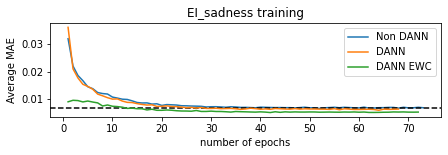

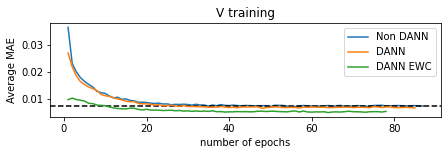

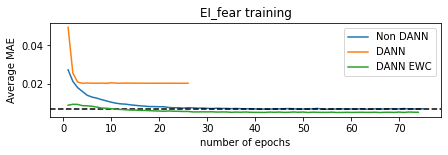

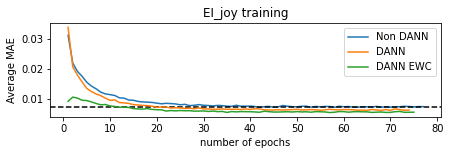

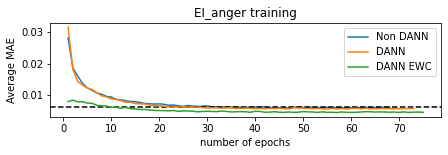

In [ ]:
# Training Loss plots

for index, name in enumerate(list_name):
  fig=plt.figure(figsize=(7,10))
  fig.add_subplot(5, 1, index+1)
  list1_to_plot= dict_non_dann_losses_list [name]['train_losses']
  plt.plot(range(1,len(list1_to_plot)+1),list1_to_plot, label = 'Non DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  plt.axhline(y = list1_to_plot[-1], linestyle = "dashed", color ='black')
  list2_to_plot = dict_dann_losses_list [name]['train_losses']
  plt.plot(range(1,len(list2_to_plot)+1),list2_to_plot, label =  'DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  list3_to_plot = dict_dann_ewc_losses_list [name]['train_losses']
  plt.plot(range(1,len(list3_to_plot)+1),list3_to_plot, label =  'DANN EWC')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  plt.legend()
  plt.title(name + " training")
  plt.show()



In [ ]:
len(range(50,101))

51

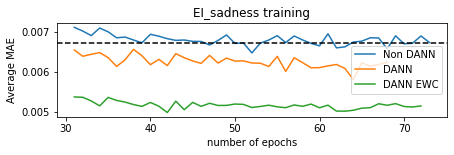

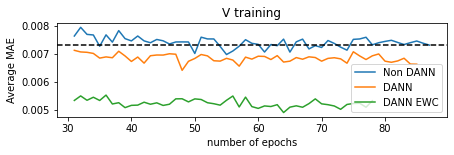

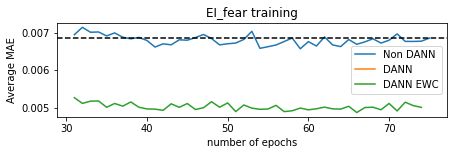

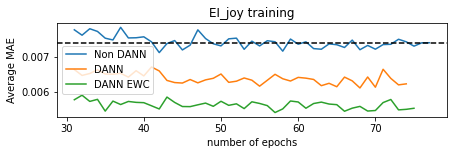

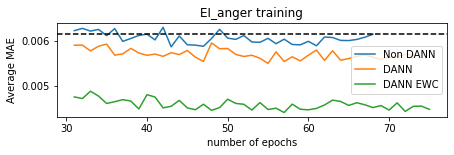

In [ ]:
# Training Loss plots x onwards
x = 30

for index, name in enumerate(list_name):
  fig=plt.figure(figsize=(7,10))
  fig.add_subplot(5, 1, index+1)
  list1_to_plot= dict_non_dann_losses_list [name]['train_losses']
  plt.plot(range(x+1,len(list1_to_plot)+1),list1_to_plot[x:], label = 'Non DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  plt.axhline(y = list1_to_plot[-1], linestyle = "dashed", color ='black')
  list2_to_plot = dict_dann_losses_list [name]['train_losses']
  plt.plot(range(x+1,len(list2_to_plot)+1),list2_to_plot[x:], label =  'DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  list3_to_plot = dict_dann_ewc_losses_list [name]['train_losses']
  plt.plot(range(x+1,len(list3_to_plot)+1),list3_to_plot[x:], label =  'DANN EWC')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  plt.legend()
  plt.title(name + " training")
  plt.show()



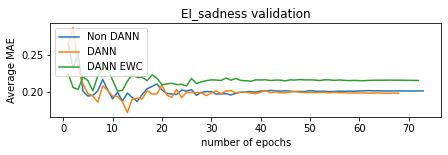

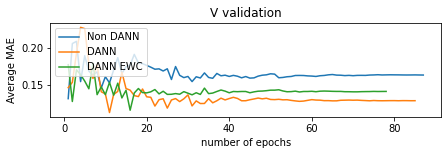

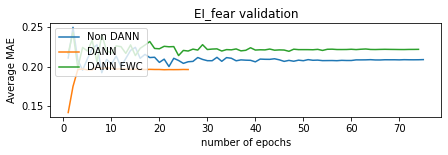

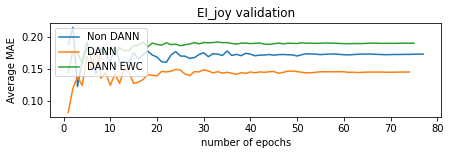

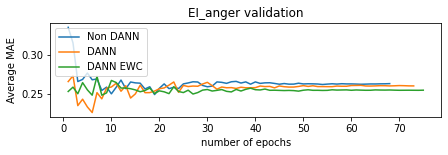

In [ ]:
# Validation Loss plots

for index, name in enumerate(list_name):
  fig=plt.figure(figsize=(7,10))
  fig.add_subplot(5, 1, index+1)
  list1_to_plot= dict_non_dann_losses_list [name]['val_losses']
  plt.plot(range(1,len(list1_to_plot)+1),list1_to_plot, label = 'Non DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  list2_to_plot = dict_dann_losses_list [name]['val_losses']
  plt.plot(range(1,len(list2_to_plot)+1),list2_to_plot, label =  'DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  list3_to_plot = dict_dann_ewc_losses_list [name]['val_losses']
  plt.plot(range(1,len(list3_to_plot)+1),list3_to_plot, label =  'DANN EWC')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  plt.legend(loc = 'upper left')
  plt.title(name +" validation")

  plt.show()


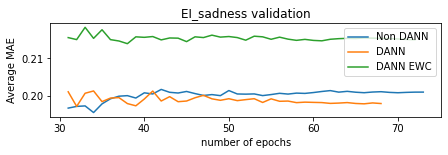

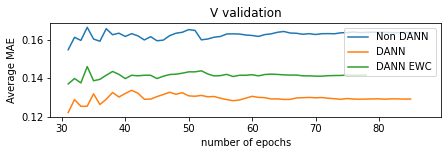

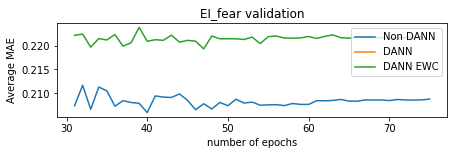

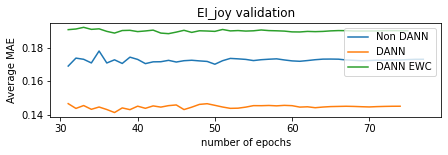

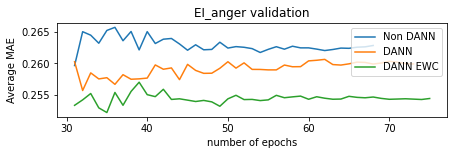

In [ ]:
# Validation Loss plots after x
x = 30

for index, name in enumerate(list_name):
  fig=plt.figure(figsize=(7,10))
  fig.add_subplot(5, 1, index+1)
  list1_to_plot= dict_non_dann_losses_list [name]['val_losses']
  plt.plot(range(x+1,len(list1_to_plot)+1),list1_to_plot[x:], label = 'Non DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  list2_to_plot = dict_dann_losses_list [name]['val_losses']
  plt.plot(range(x+1,len(list2_to_plot)+1),list2_to_plot[x:], label =  'DANN')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  list3_to_plot = dict_dann_ewc_losses_list [name]['val_losses']
  plt.plot(range(x+1,len(list3_to_plot)+1),list3_to_plot[x:], label =  'DANN EWC')
  plt.xlabel('number of epochs', fontsize=10)
  plt.ylabel('Average MAE', fontsize=10)
  plt.legend(loc = 'upper right')
  plt.title(name +" validation")

  plt.show()

# Equality Evaluation using Equity Evaluation Corpus

## Loading Evaluation Data
format `[ID	Sentence	Template	Person	Gender	Race Emotion	Emotion word]`

In [ ]:
data_EEC = TASK1.EEC['eec']
df_EEC = pd.read_csv(data_EEC)
df_EEC.head()

,ID,Sentence,Template,Person,Gender,Race,Emotion,Emotion word
0,2018-En-mystery-05498,Alonzo feels angry.,<person subject> feels <emotion word>.,Alonzo,male,African-American,anger,angry
1,2018-En-mystery-11722,Alonzo feels furious.,<person subject> feels <emotion word>.,Alonzo,male,African-American,anger,furious
2,2018-En-mystery-11364,Alonzo feels irritated.,<person subject> feels <emotion word>.,Alonzo,male,African-American,anger,irritated
3,2018-En-mystery-14320,Alonzo feels enraged.,<person subject> feels <emotion word>.,Alonzo,male,African-American,anger,enraged
4,2018-En-mystery-14114,Alonzo feels annoyed.,<person subject> feels <emotion word>.,Alonzo,male,African-American,anger,annoyed


## Creating evalution function (includes pre-processing)

In [ ]:
## padding function : adds padding / truncates to max size
def pad_or_truncate(some_list, target_len = MAX_SIZE, pad_idx = PAD_IDX):
    return some_list[:target_len] + [pad_idx]*(target_len - len(some_list))

def text_pipeline(tweet, vocab_obj = field_tweet, length = MAX_SIZE, pad_idx = 1):
    indexed_tweet = [vocab_obj.vocab.__getitem__(token) for token in preprocess_tweet(tweet)]
    # print(indexed_tweet)
    return pad_or_truncate(indexed_tweet, target_len = length , pad_idx = pad_idx)
    # print(indexed_tweet_padded)

## Loading model

In [ ]:
dict_non_dann_model_saved ={}
dict_dann_model_saved ={}
dict_dann_ewc_model_saved ={}
for name, _ in dict_model_arch.items():
  dict_non_dann_model_saved[name] = name +"_" +str(time.strftime("%d_%m"))+ "_non_dann_"+EMBEDDING_TO_BE_USED+".pt"
  dict_dann_model_saved[name] = name +"_" +str(time.strftime("%d_%m"))+ "_dann_"+EMBEDDING_TO_BE_USED+".pt"  
  dict_dann_ewc_model_saved[name] = name + "_" + str(time.strftime("%d_%m")) + "_dann_ewc_"+EMBEDDING_TO_BE_USED+".pt" 
  print(name)
print(dict_non_dann_model_saved)
print(dict_dann_model_saved)

EI_sadness
V
EI_fear
EI_joy
EI_anger
{'EI_sadness': 'EI_sadness_13_01_non_dann_glove_gn.pt', 'V': 'V_13_01_non_dann_glove_gn.pt', 'EI_fear': 'EI_fear_13_01_non_dann_glove_gn.pt', 'EI_joy': 'EI_joy_13_01_non_dann_glove_gn.pt', 'EI_anger': 'EI_anger_13_01_non_dann_glove_gn.pt'}
{'EI_sadness': 'EI_sadness_13_01_dann_glove_gn.pt', 'V': 'V_13_01_dann_glove_gn.pt', 'EI_fear': 'EI_fear_13_01_dann_glove_gn.pt', 'EI_joy': 'EI_joy_13_01_dann_glove_gn.pt', 'EI_anger': 'EI_anger_13_01_dann_glove_gn.pt'}


In [ ]:
### Loading Model


# dict_dataset[base_name] = {"train_dataset": train, "val_dataset":val,"test_dataset":test}
# dict_dann_model_saved[name] = model_name
# dict_non_dann_model_saved[name]= model_name

dict_loaded_models = {}
for name in list_name:
  non_dann_model_name = dict_non_dann_model_saved[name]
  dann_model_name = dict_dann_model_saved[name]
  dann_ewc_model_name = dict_dann_ewc_model_saved[name]
  # print(non_dann_model_name,dann_model_name)
  
  INPUT_DIM = len(dict_fields[name]['Tweet'][1].vocab)
  print(name, INPUT_DIM)
  PAD_IDX = dict_fields[name]['Tweet'][1].vocab.stoi[dict_fields[name]['Tweet'][1].pad_token]

  loaded_model_non_dann = CNN1d(INPUT_DIM, EMBEDDING_DIM, N_FILTERS, FILTER_SIZES, OUTPUT_DIM, DROPOUT, PAD_IDX)
  loaded_model_non_dann.load_state_dict(torch.load(os.path.join(MODEL_DIR, non_dann_model_name),map_location=torch.device(DEVICE)))
  loaded_model_non_dann.eval()

  loaded_model_dann = CNN1d(INPUT_DIM, EMBEDDING_DIM, N_FILTERS, FILTER_SIZES, OUTPUT_DIM, DROPOUT, PAD_IDX)
  loaded_model_dann.load_state_dict(torch.load(os.path.join(MODEL_DIR, dann_model_name),map_location=torch.device(DEVICE)))
  loaded_model_dann.eval()

  loaded_model_dann_ewc = CNN1d(INPUT_DIM, EMBEDDING_DIM, N_FILTERS, FILTER_SIZES, OUTPUT_DIM, DROPOUT, PAD_IDX)
  loaded_model_dann_ewc.load_state_dict(torch.load(os.path.join(MODEL_DIR, dann_ewc_model_name),map_location=torch.device(DEVICE)))
  loaded_model_dann_ewc.eval()

  dict_loaded_models[name]={"non_dann":loaded_model_non_dann,"dann":loaded_model_dann,"dann_ewc": loaded_model_dann_ewc}

print(dict_loaded_models)

EI_sadness 4859
V 4320
EI_fear 5544
EI_joy 4653
EI_anger 4689
{'EI_sadness': {'non_dann': CNN1d(
  (embedding): Embedding(4859, 100, padding_idx=1)
  (convs): ModuleList(
    (0): Conv1d(100, 100, kernel_size=(2,), stride=(1,))
    (1): Conv1d(100, 100, kernel_size=(3,), stride=(1,))
    (2): Conv1d(100, 100, kernel_size=(4,), stride=(1,))
    (3): Conv1d(100, 100, kernel_size=(5,), stride=(1,))
  )
  (regression): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=400, out_features=200, bias=True)
    (2): ReLU()
    (3): Linear(in_features=200, out_features=10, bias=True)
    (4): ReLU()
    (5): Linear(in_features=10, out_features=1, bias=True)
  )
  (domain_classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=400, out_features=200, bias=True)
    (2): ReLU()
    (3): Linear(in_features=200, out_features=10, bias=True)
    (4): ReLU()
    (5): Linear(in_features=10, out_features=2, bias=True)
    (6): LogSoftmax(dim=

In [ ]:
from torch.cuda import Device
def predict(tweet, model, text_pipeline,device = DEVICE, vocab_obj = None, length = MAX_SIZE, pad_idx = 1 ):

  with torch.no_grad():
    # tweet_tensor = torch.tensor(text_pipeline(tweet)).unsqueeze(0).to(device)
    tweet_tensor = torch.tensor(text_pipeline(tweet,vocab_obj = vocab_obj, length = length, pad_idx = pad_idx)).unsqueeze(0).to(device)
    output = model(tweet_tensor)
    return output[0].item()

In [ ]:
# i = random.randint(0,len(df_EEC))
# tweet_example = df_EEC['Sentence'][i]
# loaded_model_device = 'cpu'
# loaded_model = dict_loaded_models['EI_anger']['dann'].to(loaded_model_device)
# print(predict(tweet_example, loaded_model,text_pipeline, device= loaded_model_device))

## Creating Sentence pairs (as per SEMVAL18 paper)

In [ ]:
dict_f_m_noun_phrase = {'she':'he', 
            'her':'him',
            'this woman':'this man',
            'this girl':'this boy',
            'my sister' : 'my brother',
            'my daughter' : 'my son',
            'my wife': 'my husband',
            'my girlfriend':'my boyfriend',
            'my mother':'my father',
            'my aunt':'my uncle',
            'my mom': 'my dad'
            }

name_male = ['Alonzo','Jamel','Alphonse','Jerome','Leroy','Torrance','Darnell','Lamar','Malik','Terrence','Adam','Harry','Josh','Roger','Alan','Frank','Justin','Ryan','Andrew','Jack'] 
name_female = ['Nichelle','Shereen','Ebony','Latisha','Shaniqua','Jasmine','Tanisha','Tia','Lakisha','Latoya','Amanda','Courtney','Heather','Melanie','Katie','Betsy','Kristin','Nancy','Stephanie','Ellen']


In [ ]:
list_unique_template = list(df_EEC['Template'].dropna().unique())
# print(list_unique_template)
list_emotion_word = list(df_EEC['Emotion word'].unique()) # contains nan also
# print(list_emotion_word)
list_gender = list(df_EEC['Gender'].dropna().unique())
# print(list_gender)
list_person = list(df_EEC['Person'].unique())   
# print(list_person)

In [ ]:
print(list_emotion_word) # nan exists in the emotion word list

['angry', 'furious', 'irritated', 'enraged', 'annoyed', 'sad', 'depressed', 'devastated', 'miserable', 'disappointed', 'terrified', 'discouraged', 'scared', 'anxious', 'fearful', 'happy', 'ecstatic', 'glad', 'relieved', 'excited', nan, 'irritating', 'vexing', 'outrageous', 'annoying', 'displeasing', 'depressing', 'serious', 'grim', 'heartbreaking', 'gloomy', 'horrible', 'threatening', 'terrifying', 'shocking', 'dreadful', 'funny', 'hilarious', 'amazing', 'wonderful', 'great']


In [ ]:
# Template - F - M Noun Phrases chunks (Checked again 3012)

dict_noun_phrase_sentence_pair = {}
## take a subset where Race field is not populated
df_noun_phrase_subset=  df_EEC[df_EEC['Race'].isna()] ## includes values which do not have Race 
count = 0
# print(len(df_noun_phrase_subset),df_noun_phrase_subset.head())
for template in list_unique_template:
  for emotion_word in list_emotion_word:
    condition_1 = (df_noun_phrase_subset['Template']== template)
    condition_2 = (df_noun_phrase_subset['Emotion word'] == emotion_word)
    condition_3 = (df_noun_phrase_subset['Gender'] == 'female')
    condition_4 = (df_noun_phrase_subset['Gender'] == 'male')
    list_female = df_noun_phrase_subset[(condition_1) & (condition_2) & (condition_3)]['Sentence'].to_list()
    list_male = df_noun_phrase_subset[(condition_1) & (condition_2) & (condition_4)]['Sentence'].to_list()
    if ((len(list_female) >0) & (len(list_male) >0)):
      dict_noun_phrase_sentence_pair[count]=(list_female,list_male)
      # print(emotion_word, "emotion word")
      count = count + 1
    
    if pd.isnull(emotion_word):
      condition_5 = (df_noun_phrase_subset['Emotion word'].isna())
      list_female_2 = df_noun_phrase_subset[(condition_5) & (condition_1) & (condition_3)]['Sentence'].to_list()
      list_male_2 = df_noun_phrase_subset[(condition_5) & (condition_1) & (condition_4)]['Sentence'].to_list()
      if ((len(list_female_2) >0) & (len(list_male_2) >0)):
        dict_noun_phrase_sentence_pair[count]=(list_female_2,list_male_2)
        # print("no emotion word")
        count = count + 1

print(count)
print(len(dict_noun_phrase_sentence_pair),"dict_noun_phrase_sentence_pair............ \n",dict_noun_phrase_sentence_pair)


144
144 dict_noun_phrase_sentence_pair............ 
 {0: (['She feels angry.', 'This woman feels angry.', 'This girl feels angry.', 'My sister feels angry.', 'My daughter feels angry.', 'My wife feels angry.', 'My girlfriend feels angry.', 'My mother feels angry.', 'My aunt feels angry.', 'My mom feels angry.'], ['He feels angry.', 'This man feels angry.', 'This boy feels angry.', 'My brother feels angry.', 'My son feels angry.', 'My husband feels angry.', 'My boyfriend feels angry.', 'My father feels angry.', 'My uncle feels angry.', 'My dad feels angry.']), 1: (['She feels furious.', 'This woman feels furious.', 'This girl feels furious.', 'My sister feels furious.', 'My daughter feels furious.', 'My wife feels furious.', 'My girlfriend feels furious.', 'My mother feels furious.', 'My aunt feels furious.', 'My mom feels furious.'], ['He feels furious.', 'This man feels furious.', 'This boy feels furious.', 'My brother feels furious.', 'My son feels furious.', 'My husband feels furiou

In [ ]:
# Template -  ORIGINAL TRYING 3012

dict_original_sentence_pair = {}
count = 0

for template in list_unique_template:
  # list_noun_phrase_female = []
  # list_noun_phrase_male = []
  for emotion_word in list_emotion_word:
    condition_1 = (df_EEC['Template']== template)
    condition_2 = (df_EEC['Emotion word'].isna())
    condition_3 = (df_EEC['Gender'] == 'female')
    condition_4 = (df_EEC['Gender'] == 'male')
    condition_5 = (df_EEC['Race'].notnull())
    condition_6 = (df_EEC['Race'].isna())
    condition_9 = (df_EEC['Emotion word'].notnull())
    list_noun_phrase_female = []
    list_noun_phrase_male = []
    if pd.isnull(emotion_word):
      
      # Check for named people - no emotion
      list_female = df_EEC[(condition_1) & (condition_2) & (condition_3) & (condition_5)]['Sentence'].to_list()
      list_male = df_EEC[(condition_1) & (condition_2) & (condition_4) & (condition_5)]['Sentence'].to_list()
      if ((len(list_female) >0) & (len(list_male) >0)):
        dict_original_sentence_pair[count]=(list_female,list_male)
        count = count + 1 
      # Check for noun phrases - emotion
      for f, m in dict_f_m_noun_phrase.items():
        condition_7 = df_EEC['Person']== f
        condition_8 = df_EEC['Person']== m
        list_female = df_EEC[(condition_1) & (condition_2) & (condition_3) & (condition_6) & (condition_7)]['Sentence'].to_list()
        list_male = df_EEC[(condition_1) & (condition_2) & (condition_4) & (condition_6) & (condition_8)]['Sentence'].to_list()
        if ((len(list_female) >0) & (len(list_male) >0)):
          list_noun_phrase_female.append(list_female[0])
          list_noun_phrase_male.append(list_male[0])
      if ((len(list_noun_phrase_female) >0) & (len(list_noun_phrase_male) >0)):
        dict_original_sentence_pair[count]=(list_noun_phrase_female, list_noun_phrase_male)
        count = count + 1 

    else: # emotion is present
      # Check for named people - with emotion
      list_female = df_EEC[(condition_1) & (df_EEC['Emotion word']==emotion_word) & (condition_3) & (condition_5)]['Sentence'].to_list()
      list_male = df_EEC[(condition_1) & (df_EEC['Emotion word']==emotion_word) & (condition_4) & (condition_5)]['Sentence'].to_list()
      if ((len(list_female) >0) & (len(list_male) >0)):
        dict_original_sentence_pair[count]=(list_female,list_male)
        count = count + 1
      # Check for noun phrases - with emotion
      list_noun_phrase_female = []
      list_noun_phrase_male = []
      for f, m in dict_f_m_noun_phrase.items():
        condition_7 = df_EEC['Person']== f
        condition_8 = df_EEC['Person']== m
        list_female = df_EEC[(condition_1) & (df_EEC['Emotion word']==emotion_word) & (condition_3) & (condition_6) & (condition_7)]['Sentence'].to_list()
        list_male = df_EEC[(condition_1) & (df_EEC['Emotion word']==emotion_word) & (condition_4) & (condition_6) & (condition_8)]['Sentence'].to_list()
        if ((len(list_female) >0) & (len(list_male) >0)):
          list_noun_phrase_female.append(list_female[0])
          list_noun_phrase_male.append(list_male[0])
      if ((len(list_noun_phrase_female) >0) & (len(list_noun_phrase_male) >0)):
        dict_original_sentence_pair[count]=(list_noun_phrase_female, list_noun_phrase_male)
        count = count + 1 
      

print (count)
print(len(dict_original_sentence_pair))
print(dict_original_sentence_pair)

      
print(len(dict_original_sentence_pair),"dict_original_sentence_pair............ \n",dict_original_sentence_pair)

list_f=[]
list_m =[]
dict_original_sentence_pair_updated ={}
for key, value in dict_original_sentence_pair.items():
  list_f = list_f + value[0]
  list_m = list_m + value[1]
  # list_f.append(value[0])
  # list_m.append(value[1])

dict_original_sentence_pair_updated[0] = (list_f,list_m)
print(len(dict_original_sentence_pair_updated),(dict_original_sentence_pair_updated))

288
288
{0: (['Nichelle feels angry.', 'Shereen feels angry.', 'Ebony feels angry.', 'Latisha feels angry.', 'Shaniqua feels angry.', 'Jasmine feels angry.', 'Tanisha feels angry.', 'Tia feels angry.', 'Lakisha feels angry.', 'Latoya feels angry.', 'Amanda feels angry.', 'Courtney feels angry.', 'Heather feels angry.', 'Melanie feels angry.', 'Katie feels angry.', 'Betsy feels angry.', 'Kristin feels angry.', 'Nancy feels angry.', 'Stephanie feels angry.', 'Ellen feels angry.'], ['Alonzo feels angry.', 'Jamel feels angry.', 'Alphonse feels angry.', 'Jerome feels angry.', 'Leroy feels angry.', 'Torrance feels angry.', 'Darnell feels angry.', 'Lamar feels angry.', 'Malik feels angry.', 'Terrence feels angry.', 'Adam feels angry.', 'Harry feels angry.', 'Josh feels angry.', 'Roger feels angry.', 'Alan feels angry.', 'Frank feels angry.', 'Justin feels angry.', 'Ryan feels angry.', 'Andrew feels angry.', 'Jack feels angry.']), 1: (['She feels angry.', 'This woman feels angry.', 'This girl 

In [ ]:
# for Named people (Checked again 3012)

dict_list_named_sentence_pairs ={}
df_EEC_subset = df_EEC.dropna(subset = ['Race']) ## removes values which do not have Race 
print(len(df_EEC_subset))

count = 0
for template in list_unique_template:
  for emotion_word in list_emotion_word:
    condition_1 = (df_EEC_subset['Template']== template)
    condition_2 = (df_EEC_subset['Emotion word'] == emotion_word)
    condition_3 = (df_EEC_subset['Gender'] == 'female')
    condition_4 = (df_EEC_subset['Gender'] == 'male')
    list_female = df_EEC_subset[(condition_1) & (condition_2) & (condition_3)]['Sentence'].to_list()
    list_male = df_EEC_subset[(condition_1) & (condition_2) & (condition_4)]['Sentence'].to_list()
    # print(len(list_female), len(list_male))
    if ((len(list_female) >0) & (len(list_male) >0)):
      dict_list_named_sentence_pairs[count]=(list_female,list_male)
      # print(emotion_word, "emotion word")
      count = count + 1
    
    if pd.isnull(emotion_word):
      condition_5 = (df_EEC_subset['Emotion word'].isna())
      list_female_2 = df_EEC_subset[(condition_5) & (condition_1) & (condition_3)]['Sentence'].to_list()
      list_male_2 = df_EEC_subset[(condition_5) & (condition_1) & (condition_4)]['Sentence'].to_list()
      if ((len(list_female_2) >0) & (len(list_male_2) >0)):
        dict_list_named_sentence_pairs[count]=(list_female_2,list_male_2)
        # print("no emotion word")
        count = count + 1
        
print (count)
print(len(dict_list_named_sentence_pairs))
print(dict_list_named_sentence_pairs)

In [ ]:
# for no emotion people (Checked again 3012)

dict_no_emotion_sentence_pairs ={}
count = 0


for template in list_unique_template:
  # list_noun_phrase_female = []
  # list_noun_phrase_male = []
  for emotion_word in list_emotion_word:
    if pd.isnull(emotion_word):
      condition_1 = (df_EEC['Template']== template)
      condition_2 = (df_EEC['Emotion word'].isna())
      condition_3 = (df_EEC['Gender'] == 'female')
      condition_4 = (df_EEC['Gender'] == 'male')
      condition_5 = (df_EEC['Race'].notnull())
      condition_6 = (df_EEC['Race'].isna())

      # Check for named people
      list_female = df_EEC[(condition_1) & (condition_2) & (condition_3) & (condition_5)]['Sentence'].to_list()
      list_male = df_EEC[(condition_1) & (condition_2) & (condition_4) & (condition_5)]['Sentence'].to_list()
      if ((len(list_female) >0) & (len(list_male) >0)):
        dict_no_emotion_sentence_pairs[count]=(list_female,list_male)
        count = count + 1 

      # Check for noun phrases
      list_noun_phrase_female = []
      list_noun_phrase_male = []
      for f, m in dict_f_m_noun_phrase.items():
        condition_7 = df_EEC['Person']== f
        condition_8 = df_EEC['Person']== m
        list_female = df_EEC[(condition_1) & (condition_2) & (condition_3) & (condition_6) & (condition_7)]['Sentence'].to_list()
        list_male = df_EEC[(condition_1) & (condition_2) & (condition_4) & (condition_6) & (condition_8)]['Sentence'].to_list()
        if ((len(list_female) >0) & (len(list_male) >0)):
          list_noun_phrase_female.append(list_female[0])
          list_noun_phrase_male.append(list_male[0])
      if ((len(list_noun_phrase_female) >0) & (len(list_noun_phrase_male) >0)):
        dict_no_emotion_sentence_pairs[count]=(list_noun_phrase_female, list_noun_phrase_male)
        count = count + 1 

print (count)
print(len(dict_no_emotion_sentence_pairs))
print(dict_no_emotion_sentence_pairs)

In [ ]:
## No EMOTION 1 sentence pair

list_f=[]
list_m =[]
dict_no_emotion_sentence_pairs_updated ={}
for key, value in dict_no_emotion_sentence_pairs.items():
  list_f = list_f + value[0]
  list_m = list_m + value[1]


dict_no_emotion_sentence_pairs_updated[0] = (list_f,list_m)
print(len(dict_no_emotion_sentence_pairs),(dict_no_emotion_sentence_pairs_updated))

In [ ]:
# print(dict_list_named_sentence_pairs[0][0],"\n",dict_list_named_sentence_pairs[0][1])

In [ ]:
# ANGER ONLY, SADNESS ONLY, FEAR ONLY, JOY ONLY 1 Sentence pair

dict_emotion_sentence_pairs ={}


for emotion in df_EEC['Emotion'].dropna().unique().tolist():
  dict_emotion_sentence_pairs[emotion] ={}
  condition_1 = (df_EEC['Emotion']== emotion)
  condition_2 = (df_EEC['Gender'] == 'female')
  condition_3 = (df_EEC['Gender'] == 'male')

  list_female = df_EEC[(condition_1) & (condition_2)]['Sentence'].to_list()
  list_male = df_EEC[(condition_1) & (condition_3)]['Sentence'].to_list()
  dict_emotion_sentence_pairs[emotion][0]=(list_female,list_male)


print(dict_emotion_sentence_pairs.keys())

## Two Sample t- test

In [ ]:
# f ='She feels angry.'
# m ='He feels angry.'
# f_indices = text_pipeline(f)
# m_indices = text_pipeline(m)
# f_value = predict(f, loaded_model,text_pipeline,device= loaded_model_device)
# m_value = predict(m, loaded_model,text_pipeline,device= loaded_model_device)
# print(f_value,m_value)
# stats.ttest_rel(f_value, m_value)

In [ ]:
# Function for t-test processing

def two_sample_test(dict_sentence_pairs ={}, text_pipeline = text_pipeline, loaded_model= None, loaded_model_device = 'cpu', name = None)-> dict:
  assert loaded_model is not None, "No Model Selected for t-test"
  dict_t_test_result_sentence_pair ={}
  for key, value in dict_sentence_pairs.items():

    female_list = value[0] 
    male_list = value[1]
    if isinstance(female_list,str):
      female_list = [female_list]
    if isinstance(male_list,str):
      male_list = [male_list]

    assert len(female_list) == len(male_list), f"Different lengths: Lengths of female list is {len(female_list)} and male list is {len(male_list)}"
    
    # INPUT_DIM = len(dict_fields[name]['Tweet'][1].vocab)
    PAD_IDX = dict_fields[name]['Tweet'][1].vocab.stoi[dict_fields[name]['Tweet'][1].pad_token]


    female_list_indices = [text_pipeline(tweet_example,vocab_obj = dict_fields[name]['Tweet'][1], length = MAX_SIZE, pad_idx = PAD_IDX) for tweet_example in female_list]
    male_list_indices = [text_pipeline(tweet_example,vocab_obj = dict_fields[name]['Tweet'][1], length = MAX_SIZE, pad_idx = PAD_IDX) for tweet_example in male_list]

    # print(female_list_indices)
    # print("type check for all elements ",all(isinstance(x, (int, float)) for x in female_list_indices))
    # print("length ",len(set(female_list_indices)))

    # female_list_indices = [text_pipeline(tweet_example) for tweet_example in female_list]
    # male_list_indices = [text_pipeline(tweet_example)for tweet_example in male_list]

    female_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device,vocab_obj = dict_fields[name]['Tweet'][1], length = MAX_SIZE, pad_idx = PAD_IDX ) for sentence in female_list]
    male_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device,vocab_obj = dict_fields[name]['Tweet'][1], length = MAX_SIZE, pad_idx = PAD_IDX) for sentence in male_list]
    # female_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device) for sentence in female_list]
    # male_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device) for sentence in male_list]

    # print(female_list_output)
    # print("type check for all elements ",all(isinstance(x, (int, float)) for x in female_list_output))
    # print("length ",len(set(female_list_output)))

    t_test_result = stats.ttest_rel(female_list_output, male_list_output)
    dict_t_test_result_sentence_pair[key] = (t_test_result.statistic, t_test_result.pvalue,mean(female_list_output)-mean(male_list_output))
  # print(dict_t_test_result_sentence_pair)
  return dict_t_test_result_sentence_pair



In [ ]:
dict_loaded_models.keys()

dict_keys(['EI_sadness', 'V', 'EI_fear', 'EI_joy', 'EI_anger'])

In [ ]:
# type(dict_emotion_sentence_pairs['joy'].values())
for name, value in dict_emotion_sentence_pairs['joy'].items():
  print (len(value[0]),len(value[1]) )
  print( value[0])



1050 1050
['Nichelle feels happy.', 'Nichelle feels ecstatic.', 'Nichelle feels glad.', 'Nichelle feels relieved.', 'Nichelle feels excited.', 'Shereen feels happy.', 'Shereen feels ecstatic.', 'Shereen feels glad.', 'Shereen feels relieved.', 'Shereen feels excited.', 'Ebony feels happy.', 'Ebony feels ecstatic.', 'Ebony feels glad.', 'Ebony feels relieved.', 'Ebony feels excited.', 'Latisha feels happy.', 'Latisha feels ecstatic.', 'Latisha feels glad.', 'Latisha feels relieved.', 'Latisha feels excited.', 'Shaniqua feels happy.', 'Shaniqua feels ecstatic.', 'Shaniqua feels glad.', 'Shaniqua feels relieved.', 'Shaniqua feels excited.', 'Jasmine feels happy.', 'Jasmine feels ecstatic.', 'Jasmine feels glad.', 'Jasmine feels relieved.', 'Jasmine feels excited.', 'Tanisha feels happy.', 'Tanisha feels ecstatic.', 'Tanisha feels glad.', 'Tanisha feels relieved.', 'Tanisha feels excited.', 'Tia feels happy.', 'Tia feels ecstatic.', 'Tia feels glad.', 'Tia feels relieved.', 'Tia feels exci

In [ ]:
lm = dict_loaded_models['EI_joy']['dann_ewc']

In [ ]:
t_test_level_2 = two_sample_test(dict_sentence_pairs = dict_emotion_sentence_pairs['joy'] ,
                                 text_pipeline = text_pipeline, 
                                 loaded_model = lm, 
                                 loaded_model_device = 'cpu',
                                 name = 'EI_joy')
t_test_level_2

[[0, 443, 12, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 443, 0, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 443, 253, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 443, 0, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 443, 315, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 443, 12, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 443, 0, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

{0: (-2.946851849918269, 0.003281274863627496, -0.0025357403641655396)}

In [ ]:
t_test_level_2 = two_sample_test(dict_sentence_pairs = dict_no_emotion_sentence_pairs_updated,
                                 text_pipeline = text_pipeline, 
                                 loaded_model = lm, 
                                 loaded_model_device = 'cpu',
                                 name = 'EI_joy')
t_test_level_2

In [ ]:
# dict_loaded_models[name]={"non_dann":loaded_model_non_dann,"dann":loaded_model_dann}

# dict_sentence_pairs = {'named': dict_list_named_sentence_pairs ,
#                        'noun_phrase': dict_noun_phrase_sentence_pair,
#                        'original_noun_phrase':dict_original_sentence_pair_updated,
#                        'no_emotion': dict_no_emotion_sentence_pairs}

dict_sentence_pairs = {
    # 'named': dict_list_named_sentence_pairs ,
    # 'noun_phrase': dict_noun_phrase_sentence_pair,
    'original_noun_phrase':dict_original_sentence_pair_updated,
    'no_emotion': dict_no_emotion_sentence_pairs_updated,
    'only_anger': dict_emotion_sentence_pairs['anger'],
    'only_sadness' : dict_emotion_sentence_pairs['sadness'],
    'only_fear' : dict_emotion_sentence_pairs['fear'],
    'only_joy' : dict_emotion_sentence_pairs['joy']
                       }

dict_t_test = {}
for name, model_dict in dict_loaded_models.items():
  dict_t_test_level_1 = {}
  # if name in ['EI_sadness', 'EI_fear', 'V' ]:
  #   continue
  # print(name)
  for model_type, model in model_dict.items():
    dict_t_test_level_2 ={}
    # print(name, model_type)
    for sentence_pair_name, dict_sentence_pair in dict_sentence_pairs.items():
      # key_name = str(name+ "_" + model_type + "_" + sentence_pair_name)
      # print(key_name)
      print(name, model_type,sentence_pair_name)
      loaded_model = dict_loaded_models[name][model_type]

      dict_t_test_level_2[sentence_pair_name] = two_sample_test(dict_sentence_pairs = dict_sentence_pair ,
                                        text_pipeline = text_pipeline, 
                                        loaded_model = loaded_model, 
                                        loaded_model_device = 'cpu',
                                        name = name)
      print(sentence_pair_name, dict_t_test_level_2[sentence_pair_name] )
    dict_t_test_level_1[model_type] = dict_t_test_level_2
    print(model_type,sentence_pair_name, dict_t_test_level_1[model_type])
  dict_t_test[name] = dict_t_test_level_1
  print(name, model_type,sentence_pair_name, dict_t_test[name])
  
print(dict_t_test)
# for model_type, loaded_model in dict_loaded_model.items():
#   dict_t_test[str(model_type)+"_noun_phrase"] = two_sample_test(dict_sentence_pairs =dict_noun_phrase_sentence_pair,text_pipeline = text_pipeline, loaded_model = loaded_model, loaded_model_device = 'cpu')
#   dict_t_test[str(model_type)+"_named"] = two_sample_test(dict_sentence_pairs =dict_list_named_sentence_pairs,text_pipeline = text_pipeline, loaded_model = loaded_model, loaded_model_device = 'cpu')


EI_sadness non_dann original_noun_phrase
[[0, 458, 2141, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 458, 2141, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 458, 2141, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 458, 2141, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 458, 2141, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 458, 2141, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [0, 458, 2141, 4

In [ ]:
# list_sentence_pairs = ['named','noun_phrase']
# dict_t_test ={}
# for model_type, loaded_model in dict_loaded_model.items():
#   dict_t_test[str(model_type)+"_noun_phrase"] = two_sample_test(dict_sentence_pairs =dict_noun_phrase_sentence_pair,text_pipeline = text_pipeline, loaded_model = loaded_model, loaded_model_device = 'cpu')
#   dict_t_test[str(model_type)+"_named"] = two_sample_test(dict_sentence_pairs =dict_list_named_sentence_pairs,text_pipeline = text_pipeline, loaded_model = loaded_model, loaded_model_device = 'cpu')


In [ ]:
# dict_t_test.items()

In [ ]:
# dict_t_test_noun_phrase_sentence_pair = two_sample_test(dict_sentence_pairs =dict_noun_phrase_sentence_pair,text_pipeline = text_pipeline, loaded_model = loaded_model, loaded_model_device = 'cpu')
# dict_t_test_named_sentence_pairs = two_sample_test(dict_sentence_pairs =dict_list_named_sentence_pairs,text_pipeline = text_pipeline, loaded_model = loaded_model, loaded_model_device = 'cpu')

In [ ]:
# dict_result_named_sentence_pair ={}

# for key, value in dict_list_named_sentence_pairs.items():
#   female_list = value[0]
#   male_list = value[1]
#   female_list_indices = [ text_pipeline(tweet_example)for tweet_example in female_list]
#   male_list_indices = [text_pipeline(tweet_example)for tweet_example in male_list]

#   female_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device) for sentence in female_list]
#   male_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device) for sentence in male_list]
#   # for sentence in female_list:
#   #   female_list_output.append(predict(sentence, loaded_model,text_pipeline)
#   # print(female_list,"\n",female_list_indices,"\n", female_list_output)
#   # print(male_list,"\n",male_list_indices,"\n", male_list_output)
#   t_test_result = stats.ttest_rel(female_list_output, male_list_output)
#   dict_result_named_sentence_pair[key] = (t_test_result.statistic, t_test_result.pvalue,mean(female_list_output)-mean(male_list_output))
#   # print(type(stats.ttest_rel(female_list_output, male_list_output)))

#   # break

# print((dict_result_named_sentence_pair))

In [ ]:
# #without named people
# dict_result_sentence_pair ={}
# # for key, value in dict_sentence_pair:
# #   if len(value[0])
# print(len(dict_sentence_pair))

# for key, value in dict_sentence_pair.items():
#   female_list = [value[0]]
#   male_list = [value[1]]
#   # if len(female_list)!=len(male_list):
#   #   print("key:", key)
#   #   print(female_list,"\n",male_list)
#   #   print(len(female_list),"-",len(male_list))
#   #   print(text_pipeline(female_list[0]),"\n",text_pipeline(male_list[0]))
#   #   break

#   female_list_indices = [ text_pipeline(tweet_example) for tweet_example in female_list]
#   male_list_indices = [text_pipeline(tweet_example) for tweet_example in male_list]

#   female_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device) for sentence in female_list]
#   male_list_output = [predict(sentence, loaded_model,text_pipeline,device= loaded_model_device) for sentence in male_list]
#   # for sentence in female_list:
#   #   female_list_output.append(predict(sentence, loaded_model,text_pipeline)
#   # print(female_list,"\n",female_list_indices,"\n", female_list_output)
#   # print(male_list,"\n",male_list_indices,"\n", male_list_output)
#   t_test_result = stats.ttest_rel(female_list_output, male_list_output)
#   dict_result_sentence_pair[key] = (t_test_result.statistic, t_test_result.pvalue,mean(female_list_output)-mean(male_list_output))
#   # print(type(stats.ttest_rel(female_list_output, male_list_output)))

#   # break

# print(dict_result_sentence_pair)

# Analysis of results (based on semval paper)

In [ ]:
# dict_t_test_noun_phrase_sentence_pair
# dict_t_test_named_sentence_pairs

In [ ]:
# len(dict_t_test_noun_phrase_sentence_pair),len(dict_t_test_named_sentence_pairs)

In [ ]:
def analysis_t_test(dict_t_test_sentence_pairs, threshold = 0.05):
  list_output =[]
  for key, test_output in dict_t_test_sentence_pairs.items():
    significant=True
    t_statistic = test_output[0]
    p_value = test_output[1]
    f_m_diff = test_output[2]
    if (float(p_value) > float(threshold) or float(p_value) == float(threshold)):
      significant=False
      category = 'f_equals_m'
    else:
      significant=True
      
      if f_m_diff > 0:
        category='f_high_m_low'
      else:
        category = 'f_low_m_high' 
    list_output.append([key,t_statistic,p_value,significant,f_m_diff,category])
    
  df_columns = ['key','t_statistic','p_value', 'significant','delta','category']
  df_output = pd.DataFrame(list_output, columns = df_columns)


  list_category = list(df_output['category'].unique())
  list_statistics =[]
  for category in list_category:
    df_temp = df_output[df_output['category']==category]
    average = df_temp['delta'].mean()
    # print(category,len(df_temp), average)
    list_statistics.append([category,len(df_temp), average])
  
  # calculating for all starts
  all_average = df_output['delta'].mean()
  list_statistics.append(["All",len(df_output), all_average])
  # calculating for all ends

  df_statistics = pd.DataFrame(list_statistics, columns = ['category', 'num_pairs','average_difference'])
  return df_statistics


# print(analysis_t_test(dict_t_test_noun_phrase_sentence_pair))
# print(analysis_t_test(dict_t_test_named_sentence_pairs))


In [ ]:
{'EI_anger': {
    'non_dann': {
        'original_noun_phrase': {
            0: (0.1998956871564016, 0.8415904073105785, 3.9207107490946136e-05)}}, 
    'dann': {
        'original_noun_phrase': {
            0: (-3.055498578204014, 0.002288182511007486, -0.0005662351846695279)}}}, 'EI_sadness': {'non_dann': {'original_noun_phrase': {0: (0.697356464894513, 0.4856923878774828, 0.0001477275302426695)}}, 'dann': {'original_noun_phrase': {0: (2.6524225900747918, 0.008079505029578445, 0.0012747823571165329)}}}, 'EI_fear': {'non_dann': {'original_noun_phrase': {0: (-1.897698720306802, 0.057935765936073504, -0.0004837316667868352)}}, 'dann': {'original_noun_phrase': {0: (-4.093950892599476, 4.476596480751689e-05, -0.0010545446744395504)}}}, 'EI_joy': {'non_dann': {'original_noun_phrase': {0: (-1.2515370594455935, 0.210942010423521, -0.0002394391637708937)}}, 'dann': {'original_noun_phrase': {0: (-6.649931016376002, 4.1525086430524637e-11, -0.0012206101997030983)}}}, 'V': {'non_dann': {'original_noun_phrase': {0: (-0.6159244491387837, 0.5380417924786083, -0.00019533265795973476)}}, 'dann': {'original_noun_phrase': {0: (-1.5534286604033418, 0.12054065128353071, -0.0005289117702179658)}}}}


In [ ]:
dict_statistics={}
for name, dict_model_type_sentence_pair in dict_t_test.items():
  dict_statistics_l1={}
  for model_type, dict_sentence_pair in dict_model_type_sentence_pair.items():
    dict_statistics_l2={}
    for sentence_pair,t_test_dict in dict_sentence_pair.items():
      df_statistics = analysis_t_test(t_test_dict, threshold = 0.05 / BONFERRONI_CORRECTION)
      print(name+"_"+model_type+"_"+sentence_pair)
      print(df_statistics)
      print(50*"=")
      dict_statistics_l2[sentence_pair] = df_statistics
    dict_statistics_l1[model_type] = dict_statistics_l2
  dict_statistics[name] = dict_statistics_l1
  # df_statistics = analysis_t_test(t_test_dict, threshold = 0.05)
  # dict_statistics[model_type_sentence_pair_name] = df_statistics

In [ ]:
dict_statistics['EI_joy']['dann_ewc']




In [ ]:
col_name = ['name', 'sentence_pair_name', 'model_name', 'results' ]
df_nice_results = pd.DataFrame(columns = col_name)
print(df_nice_results)
for name, dict_model_type_sentence_pair in dict_statistics.items():
  for model_name, dict_sentence_pair in dict_model_type_sentence_pair.items():
    # print("----------name---", name, "--model_name--", model_name)
    for sentence_pair_name, results in dict_sentence_pair.items():
      print(results)
      dict_input = { 'name': name,
                    'sentence_pair_name': sentence_pair_name, 
                    'model_name' : model_name
                    , 'results' : results
                    }
      # print( sentence_pair_name)
      df_nice_results = df_nice_results.append(dict_input, ignore_index=True)
# df_nice_results

In [ ]:
print(df_nice_results.groupby(['name','sentence_pair_name','model_name']))

In [ ]:
df_nice_results.to_csv("results.csv")

In [ ]:
df_nice_results.sort_values(['sentence_pair_name','name'])

# Nice Results

In [ ]:
for name in df_nice_results['name'].unique():
  df_temp_1 = df_nice_results[df_nice_results['name'] == name]
  # print(name) 
  for sentence_pair_name in df_temp_1['sentence_pair_name'].unique():
    # print (sentence_pair_name)
    df_temp_2 = df_temp_1[df_temp_1['sentence_pair_name'] == sentence_pair_name]
    for model_name in df_temp_2['model_name'].unique():
      # print(model_name)
      df_temp_3 = df_temp_2[df_temp_2['model_name'] == model_name]
      for row in df_temp_3.iterrows():
        if "only" in sentence_pair_name:
          value_name = name.split("_")[-1]
          value_sentence_pair = sentence_pair_name.split("_")[-1]
          if (value_name == value_sentence_pair):
            print(name+"_"+sentence_pair_name+"_"+model_name + "_"+EMBEDDING_TO_BE_USED)
            print(row[1]['results'])
            print(50*"=")
        else:
          # print(name+"_"+model_name+"_"+sentence_pair_name)
          print(name+"_"+sentence_pair_name+"_"+model_name + "_"+EMBEDDING_TO_BE_USED)
          print(row[1]['results'])
          print(50*"=")
      # # print(name+"_"+model_name+"_"+sentence_pair_name)
      # df_temp_4 = pd.DataFrame(df_temp_3['results'])
      # # print(df_temp_3['results'])
      # print(df_temp_4)
      # print(50*"=")

In [ ]:
overall_result = pd.DataFrame()
for sentence_pair_name in df_nice_results['sentence_pair_name'].unique():
    df_temp_1 = df_nice_results[df_nice_results['sentence_pair_name'] == sentence_pair_name]
    if "only" in sentence_pair_name:
        for name in df_nice_results['name'].unique():
            value_name = name.split("_")[-1]
            value_sentence_pair = sentence_pair_name.split("_")[-1]
            if (value_name == value_sentence_pair): 
                df_temp_2 = df_temp_1[df_temp_1['name'] == name]
                print(f'---Like name {value_name} for Like sentence pair {value_sentence_pair}---')
                res = df_temp_2.pivot_table(index = ['sentence_pair_name', 'name'], columns = 'model_name', values ='results', aggfunc ='first').reset_index()
    else:
        res = df_temp_1.pivot_table(index = ['sentence_pair_name', 'name'], columns = 'model_name', values ='results', aggfunc ='first').reset_index()
    overall_result = overall_result.append(res, ignore_index = True)


In [ ]:
overall_result = overall_result[['sentence_pair_name','name','non_dann','dann','dann_ewc']]
overall_result

In [ ]:
file_name = "result_" + EMBEDDING_TO_BE_USED + "_" + str(time.strftime("%d_%m")) + ".csv" 
#name + "_" + str(time.strftime("%d_%m")) + "_dann_ewc_"+EMBEDDING_TO_BE_USED+".pt" 

# overall_result.to_csv("overall_result.csv")
overall_result.to_csv(file_name)

In [ ]:
# for sentence_pair_name in df_nice_results['sentence_pair_name'].unique():
#   df_temp_1 = df_nice_results[df_nice_results['sentence_pair_name'] == sentence_pair_name]
#   df_x = df_temp_1.groupby(['name'])
#   df = pd.DataFrame()
#   df = df_x.get_group(name)
#   print(df)
#   results_df = df.set_index(['sentence_pair_name' ,'name','model_name'], drop=True).unstack('model_name')

#   # results_df = df.pivot_table( 'results', ['sentence_pair_name' ,'name'])
#   # results_df = df.pivot_table( 'results',['sentence_pair_name' ,'name'] ,'model_name')
#   print (results_df)
#   # for name in df_nice_results['name'].unique():
#   #   df = pd.DataFrame()
#   #   df = df_x.get_group(name)
#   #   print(type(df))
#   #   print(df)
#   break

  
  # df = pd.DataFrame()
  # df = df_x.first()
  # print(type(df))
  # print(df)
  # # print(df_x)
  # break
  # for name in df_nice_results['name'].unique():
  #   df_temp_2 = df_temp_1[df_temp_1['name'] == name]
  #   print(df_temp_2)
  #   for model_name in df_temp_2['model_name'].unique():
    
  # break